In [1]:
# tinh toan so hoc
import math
import pandas as pd
import numpy as np
# io
import os
# truc quan
import matplotlib.pyplot as plt
# load, process image
import cv2
# load model
import tensorflow as tf
from tensorflow.keras.models import load_model, Model
# dataflow
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# inline
%matplotlib inline

import warnings
# Tắt tất cả cảnh báo
warnings.filterwarnings("ignore")

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# image shape
IMAGE_SIZE = 224
CHANNELS = 3

In [3]:
# data
train_df = pd.read_csv('/kaggle/input/proceesedd-fashion-dataset/train.csv')
valid_df = pd.read_csv('/kaggle/input/proceesedd-fashion-dataset/valid.csv')
test_df = pd.read_csv('/kaggle/input/proceesedd-fashion-dataset/test.csv')

In [4]:
def load_image(path):
    image_arr = cv2.imread(path)
    image_arr = cv2.cvtColor(image_arr, cv2.COLOR_RGB2BGR)
    image_arr = cv2.resize(image_arr, (IMAGE_SIZE, IMAGE_SIZE))
    return image_arr

In [5]:
test_df

,id,gender,masterCategory,categorical,articleType,baseColour,season,year,usage,productDisplayName,filename,link
0,56049,Women,Personal Care,Lips,Lipstick,Brown,Spring,2017.0,Casual,Colorbar Full Finish Longwear Wicked Brown Lip...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/560...
1,41681,Women,Footwear,Shoes,Heels,Silver,Winter,2012.0,Casual,Catwalk Women Silver Heels,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
2,43513,Women,Apparel,Dress,Dresses,Orange,Summer,2012.0,Casual,French Connection Women Orange Dress,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
3,30576,Men,Accessories,Eyewear,Sunglasses,Black,Winter,2016.0,Casual,Opium Men Aviator Black Sunglass,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
4,8444,Women,Apparel,Topwear,Tshirts,Green,Fall,2011.0,Casual,Jealous 21 Women Jealous Eirny Green Top Green...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
...,...,...,...,...,...,...,...,...,...,...,...,...
1359,27425,Women,Apparel,Loungewear and Nightwear,Lounge Shorts,Navy Blue,Winter,2015.0,Casual,Jockey Women Navy Blue Lounge Shorts,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
1360,44198,Women,Footwear,Flip Flops,Flip Flops,Black,Winter,2012.0,Casual,iPanema Women Black Flip Flops,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
1361,29223,Men,Accessories,Socks,Socks,White,Fall,2014.0,Sports,Fila Men Pack Of 3 Socks,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...
1362,55905,Women,Personal Care,Nails,Nail Polish,Peach,Spring,2017.0,Casual,Colorbar Theme For a Dream Nail Lacquer 13,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/559...


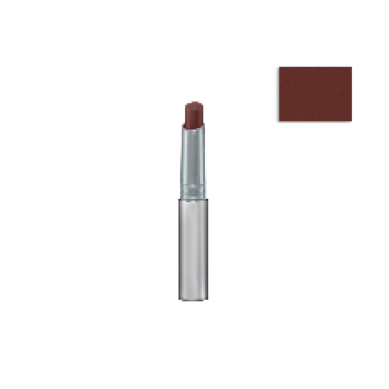

In [6]:
path = os.path.join('/kaggle/input', test_df['filename'][0])
image_arr = load_image(path)
plt.imshow(image_arr)
plt.axis('off')
plt.show()


In [7]:
# thêm cột kaggle_filename 
test_df['kaggle_filename'] = test_df['filename'].apply(lambda filename:os.path.join('/kaggle/input', filename))
train_df['kaggle_filename'] = train_df['filename'].apply(lambda filename:os.path.join('/kaggle/input', filename))

In [8]:
train_df.head(1)

,id,gender,masterCategory,categorical,articleType,baseColour,season,year,usage,productDisplayName,filename,link,kaggle_filename
0,12221,Men,Apparel,Bottomwear,Trousers,Grey,Summer,2013.0,Formal,Basics Men Grey Trousers,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...


In [9]:
test_df.head(1)

,id,gender,masterCategory,categorical,articleType,baseColour,season,year,usage,productDisplayName,filename,link,kaggle_filename
0,56049,Women,Personal Care,Lips,Lipstick,Brown,Spring,2017.0,Casual,Colorbar Full Finish Longwear Wicked Brown Lip...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/560...,/kaggle/input/fashion-product-images-dataset/f...


In [10]:
# as data source
train_datagen = ImageDataGenerator(rescale=1/255.)
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    x_col='kaggle_filename',
    y_col='categorical',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)


Found 10908 validated image filenames belonging to 20 classes.


In [11]:
test_datagen = ImageDataGenerator(rescale=1/255.)
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='kaggle_filename',
    y_col='categorical',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1364 validated image filenames belonging to 20 classes.


In [12]:
path = '/kaggle/input/model20/vgg19-1684220220_loss_opti.hdf5'
extractor = load_model(path)

In [13]:
extractor.evaluate(test_generator)

43/43 [==============================] - 51s 889ms/step - loss: 0.2929 - accuracy: 0.9025


[0.2928653955459595, 0.9024926424026489]

In [14]:
extractor.evaluate(train_generator)

341/341 [==============================] - 260s 763ms/step - loss: 0.2265 - accuracy: 0.9209


[0.22654850780963898, 0.9208837747573853]

In [15]:
# indices to class
class_indices = train_generator.class_indices
indices_class = {v: k for k, v in class_indices.items()}

1/1 [==============================] - 1s 1s/step
prediction label: Lips
true label: Lips


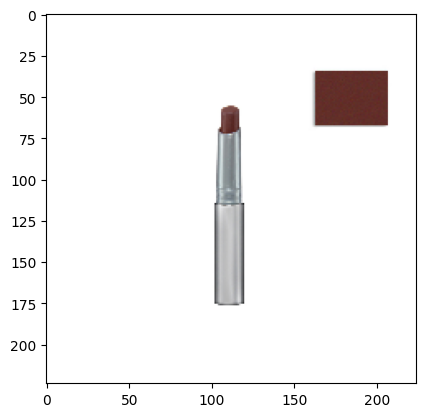

In [16]:
# test du doan
path = os.path.join('/kaggle/input', test_df['filename'][0])
image_arr = load_image(path)
y_hat = extractor.predict(image_arr.reshape(-1, IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
predicted_indices = y_hat.argmax()
predicted_class = indices_class[predicted_indices]
print('prediction label: %s' % predicted_class)
print('true label: %s' % test_df['categorical'][0])
plt.imshow(image_arr)
plt.show()

In [17]:
# hash code

In [18]:
hashcode_extractor = Model(inputs=extractor.input, outputs=extractor.layers[-4].output)

In [19]:
hashcodes = hashcode_extractor.predict_generator(test_generator)

In [20]:
predicted_indices = np.argmax(extractor.predict_generator(test_generator), axis=1)

In [21]:
test_df['predicted_categorical'] = [indices_class[idx] for idx in predicted_indices]

In [22]:
test_df

,id,gender,masterCategory,categorical,articleType,baseColour,season,year,usage,productDisplayName,filename,link,kaggle_filename,predicted_categorical
0,56049,Women,Personal Care,Lips,Lipstick,Brown,Spring,2017.0,Casual,Colorbar Full Finish Longwear Wicked Brown Lip...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/560...,/kaggle/input/fashion-product-images-dataset/f...,Lips
1,41681,Women,Footwear,Shoes,Heels,Silver,Winter,2012.0,Casual,Catwalk Women Silver Heels,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Shoes
2,43513,Women,Apparel,Dress,Dresses,Orange,Summer,2012.0,Casual,French Connection Women Orange Dress,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Dress
3,30576,Men,Accessories,Eyewear,Sunglasses,Black,Winter,2016.0,Casual,Opium Men Aviator Black Sunglass,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Eyewear
4,8444,Women,Apparel,Topwear,Tshirts,Green,Fall,2011.0,Casual,Jealous 21 Women Jealous Eirny Green Top Green...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Topwear
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1359,27425,Women,Apparel,Loungewear and Nightwear,Lounge Shorts,Navy Blue,Winter,2015.0,Casual,Jockey Women Navy Blue Lounge Shorts,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Bottomwear
1360,44198,Women,Footwear,Flip Flops,Flip Flops,Black,Winter,2012.0,Casual,iPanema Women Black Flip Flops,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Flip Flops
1361,29223,Men,Accessories,Socks,Socks,White,Fall,2014.0,Sports,Fila Men Pack Of 3 Socks,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Socks
1362,55905,Women,Personal Care,Nails,Nail Polish,Peach,Spring,2017.0,Casual,Colorbar Theme For a Dream Nail Lacquer 13,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/559...,/kaggle/input/fashion-product-images-dataset/f...,Nails


In [23]:
# luu du lieu da xu ly
file_path = 'fashion-product_hashcode.csv'
test_df.to_csv(file_path, index=False)

In [24]:
df_csv = pd.read_csv('/kaggle/working/fashion-product_hashcode.csv')

In [25]:
(test_df['categorical'] == test_df['predicted_categorical']).sum()

1231

In [26]:
hashcodes = np.where(hashcodes<0.5, -1, 1)

In [27]:
test_df['hashcode'] = list(hashcodes)

In [28]:
test_df

,id,gender,masterCategory,categorical,articleType,baseColour,season,year,usage,productDisplayName,filename,link,kaggle_filename,predicted_categorical,hashcode
0,56049,Women,Personal Care,Lips,Lipstick,Brown,Spring,2017.0,Casual,Colorbar Full Finish Longwear Wicked Brown Lip...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/560...,/kaggle/input/fashion-product-images-dataset/f...,Lips,"[-1, 1, -1, 1, 1, -1, -1, -1, -1, -1, -1, 1, -..."
1,41681,Women,Footwear,Shoes,Heels,Silver,Winter,2012.0,Casual,Catwalk Women Silver Heels,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Shoes,"[-1, 1, -1, 1, -1, 1, -1, 1, -1, 1, -1, 1, -1,..."
2,43513,Women,Apparel,Dress,Dresses,Orange,Summer,2012.0,Casual,French Connection Women Orange Dress,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Dress,"[1, -1, -1, 1, 1, -1, 1, 1, 1, -1, -1, 1, -1, ..."
3,30576,Men,Accessories,Eyewear,Sunglasses,Black,Winter,2016.0,Casual,Opium Men Aviator Black Sunglass,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Eyewear,"[-1, -1, -1, 1, -1, -1, 1, 1, -1, 1, 1, -1, -1..."
4,8444,Women,Apparel,Topwear,Tshirts,Green,Fall,2011.0,Casual,Jealous 21 Women Jealous Eirny Green Top Green...,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Topwear,"[-1, -1, -1, 1, 1, -1, 1, 1, 1, -1, -1, 1, -1,..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1359,27425,Women,Apparel,Loungewear and Nightwear,Lounge Shorts,Navy Blue,Winter,2015.0,Casual,Jockey Women Navy Blue Lounge Shorts,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Bottomwear,"[1, 1, 1, 1, 1, -1, -1, 1, 1, -1, -1, 1, -1, 1..."
1360,44198,Women,Footwear,Flip Flops,Flip Flops,Black,Winter,2012.0,Casual,iPanema Women Black Flip Flops,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Flip Flops,"[1, -1, -1, 1, -1, 1, -1, 1, -1, 1, -1, -1, 1,..."
1361,29223,Men,Accessories,Socks,Socks,White,Fall,2014.0,Sports,Fila Men Pack Of 3 Socks,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/v1/images/style/p...,/kaggle/input/fashion-product-images-dataset/f...,Socks,"[1, 1, -1, 1, 1, -1, -1, 1, -1, -1, -1, 1, -1,..."
1362,55905,Women,Personal Care,Nails,Nail Polish,Peach,Spring,2017.0,Casual,Colorbar Theme For a Dream Nail Lacquer 13,fashion-product-images-dataset/fashion-dataset...,http://assets.myntassets.com/assets/images/559...,/kaggle/input/fashion-product-images-dataset/f...,Nails,"[1, 1, -1, 1, 1, -1, 1, -1, -1, -1, 1, 1, -1, ..."


In [29]:
len(test_df.hashcode[0])

1024

In [30]:
class CBIR:
    def __init__(self, hashcode_extractor, df):
        self.df = df
        self.hashcode_extractor = hashcode_extractor
    
    def ranking(self, path, k):
        hashcode_query = self.extracting(path)
        scores = []
        for hashcode in self.df['hashcode']:
            dist = self.hamming_distance(hashcode_query, hashcode)
            scores.append(int(dist))
        my_list = scores
        sorted_indices = sorted(range(len(my_list)), key=lambda i: my_list[i])[:k]
        return sorted_indices
        
    def extracting(self, path):
        image_arr = self.load_image(path)
        hashcode = self.hashcode_extractor.predict(image_arr.reshape(-1, IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
        hashcode = np.where(hashcode<0.5, -1, 1)
        return hashcode[0]
    
    def hamming_distance(self, hashcode1, hashcode2):
        return (len(hashcode1) - np.dot(hashcode1, hashcode2))/2
    
    def load_image(self, path):
        image_arr = cv2.imread(path)
        image_arr = cv2.cvtColor(image_arr, cv2.COLOR_RGB2BGR)
        image_arr = cv2.resize(image_arr, (IMAGE_SIZE, IMAGE_SIZE))
        return image_arr
    
    def show_image(self, path, k):
        image_arr = self.load_image(path)
        plt.imshow(image_arr)
        plt.axis('off')
        plt.show()
        id_resulted_image = self.ranking(path, k)
        for i, idx in enumerate(id_resulted_image):
            plt.subplot(math.ceil(k/3), 3, i+1)
            plt.imshow(self.load_image(self.df['kaggle_filename'][idx]))
            plt.axis('off')
        plt.show()

In [31]:
cbir = CBIR(hashcode_extractor, test_df)

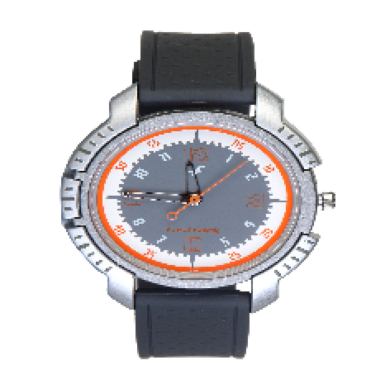

1/1 [==============================] - 0s 192ms/step


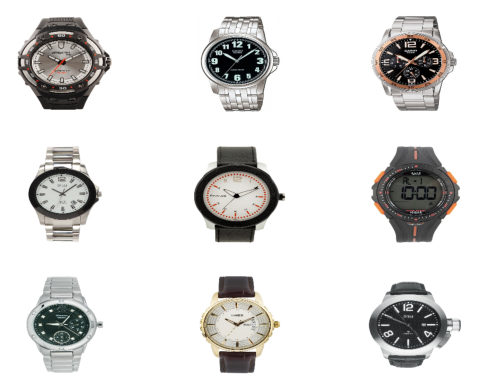

In [32]:
path = '/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/10099.jpg'
cbir.show_image(path, 9)

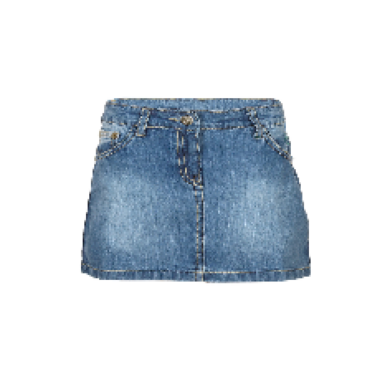

1/1 [==============================] - 0s 22ms/step


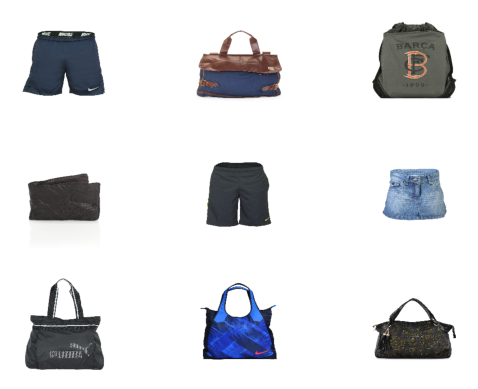

In [33]:
path = '/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/10001.jpg'
cbir.show_image(path, 9)

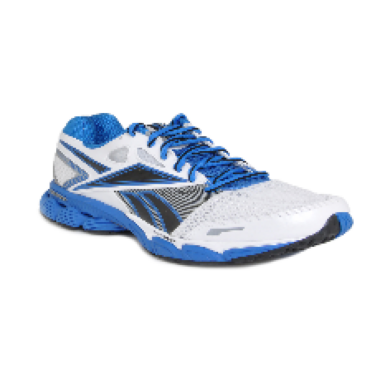

1/1 [==============================] - 0s 22ms/step


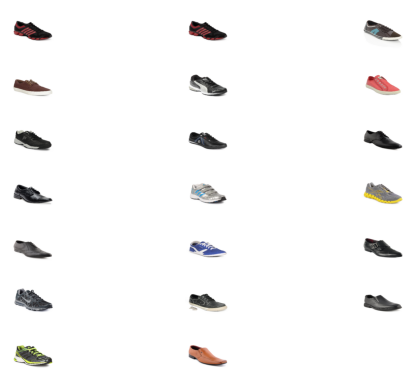

In [34]:
path = '/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/10111.jpg'
cbir.show_image(path, 20)

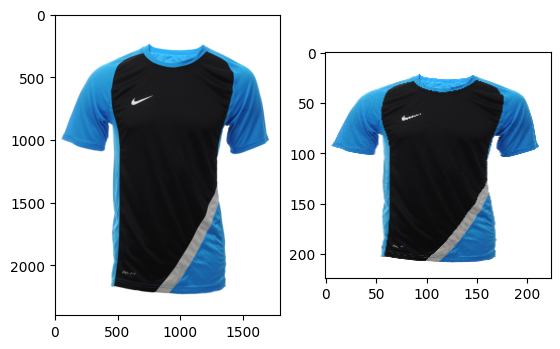

In [35]:
image_arr = cv2.imread('/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/10005.jpg')
image_arr = cv2.cvtColor(image_arr, cv2.COLOR_RGB2BGR)
plt.subplot(1, 2, 1)
plt.imshow(image_arr)
image_arr = cv2.resize(image_arr, (224, 224))
plt.subplot(1, 2, 2)
plt.imshow(image_arr)
plt.show()

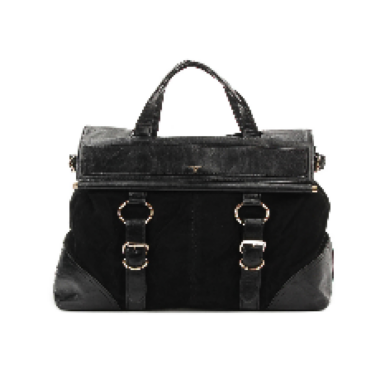

1/1 [==============================] - 0s 23ms/step


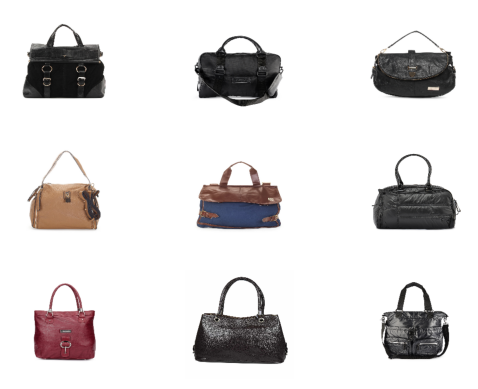

In [36]:
path = '/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/46988.jpg'
cbir.show_image(path,9)

In [37]:
class MAP:
    def __init__(self, hashcode_extractor, df,list_path, k):
        self.df = df
        self.hashcode_extractor = hashcode_extractor
        self.list_path = list_path
        self.k = k
    
    def ranking(self, path, k):
        hashcode_query = self.extracting(path)
        scores = []
        for hashcode in self.df['hashcode']:
            dist = self.hamming_distance(hashcode_query, hashcode)
            scores.append(int(dist))
        my_list = scores
        sorted_indices = sorted(range(len(my_list)), key=lambda i: my_list[i])[:k]
        return sorted_indices
        
    def extracting(self, path):
        image_arr = self.load_image(path)
        hashcode = self.hashcode_extractor.predict(image_arr.reshape(-1, IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
        hashcode = np.where(hashcode<0.5, -1, 1)
        return hashcode[0]
    
    def hamming_distance(self, hashcode1, hashcode2):
        return (len(hashcode1) - np.dot(hashcode1, hashcode2))/2
    
    def load_image(self, path):
        image_arr = cv2.imread(path)
        image_arr = cv2.cvtColor(image_arr, cv2.COLOR_RGB2BGR)
        image_arr = cv2.resize(image_arr, (IMAGE_SIZE, IMAGE_SIZE))
        return image_arr
    
    def calculate_map(self, df, list_path, k):
        map = 0
        for path in list_path:
            map += self.calculate_ap(df,path ,k)
        return map/len(list_path)
    def label(self,df,path, k):
        labels = []
        for i, idx in enumerate(self.ranking(path,k)):
#         print(test_df['kaggle_filename'][idx])
            if df['predicted_categorical'][idx] == df.loc[df['kaggle_filename'] == path]['categorical'].to_string().split(' ')[-1]:
                labels.append(1)
            else : labels.append(0)
        return labels
    def calculate_ap(self,df, path,  k):
        labels = self.label(df, path,k)
        true_positives = np.cumsum(labels)  # Tính tổng tích lũy của số lượng true positives
        total_positives = np.sum(labels)  # Tính tổng số positives

        precision = true_positives / np.arange(1, len(labels) + 1)  # Tính precision tại mỗi điểm cắt
#     recall = true_positives / total_positives  # Tính recall tại mỗi điểm cắt
        ap = np.sum(precision)/len(labels)
        return ap
    
    def show_image(self, path, k):
        image_arr = self.load_image(path)
        plt.imshow(image_arr)
        plt.axis('off')
        plt.show()
        id_resulted_image = self.ranking(path, k)
        for i, idx in enumerate(id_resulted_image):
            plt.subplot(math.ceil(k/3), 3, i+1)
            plt.imshow(self.load_image(self.df['kaggle_filename'][idx]))
            plt.axis('off')
        plt.show()

In [38]:
def calculate_MAP(list_path, list_labels, k):
    map = MAP(hashcode_extractor, test_df, list_path, k)
    print('MAP :',map.calculate_map(test_df, list_path, k))

    i = 0
    for path in list_path:
        map.label(test_df, path,9)
        map.show_image(path,9)
        i+=1
#     print('MAP',i)

1/1 [==============================] - 0s 25ms/step
MAP : 1.0
1/1 [==============================] - 0s 23ms/step


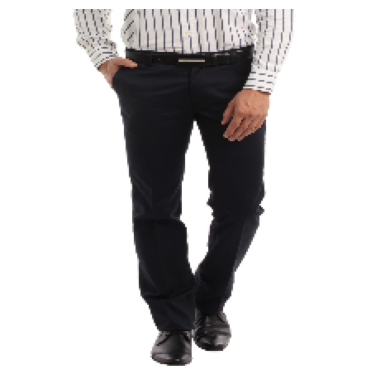

1/1 [==============================] - 0s 22ms/step


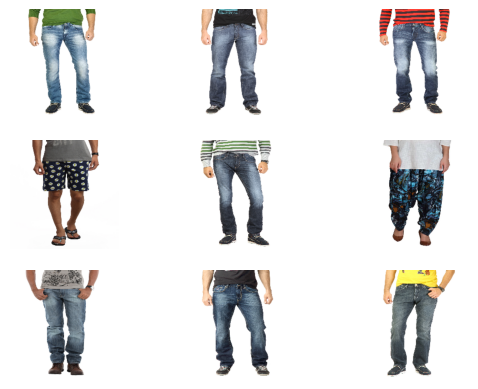

In [39]:
list_path = {'/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/44290.jpg'}

list_labels = ['Bottomwear']

calculate_MAP(list_path, list_labels, 9)

1/1 [==============================] - 0s 22ms/step
MAP : 1.0
1/1 [==============================] - 0s 25ms/step


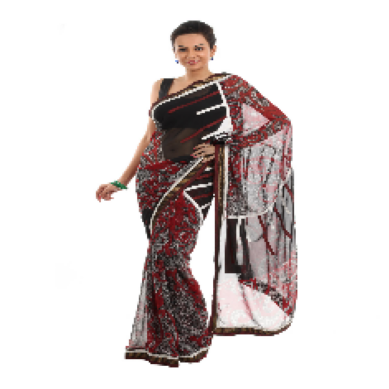

1/1 [==============================] - 0s 23ms/step


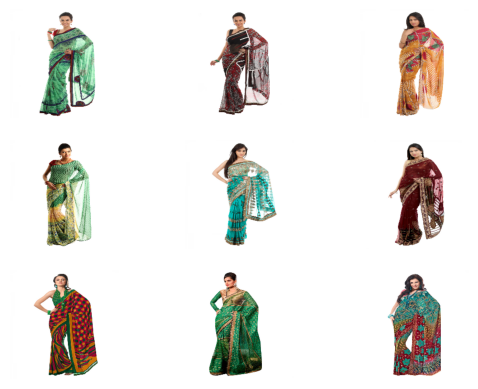

1/1 [==============================] - 0s 23ms/step


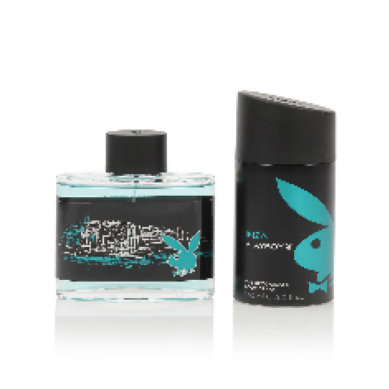

1/1 [==============================] - 0s 23ms/step


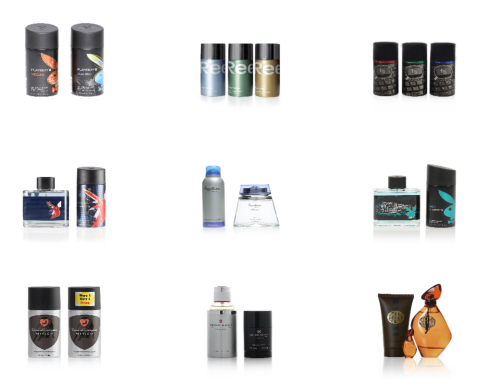

In [40]:
list_path = {'/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/32551.jpg',
             '/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/52969.jpg'
            
            }
list_labels = []
for path in list_path: 
#     test_df.loc[test_df['link']== path]
    list_labels.append(test_df.loc[test_df['kaggle_filename']== path]['id'])
calculate_MAP(list_path, list_labels, 9)

In [41]:
import random

MAP20

In [42]:
labels = test_df['categorical'].unique()

In [43]:
labels

array(['Lips', 'Shoes', 'Dress', 'Eyewear', 'Topwear', 'Belts', 'Socks',
       'Bags', 'Innerwear', 'Makeup', 'Wallets', 'Fragrance', 'Jewellery',
       'Bottomwear', 'Flip Flops', 'Sandal', 'Saree', 'Watches',
       'Loungewear and Nightwear', 'Nails'], dtype=object)

In [44]:
ids = []
for categorical in labels:
    tmp = test_df[test_df['categorical'] == categorical]
    id_tmp = tmp.id.values
    random.shuffle(list(id_tmp))
    ids.append(id_tmp[0])

In [45]:
len(ids)


20

In [46]:
list_path = []
for i in ids:
    list_path.append('/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/'+ str(i) +'.jpg')
    
    
list_path = {item for item in list_path}

1/1 [==============================] - 0s 23ms/step
MAP : 0.7709479717813051
1/1 [==============================] - 0s 22ms/step


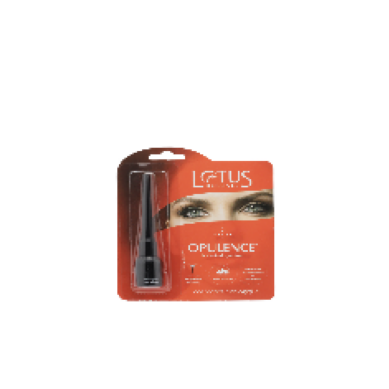

1/1 [==============================] - 0s 23ms/step


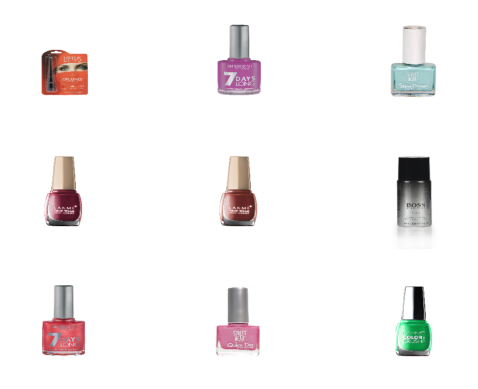

1/1 [==============================] - 0s 24ms/step


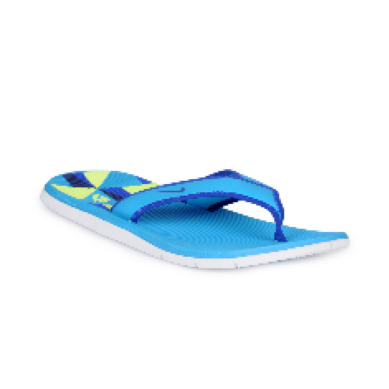

1/1 [==============================] - 0s 24ms/step


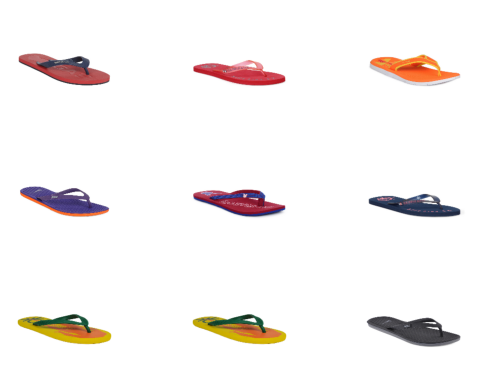

1/1 [==============================] - 0s 24ms/step


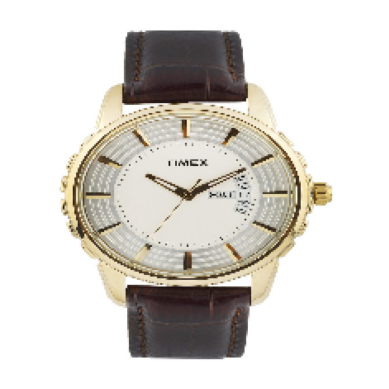

1/1 [==============================] - 0s 24ms/step


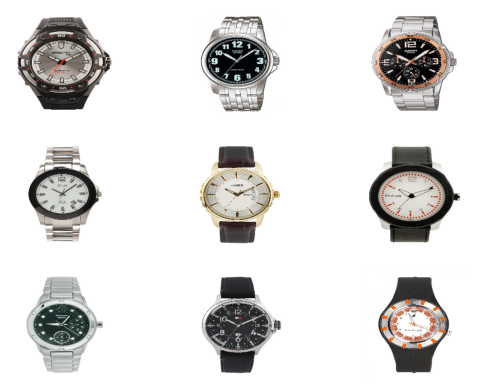

1/1 [==============================] - 0s 23ms/step


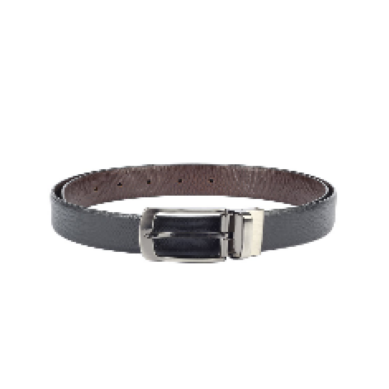

1/1 [==============================] - 0s 23ms/step


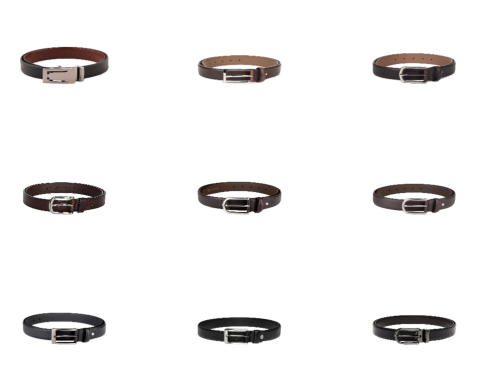

1/1 [==============================] - 0s 21ms/step


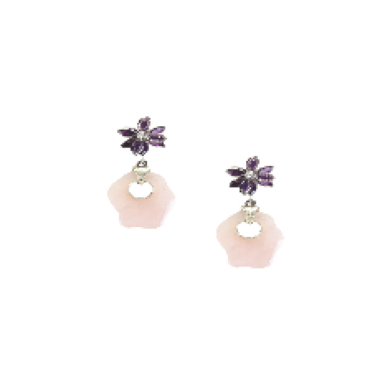

1/1 [==============================] - 0s 36ms/step


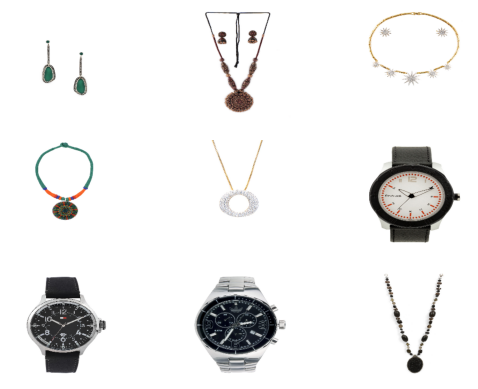

1/1 [==============================] - 0s 41ms/step


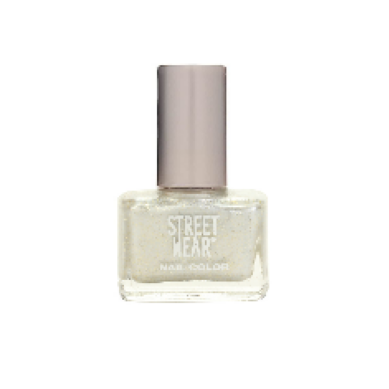

1/1 [==============================] - 0s 23ms/step


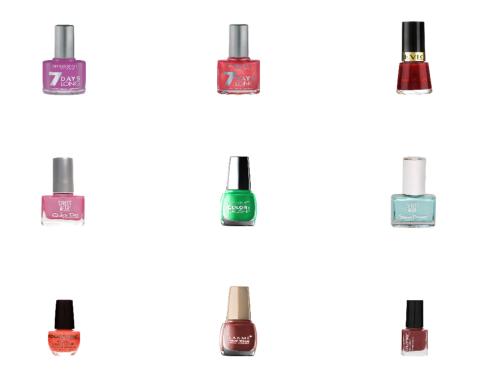

1/1 [==============================] - 0s 23ms/step


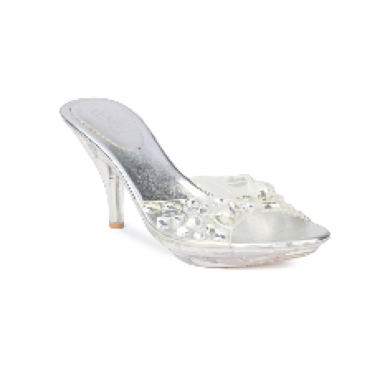

1/1 [==============================] - 0s 22ms/step


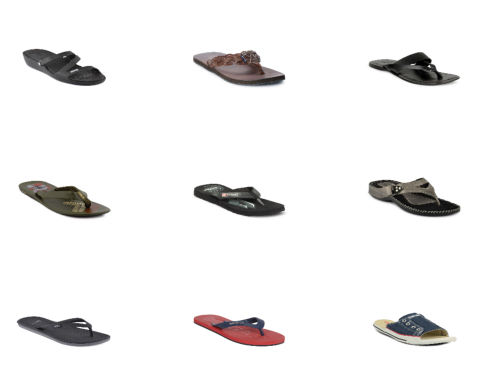

1/1 [==============================] - 0s 24ms/step


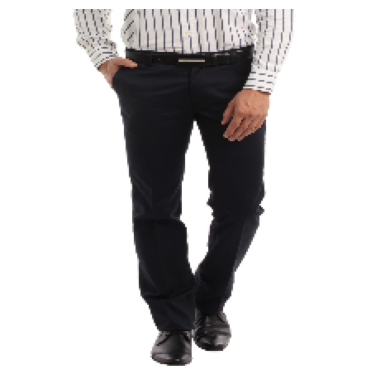

1/1 [==============================] - 0s 23ms/step


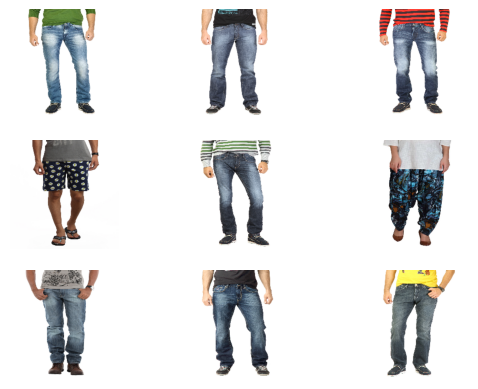

1/1 [==============================] - 0s 24ms/step


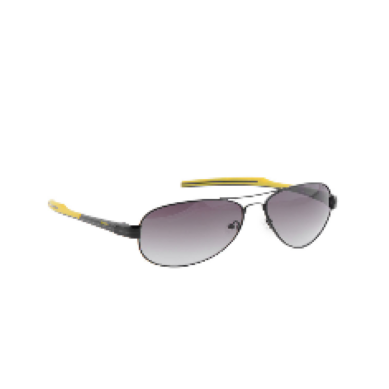

1/1 [==============================] - 0s 26ms/step


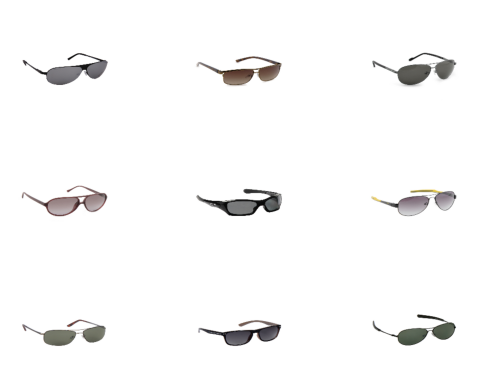

1/1 [==============================] - 0s 23ms/step


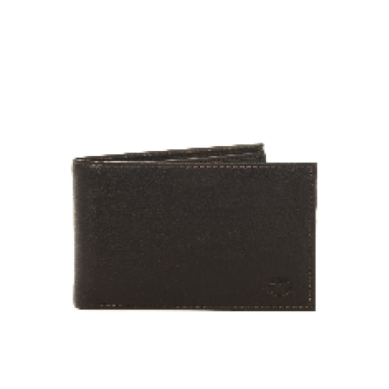

1/1 [==============================] - 0s 23ms/step


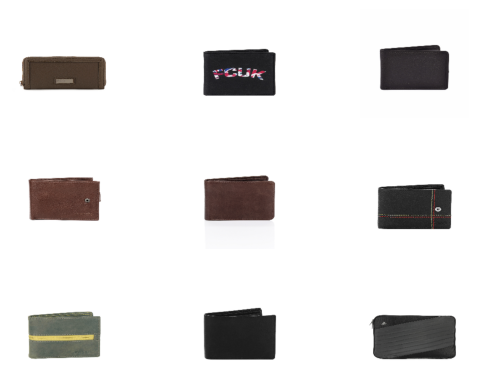

1/1 [==============================] - 0s 23ms/step


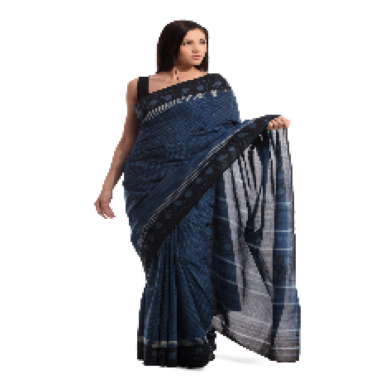

1/1 [==============================] - 0s 23ms/step


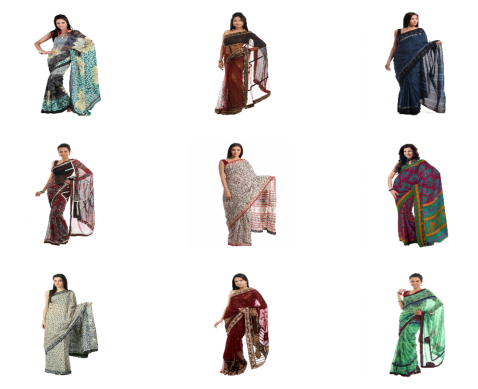

1/1 [==============================] - 0s 21ms/step


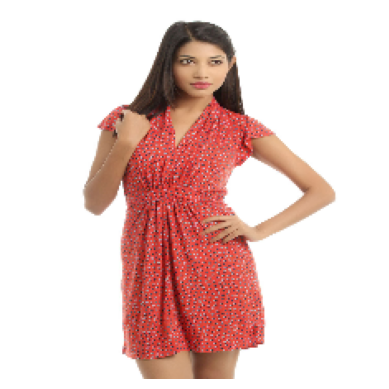

1/1 [==============================] - 0s 23ms/step


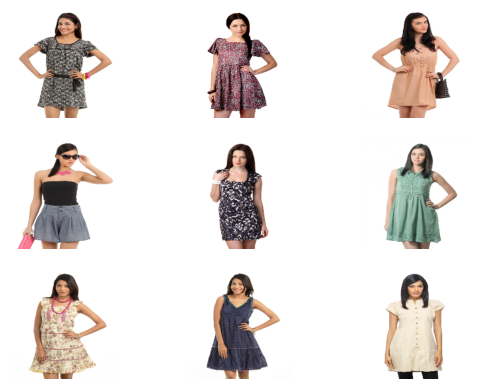

1/1 [==============================] - 0s 22ms/step


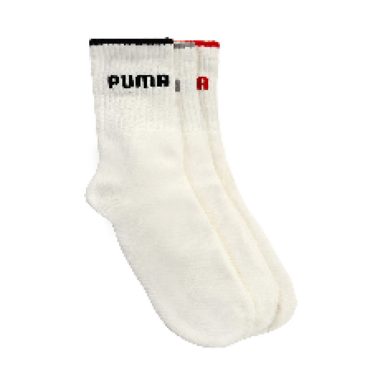

1/1 [==============================] - 0s 22ms/step


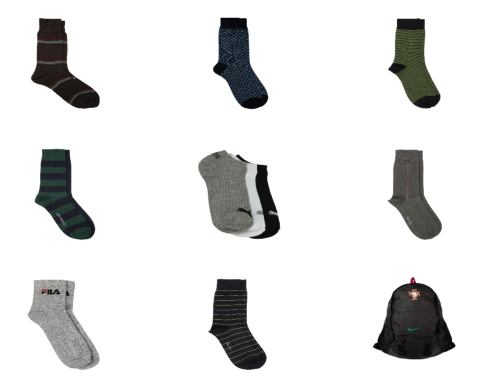

1/1 [==============================] - 0s 23ms/step


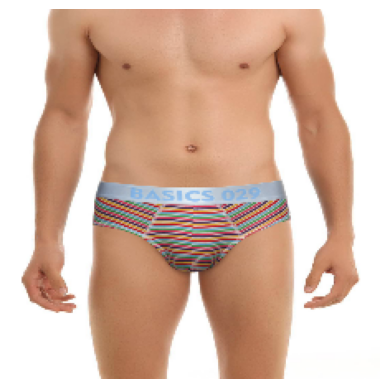

1/1 [==============================] - 0s 22ms/step


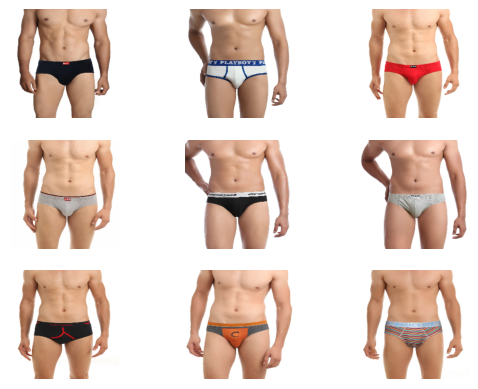

1/1 [==============================] - 0s 23ms/step


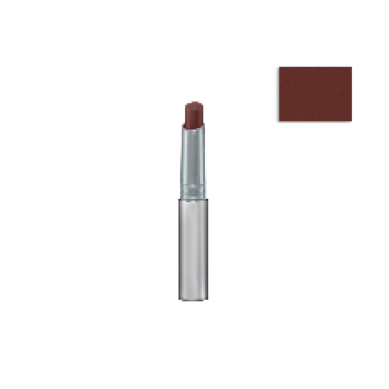

1/1 [==============================] - 0s 23ms/step


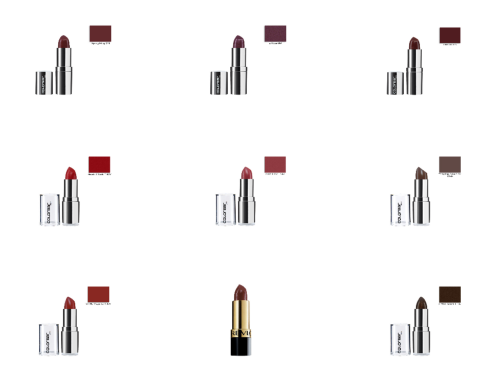

1/1 [==============================] - 0s 23ms/step


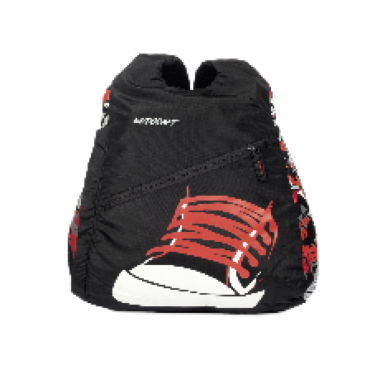

1/1 [==============================] - 0s 23ms/step


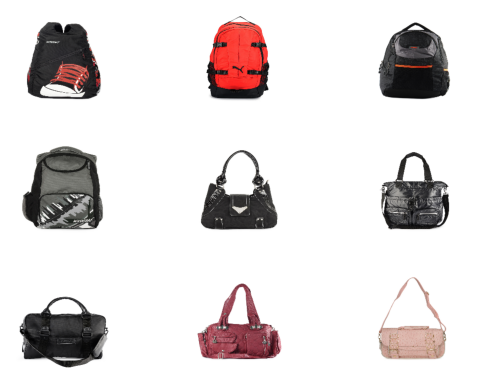

1/1 [==============================] - 0s 23ms/step


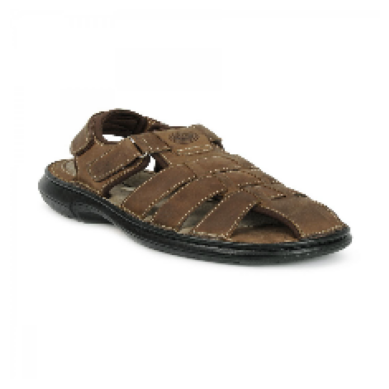

1/1 [==============================] - 0s 25ms/step


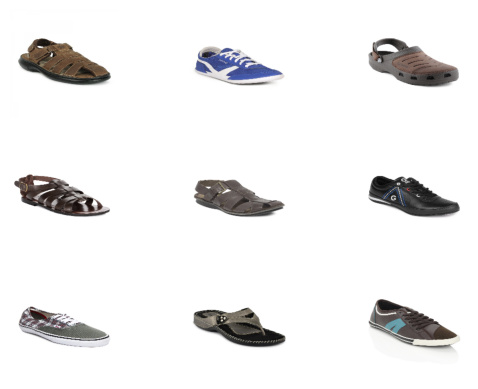

1/1 [==============================] - 0s 23ms/step


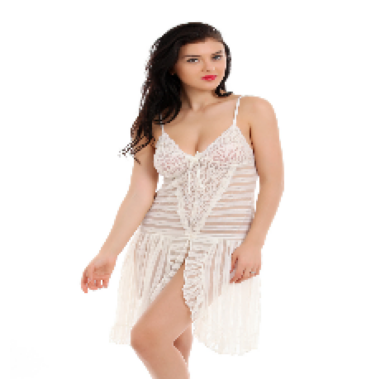

1/1 [==============================] - 0s 23ms/step


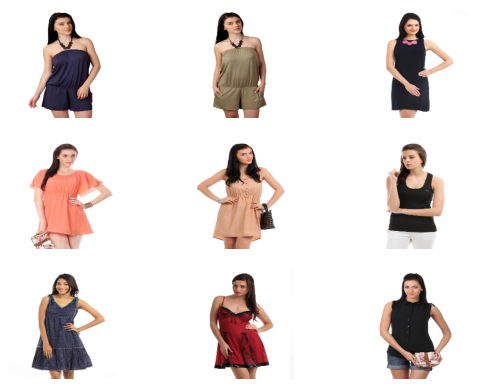

1/1 [==============================] - 0s 22ms/step


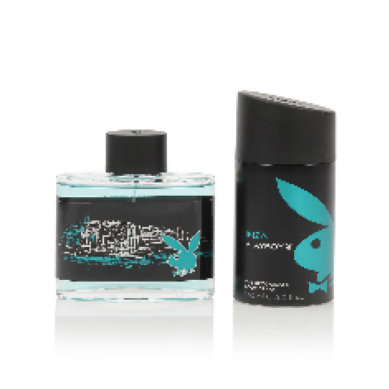

1/1 [==============================] - 0s 23ms/step


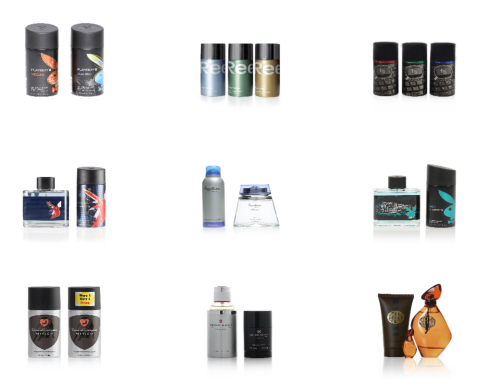

1/1 [==============================] - 0s 23ms/step


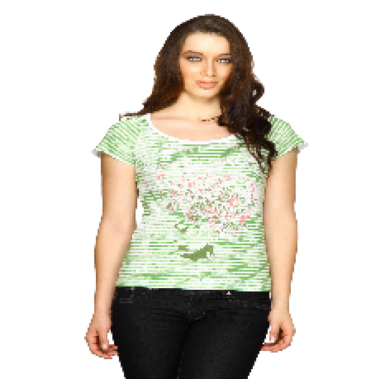

1/1 [==============================] - 0s 22ms/step


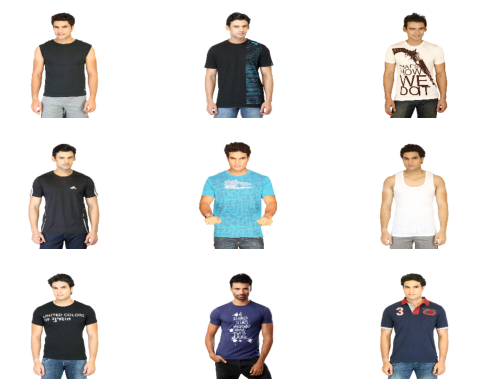

In [47]:
calculate_MAP(list_path, labels, 9)

In [48]:
ids = []
for categorical in labels:
    tmp = test_df[test_df['categorical'] == categorical]
    id_tmp = tmp.id.values
    random.shuffle(list(id_tmp))
    ids.append(id_tmp[0:10])

In [49]:
len(np.concatenate(ids))

200

1/1 [==============================] - 0s 25ms/step
MAP : 0.7287506613756614
1/1 [==============================] - 0s 26ms/step


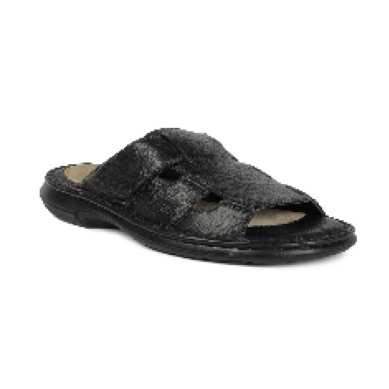

1/1 [==============================] - 0s 25ms/step


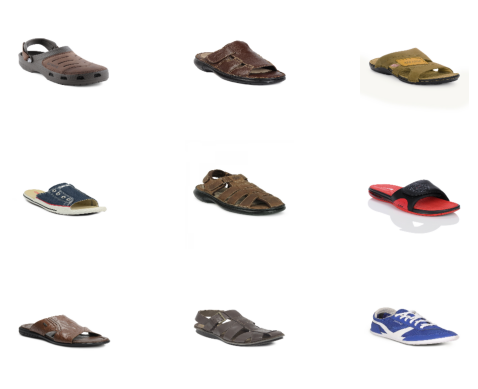

1/1 [==============================] - 0s 26ms/step


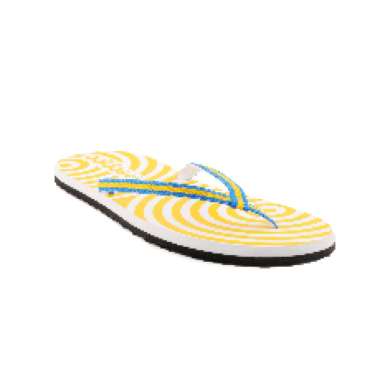

1/1 [==============================] - 0s 24ms/step


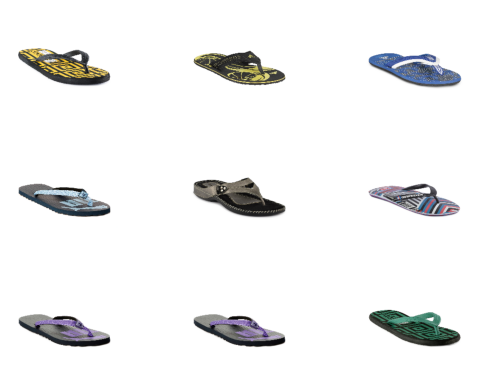

1/1 [==============================] - 0s 25ms/step


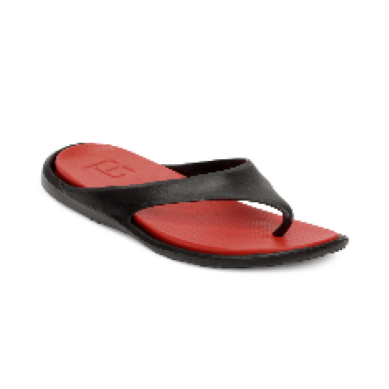

1/1 [==============================] - 0s 24ms/step


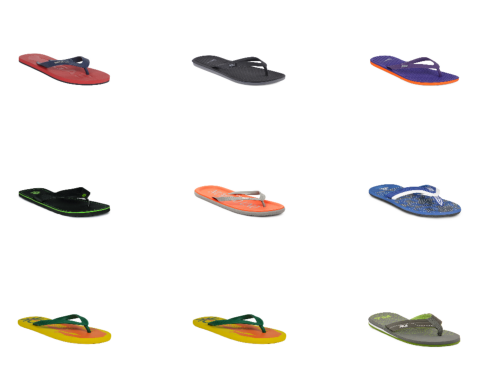

1/1 [==============================] - 0s 26ms/step


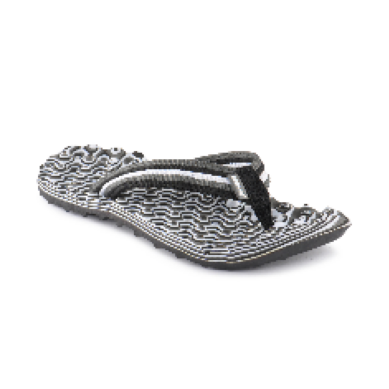

1/1 [==============================] - 0s 24ms/step


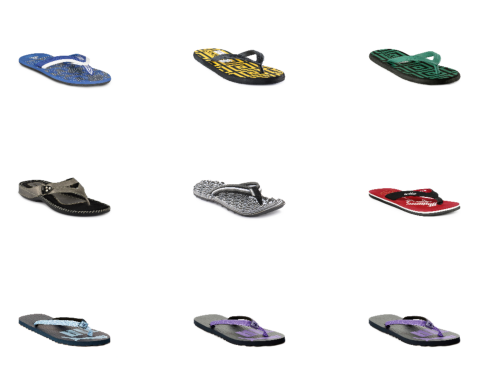

1/1 [==============================] - 0s 24ms/step


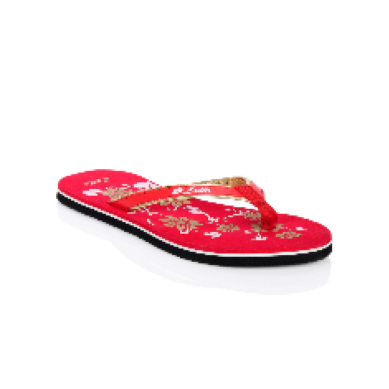

1/1 [==============================] - 0s 26ms/step


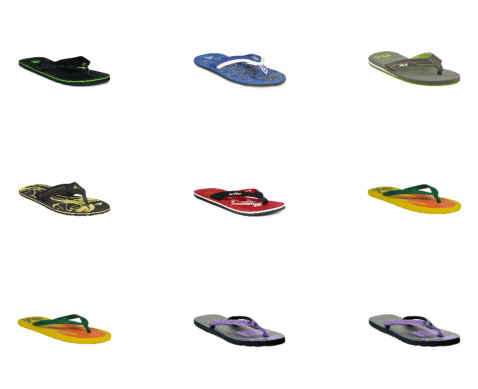

1/1 [==============================] - 0s 23ms/step


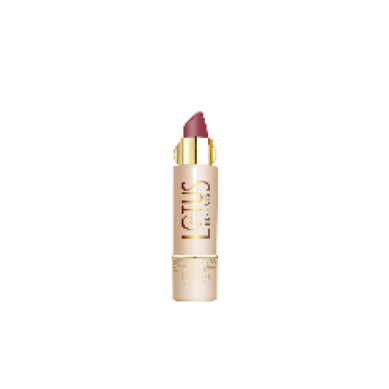

1/1 [==============================] - 0s 24ms/step


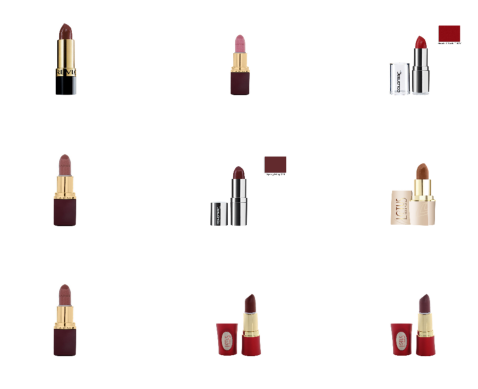

1/1 [==============================] - 0s 35ms/step


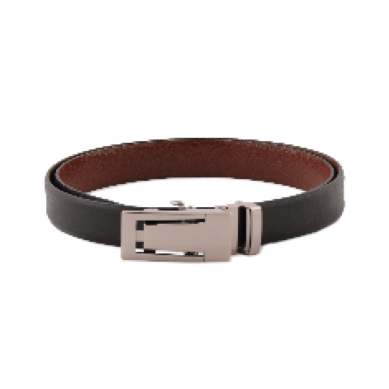

1/1 [==============================] - 0s 23ms/step


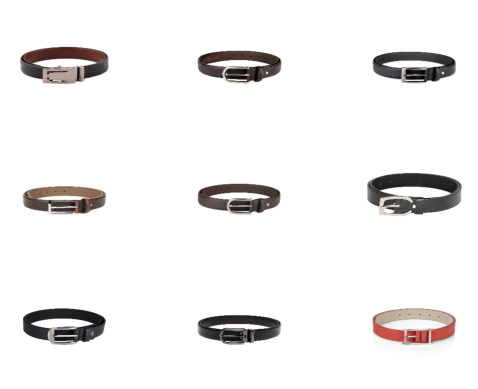

1/1 [==============================] - 0s 22ms/step


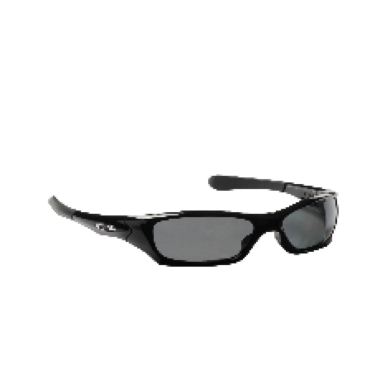

1/1 [==============================] - 0s 23ms/step


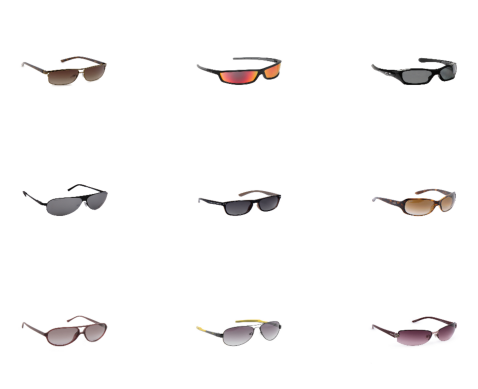

1/1 [==============================] - 0s 26ms/step


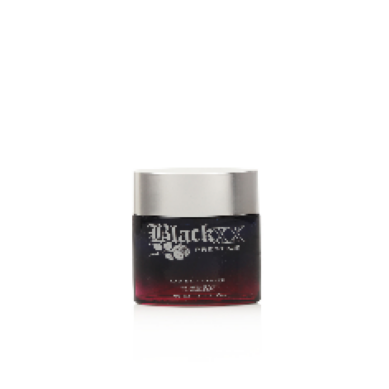

1/1 [==============================] - 0s 24ms/step


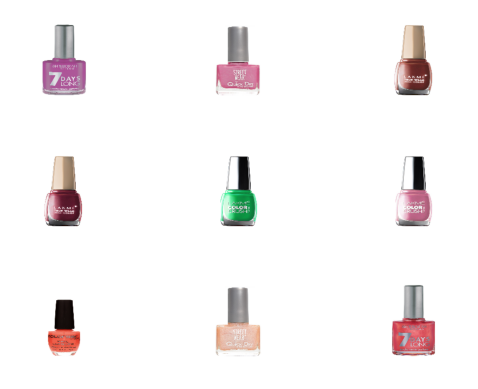

1/1 [==============================] - 0s 23ms/step


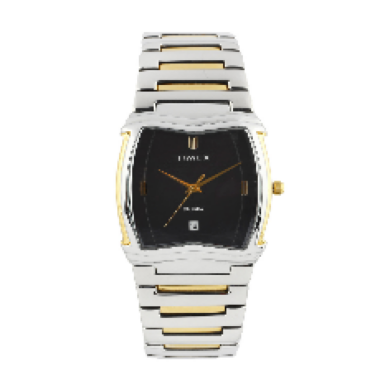

1/1 [==============================] - 0s 24ms/step


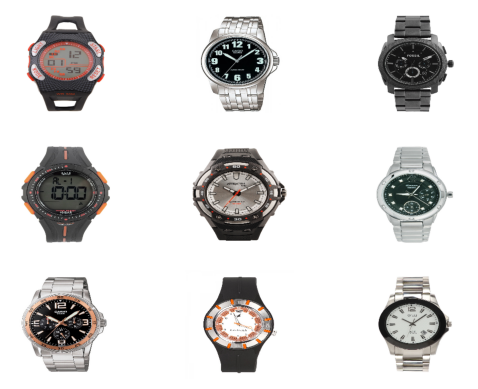

1/1 [==============================] - 0s 23ms/step


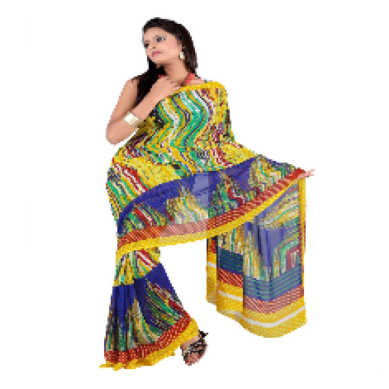

1/1 [==============================] - 0s 24ms/step


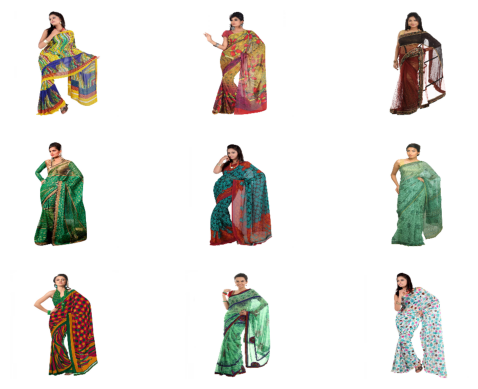

1/1 [==============================] - 0s 22ms/step


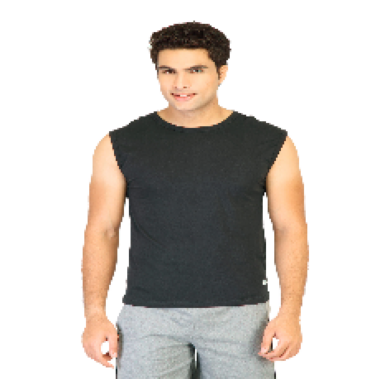

1/1 [==============================] - 0s 23ms/step


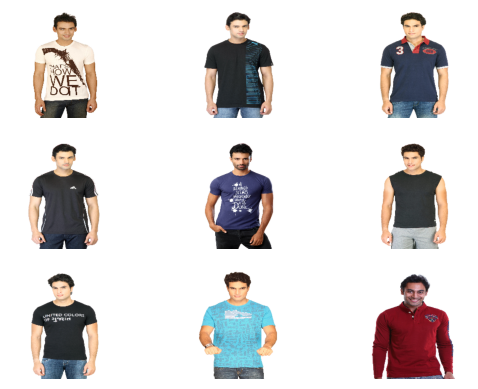

1/1 [==============================] - 0s 21ms/step


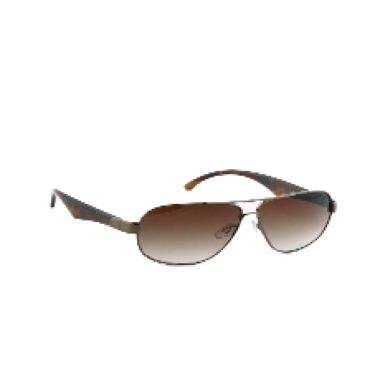

1/1 [==============================] - 0s 24ms/step


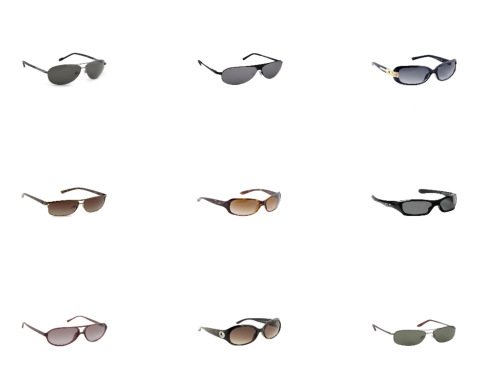

1/1 [==============================] - 0s 21ms/step


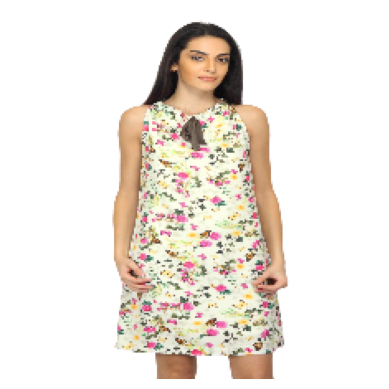

1/1 [==============================] - 0s 21ms/step


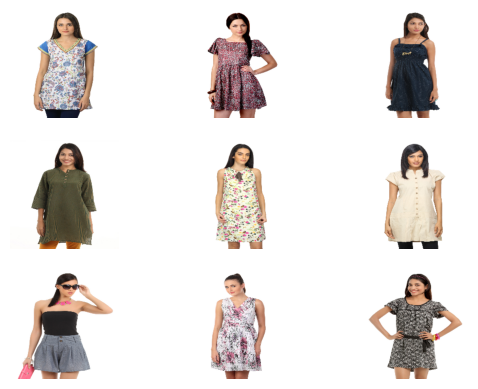

1/1 [==============================] - 0s 22ms/step


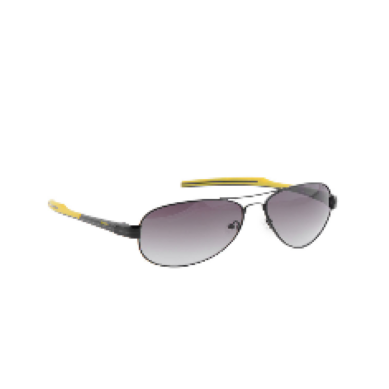

1/1 [==============================] - 0s 22ms/step


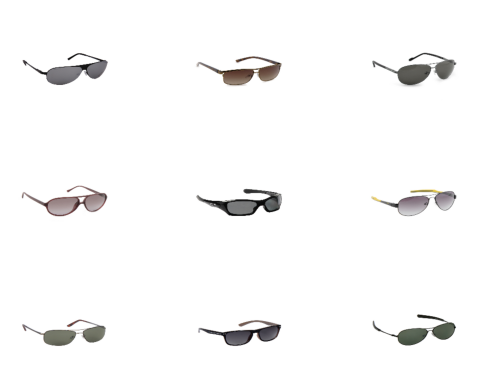

1/1 [==============================] - 0s 26ms/step


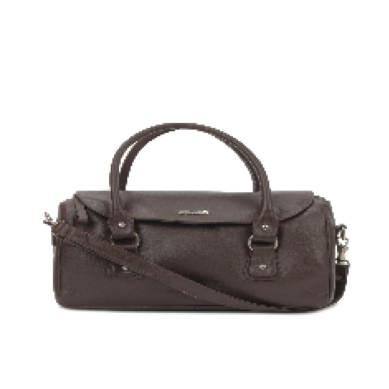

1/1 [==============================] - 0s 24ms/step


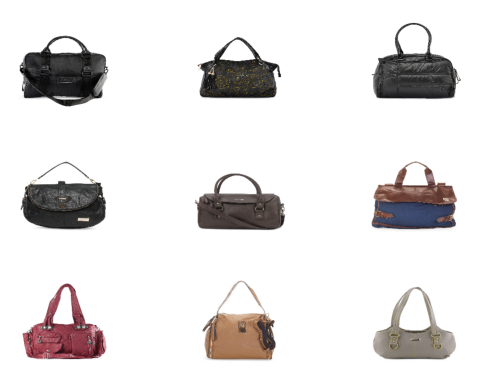

1/1 [==============================] - 0s 24ms/step


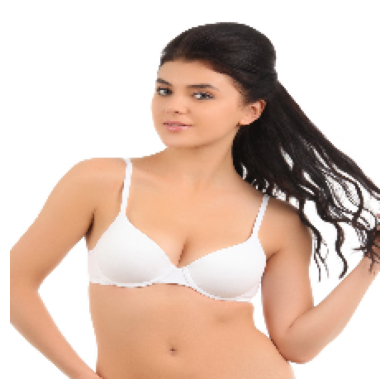

1/1 [==============================] - 0s 23ms/step


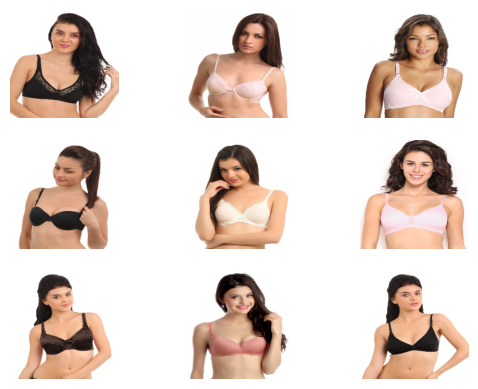

1/1 [==============================] - 0s 23ms/step


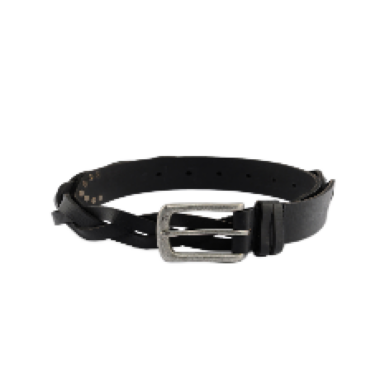

1/1 [==============================] - 0s 24ms/step


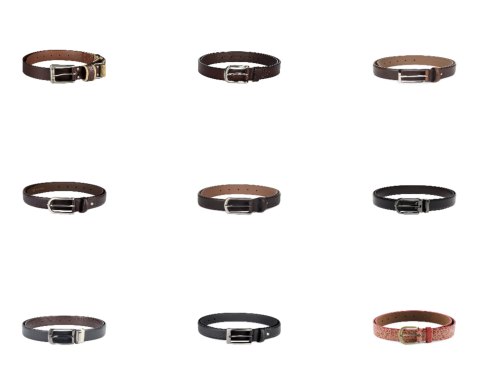

1/1 [==============================] - 0s 22ms/step


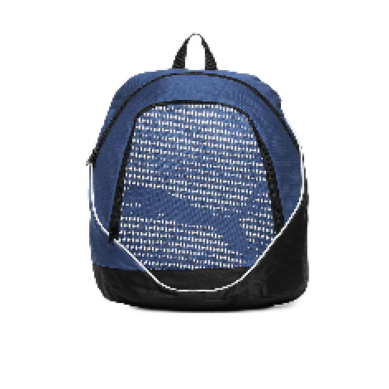

1/1 [==============================] - 0s 23ms/step


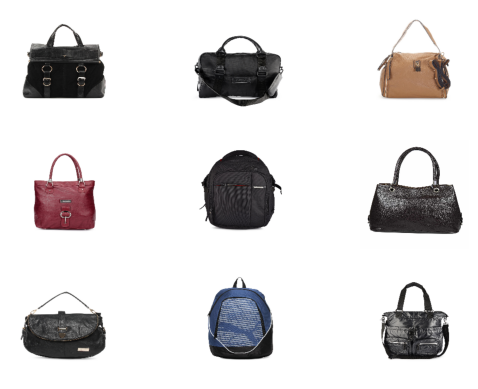

1/1 [==============================] - 0s 22ms/step


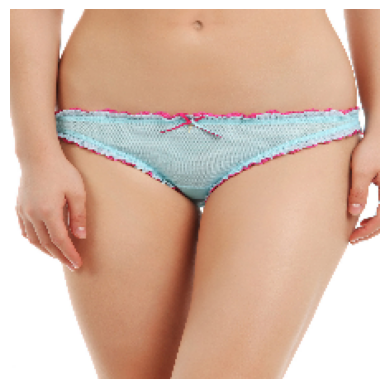

1/1 [==============================] - 0s 22ms/step


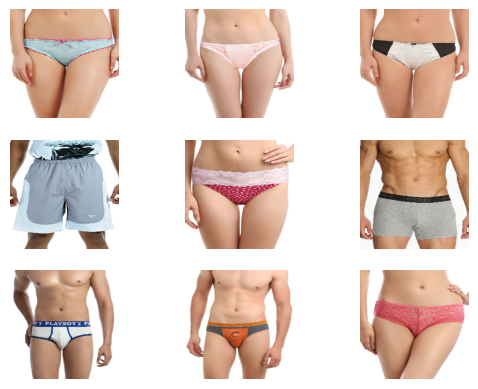

1/1 [==============================] - 0s 42ms/step


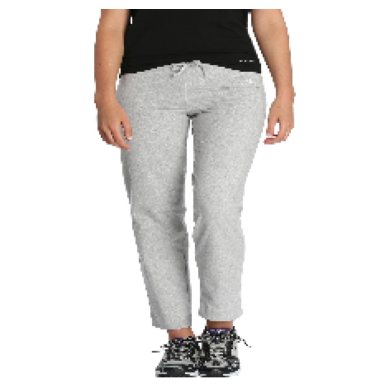

1/1 [==============================] - 0s 31ms/step


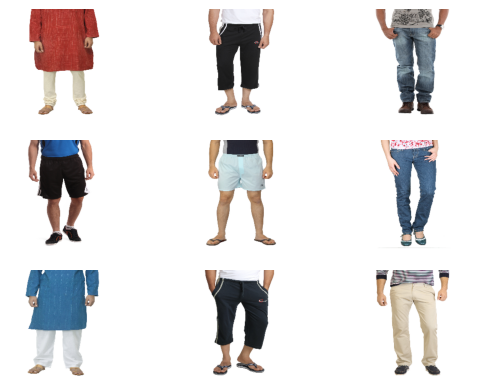

1/1 [==============================] - 0s 22ms/step


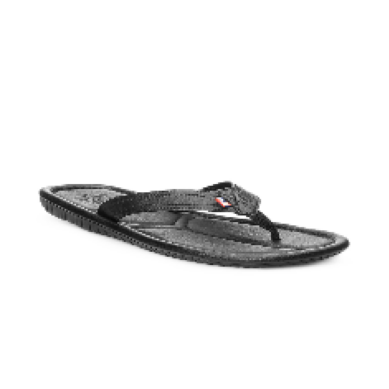

1/1 [==============================] - 0s 28ms/step


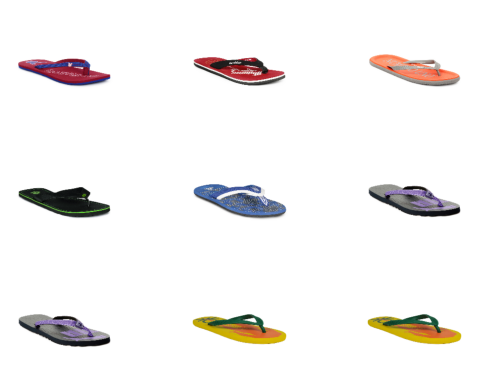

1/1 [==============================] - 0s 46ms/step


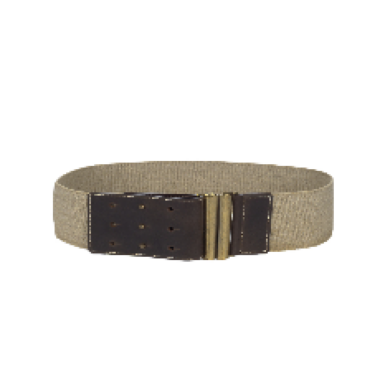

1/1 [==============================] - 0s 24ms/step


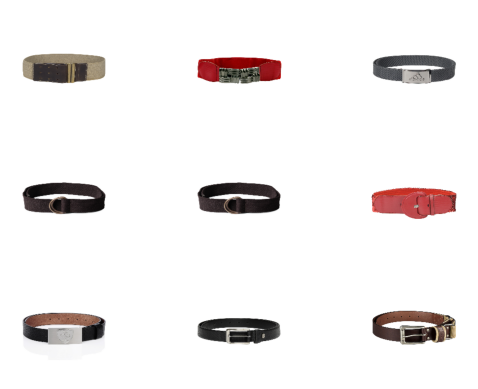

1/1 [==============================] - 0s 24ms/step


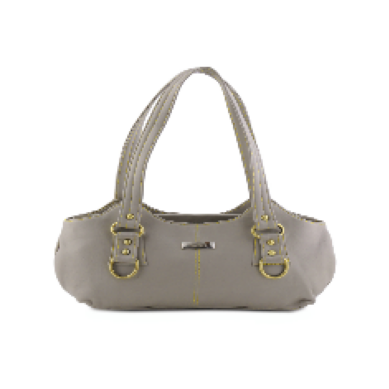

1/1 [==============================] - 0s 25ms/step


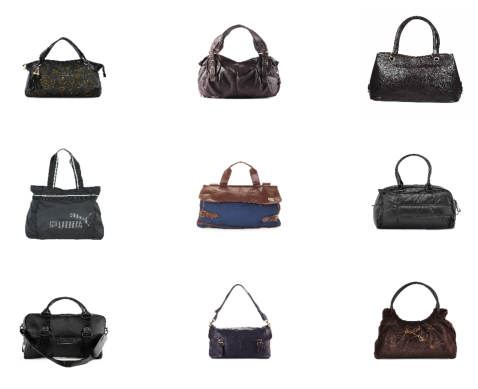

1/1 [==============================] - 0s 23ms/step


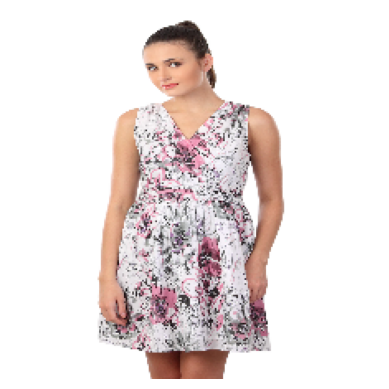

1/1 [==============================] - 0s 23ms/step


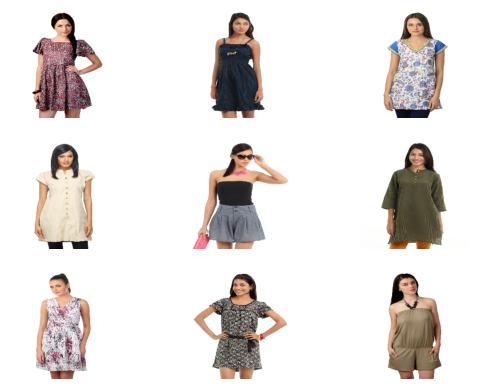

1/1 [==============================] - 0s 22ms/step


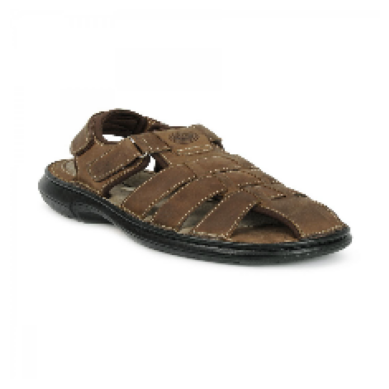

1/1 [==============================] - 0s 22ms/step


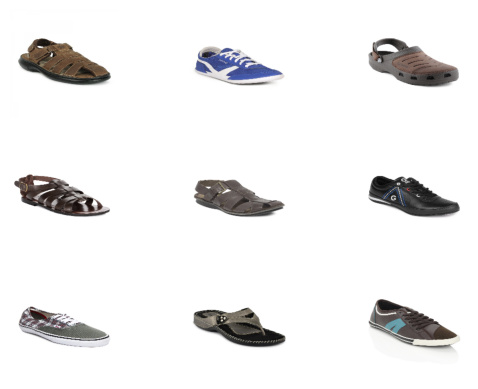

1/1 [==============================] - 0s 22ms/step


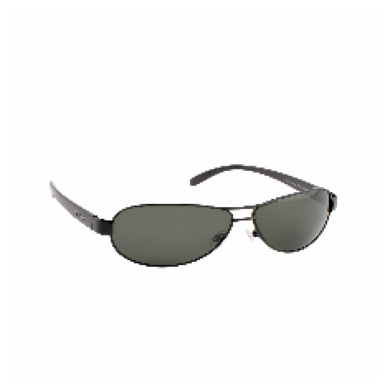

1/1 [==============================] - 0s 26ms/step


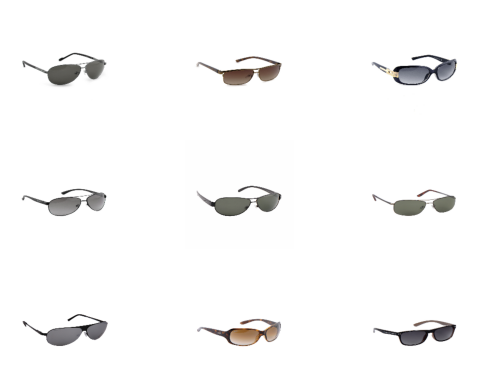

1/1 [==============================] - 0s 23ms/step


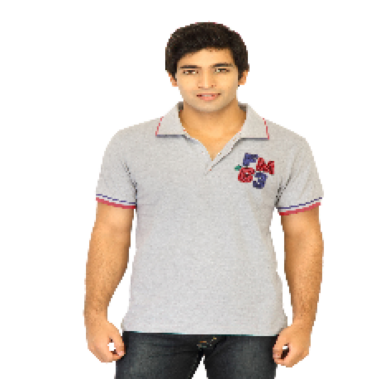

1/1 [==============================] - 0s 23ms/step


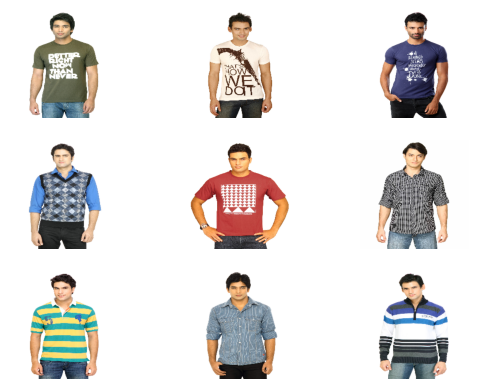

1/1 [==============================] - 0s 24ms/step


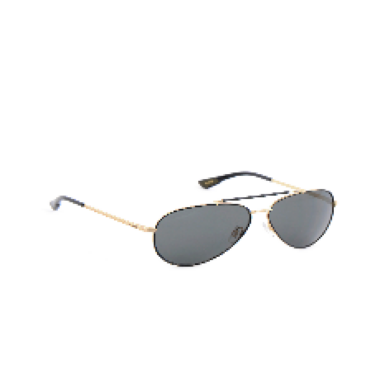

1/1 [==============================] - 0s 22ms/step


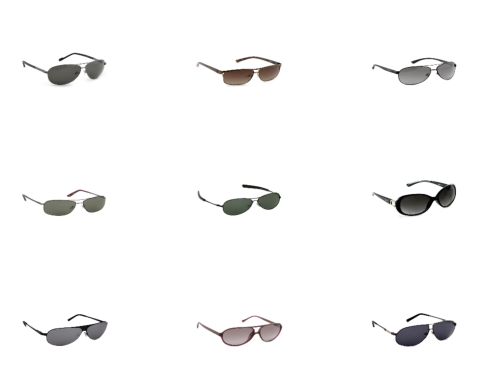

1/1 [==============================] - 0s 25ms/step


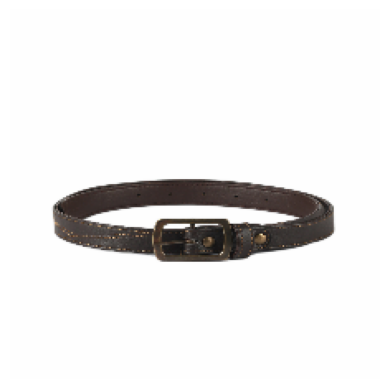

1/1 [==============================] - 0s 27ms/step


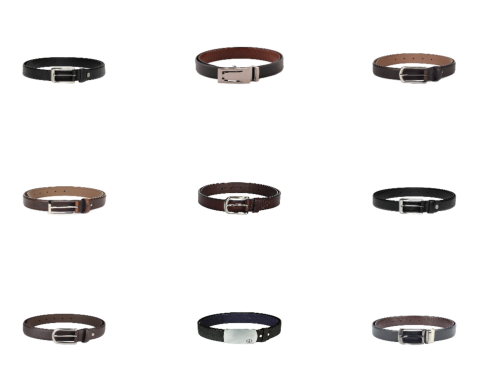

1/1 [==============================] - 0s 22ms/step


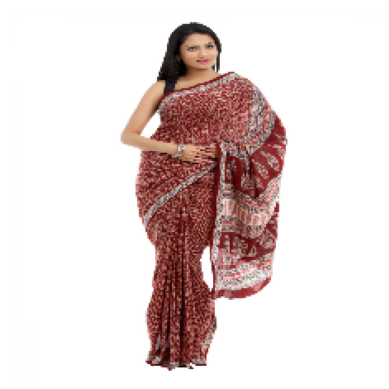

1/1 [==============================] - 0s 24ms/step


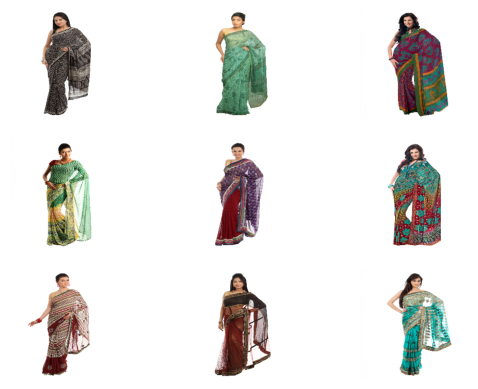

1/1 [==============================] - 0s 24ms/step


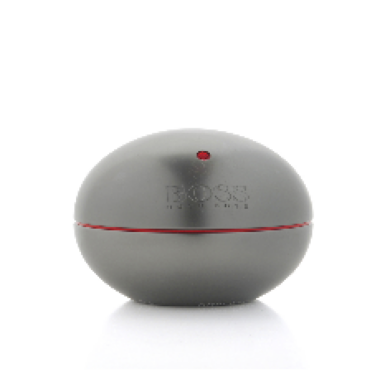

1/1 [==============================] - 0s 25ms/step


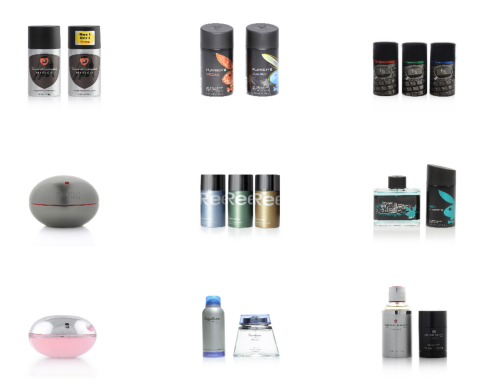

1/1 [==============================] - 0s 22ms/step


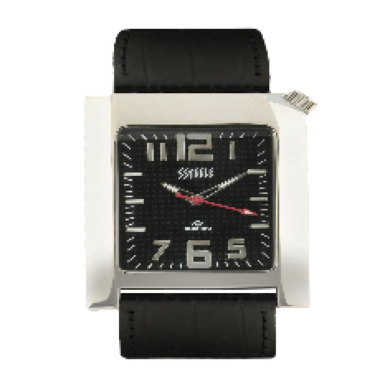

1/1 [==============================] - 0s 24ms/step


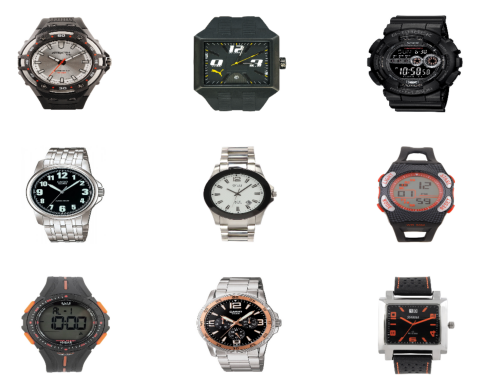

1/1 [==============================] - 0s 22ms/step


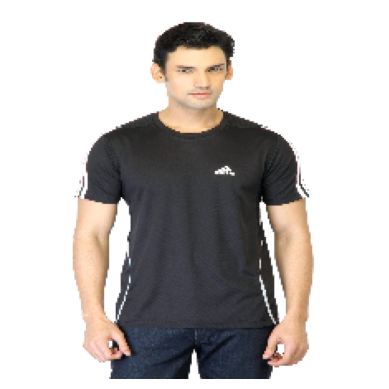

1/1 [==============================] - 0s 31ms/step


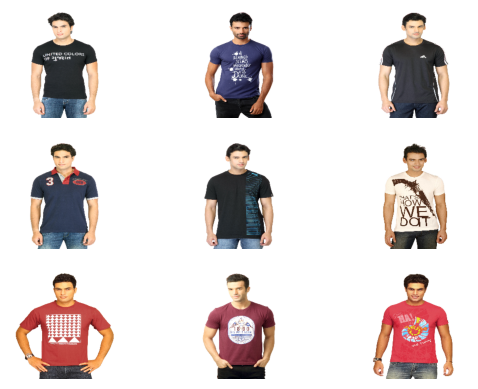

1/1 [==============================] - 0s 22ms/step


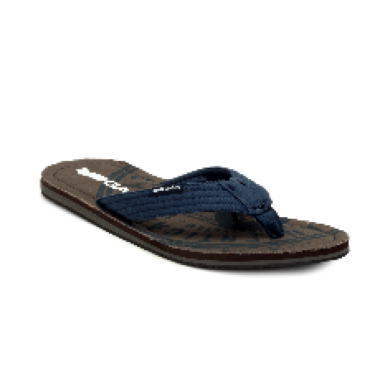

1/1 [==============================] - 0s 25ms/step


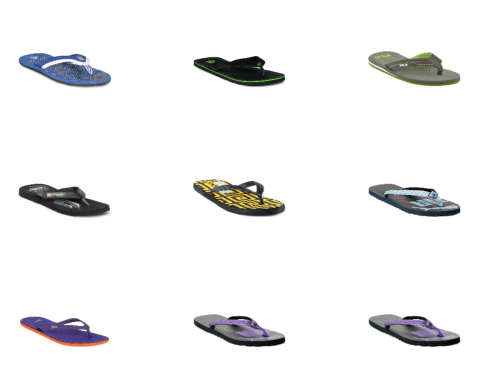

1/1 [==============================] - 0s 22ms/step


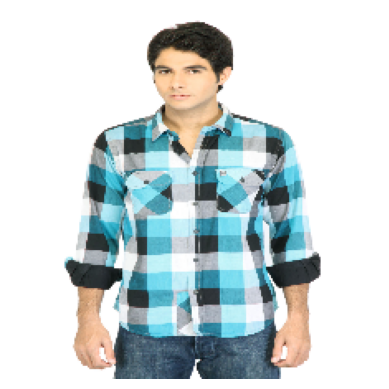

1/1 [==============================] - 0s 22ms/step


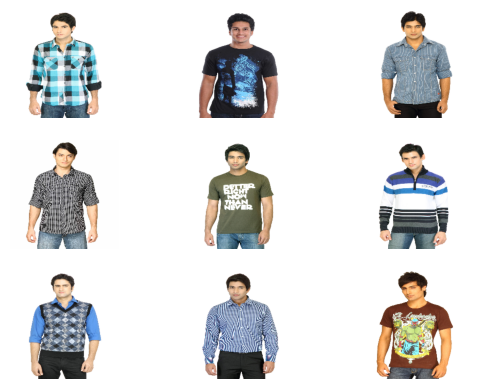

1/1 [==============================] - 0s 25ms/step


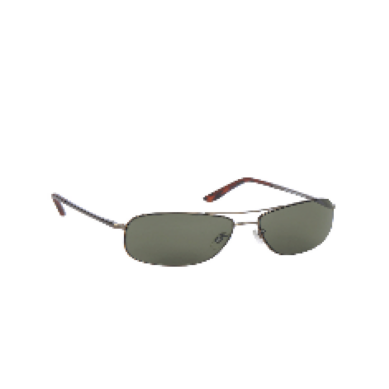

1/1 [==============================] - 0s 23ms/step


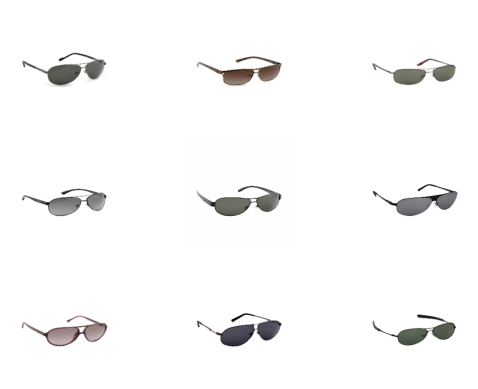

1/1 [==============================] - 0s 23ms/step


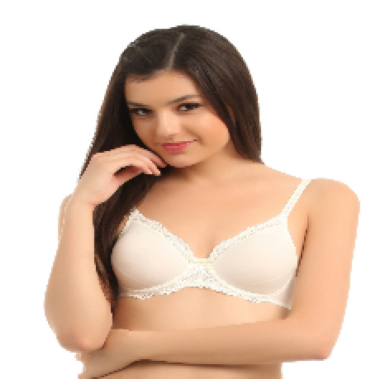

1/1 [==============================] - 0s 25ms/step


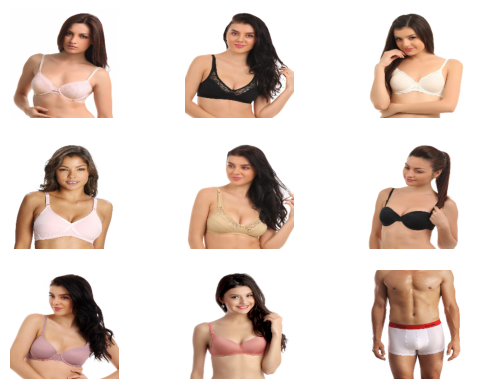

1/1 [==============================] - 0s 23ms/step


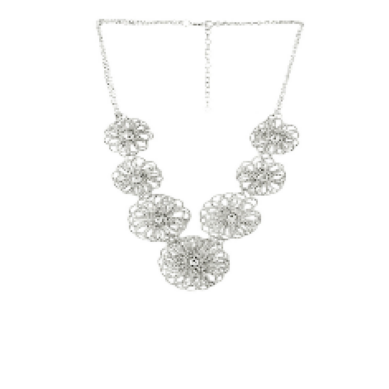

1/1 [==============================] - 0s 24ms/step


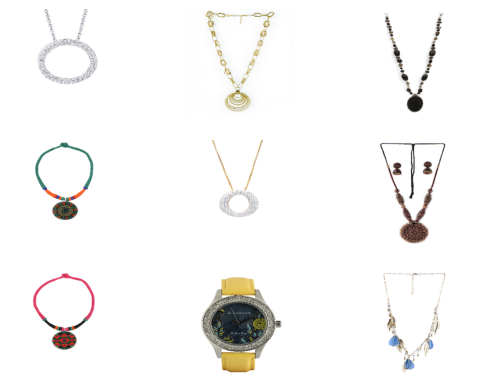

1/1 [==============================] - 0s 23ms/step


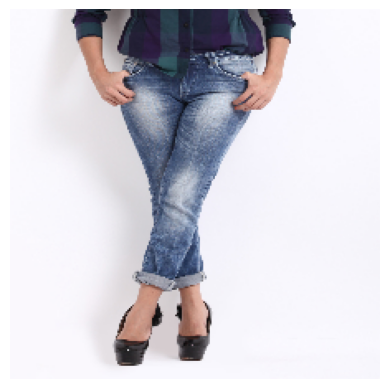

1/1 [==============================] - 0s 24ms/step


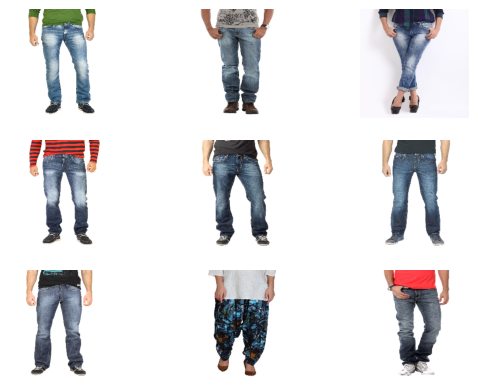

1/1 [==============================] - 0s 22ms/step


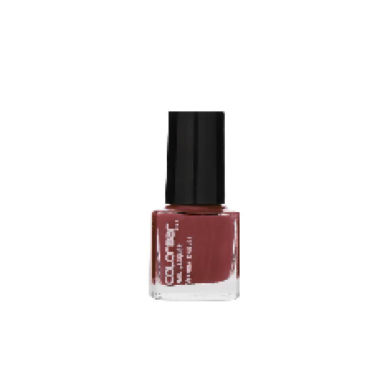

1/1 [==============================] - 0s 24ms/step


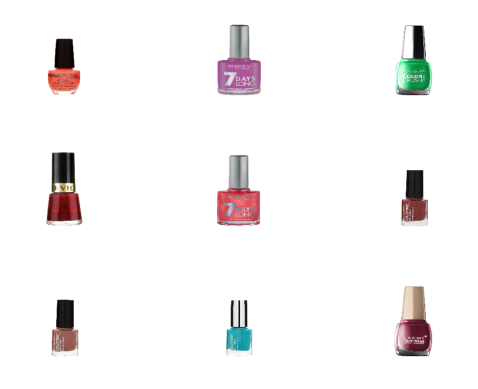

1/1 [==============================] - 0s 23ms/step


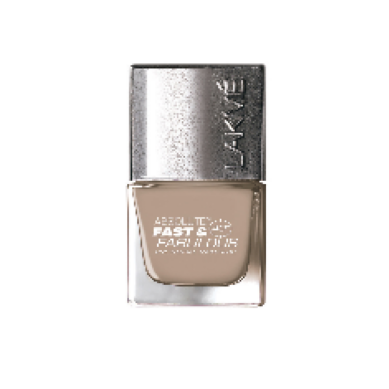

1/1 [==============================] - 0s 24ms/step


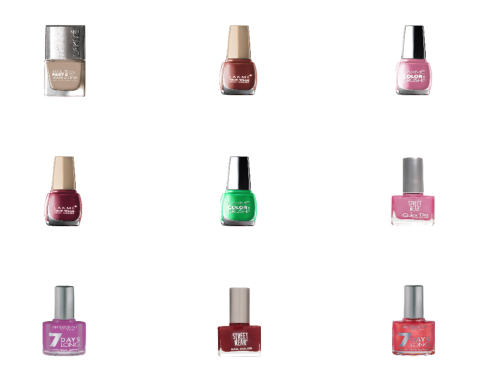

1/1 [==============================] - 0s 38ms/step


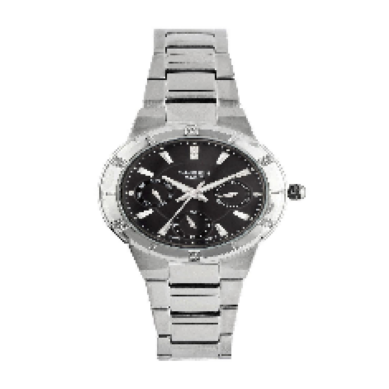

1/1 [==============================] - 0s 23ms/step


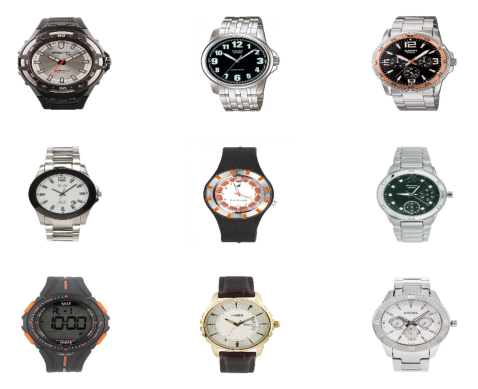

1/1 [==============================] - 0s 22ms/step


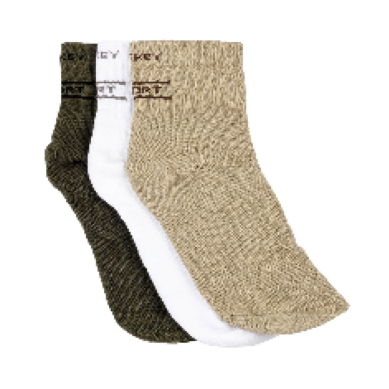

1/1 [==============================] - 0s 21ms/step


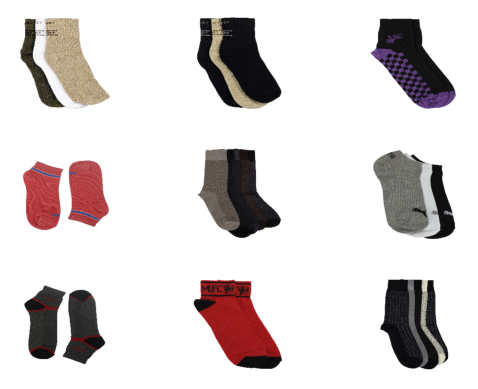

1/1 [==============================] - 0s 23ms/step


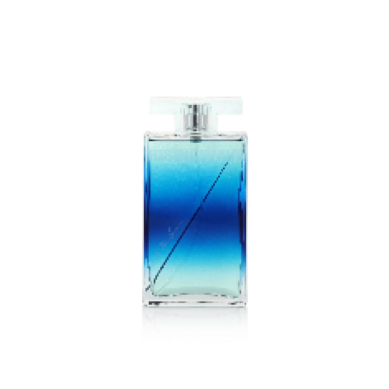

1/1 [==============================] - 0s 24ms/step


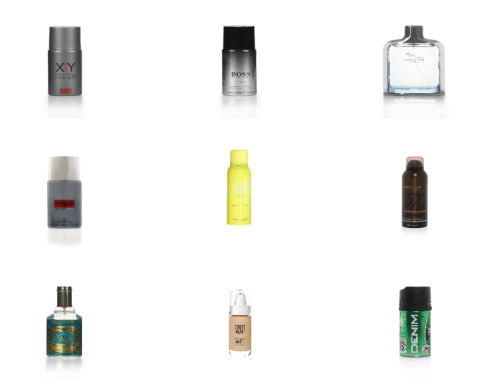

1/1 [==============================] - 0s 23ms/step


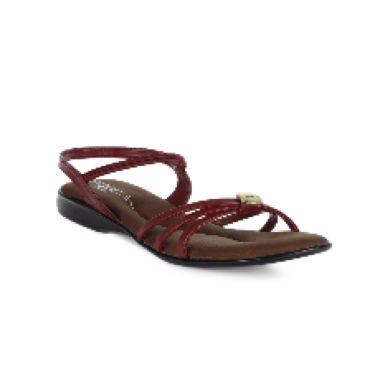

1/1 [==============================] - 0s 24ms/step


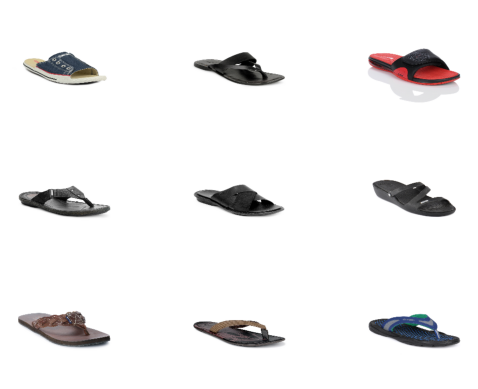

1/1 [==============================] - 0s 23ms/step


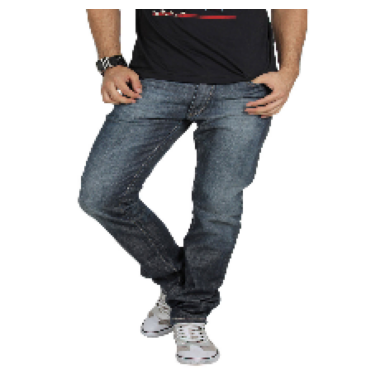

1/1 [==============================] - 0s 22ms/step


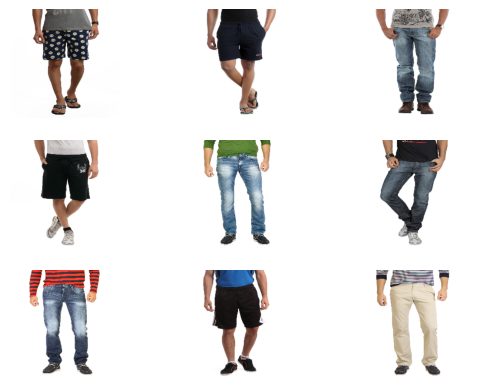

1/1 [==============================] - 0s 22ms/step


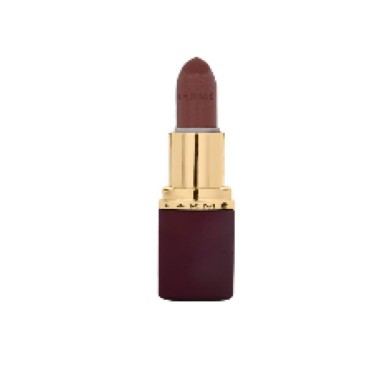

1/1 [==============================] - 0s 23ms/step


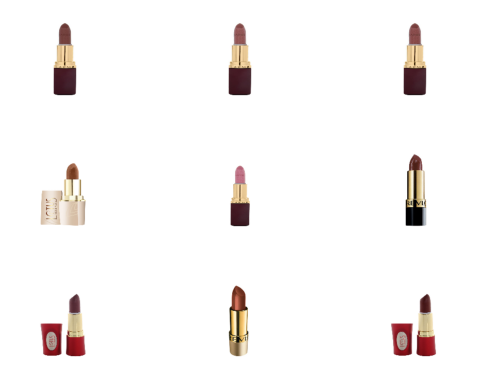

1/1 [==============================] - 0s 23ms/step


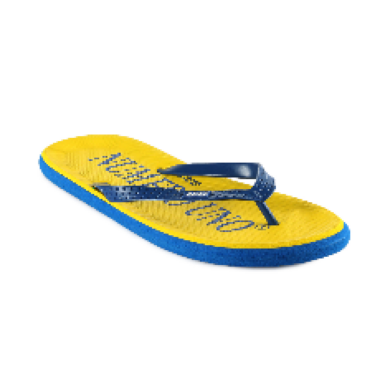

1/1 [==============================] - 0s 32ms/step


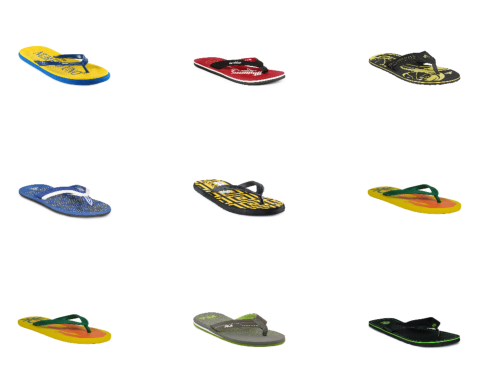

1/1 [==============================] - 0s 35ms/step


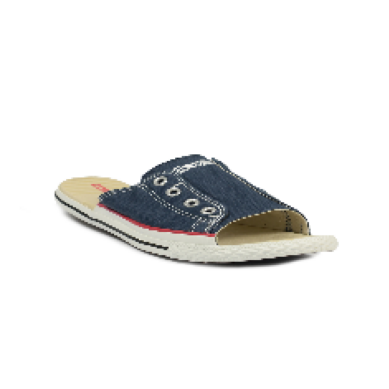

1/1 [==============================] - 0s 23ms/step


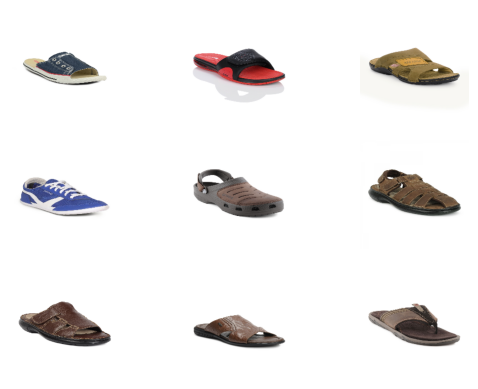

1/1 [==============================] - 0s 22ms/step


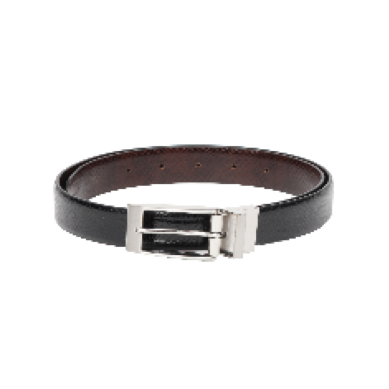

1/1 [==============================] - 0s 23ms/step


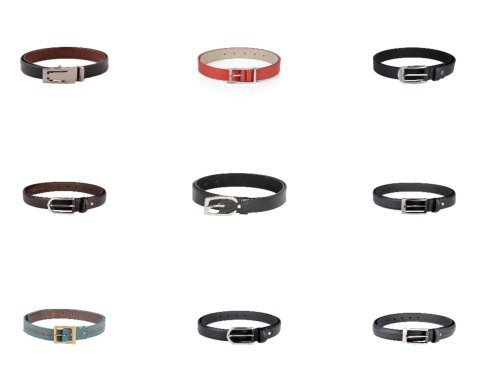

1/1 [==============================] - 0s 22ms/step


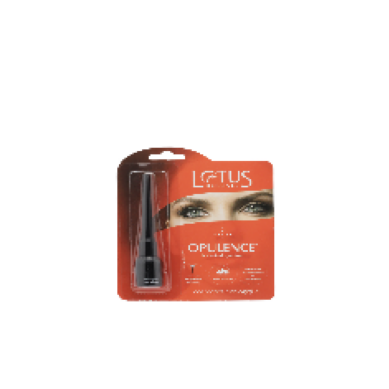

1/1 [==============================] - 0s 24ms/step


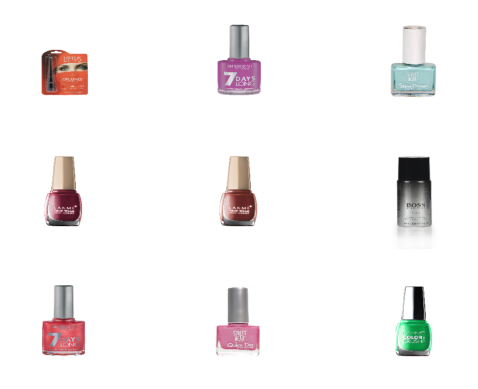

1/1 [==============================] - 0s 41ms/step


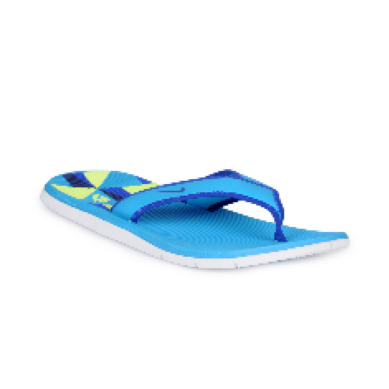

1/1 [==============================] - 0s 24ms/step


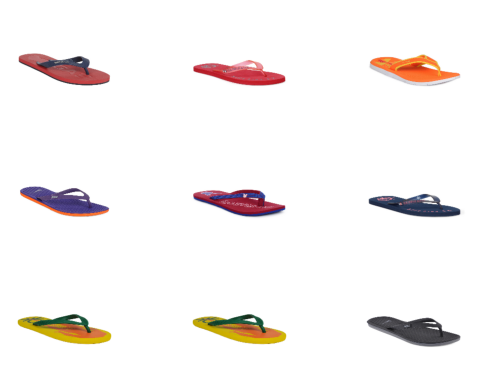

1/1 [==============================] - 0s 25ms/step


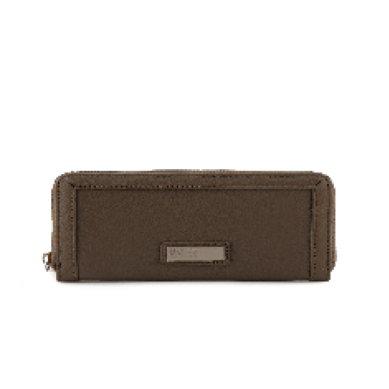

1/1 [==============================] - 0s 24ms/step


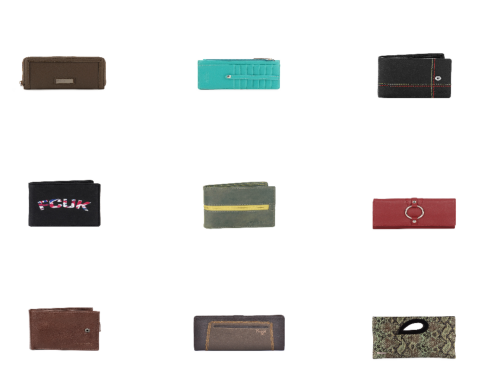

1/1 [==============================] - 0s 22ms/step


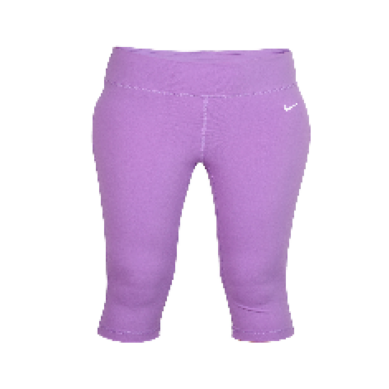

1/1 [==============================] - 0s 22ms/step


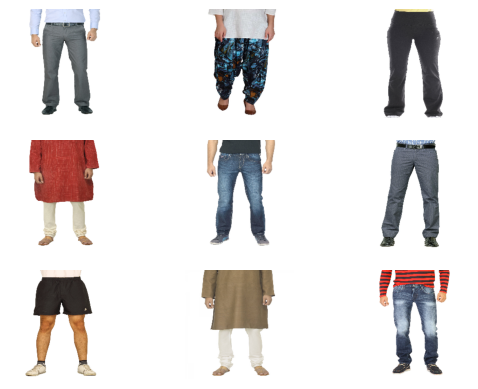

1/1 [==============================] - 0s 22ms/step


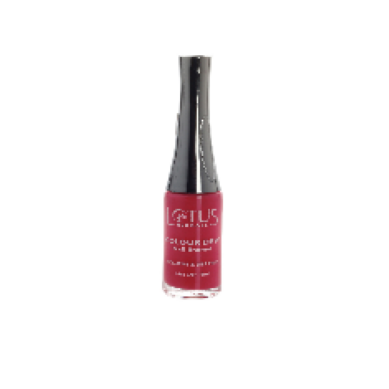

1/1 [==============================] - 0s 23ms/step


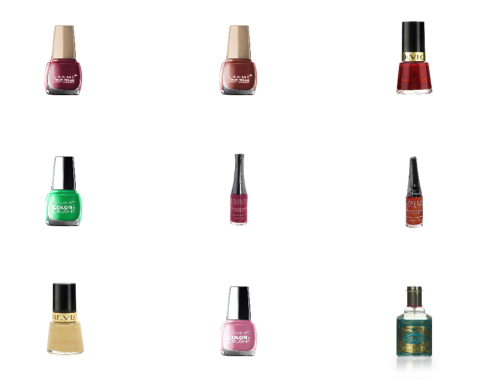

1/1 [==============================] - 0s 22ms/step


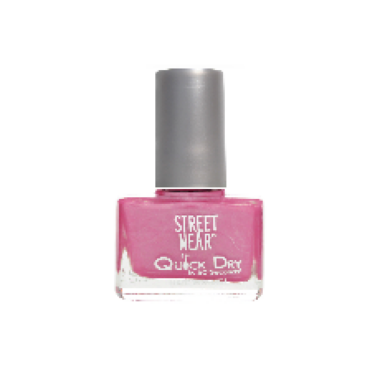

1/1 [==============================] - 0s 22ms/step


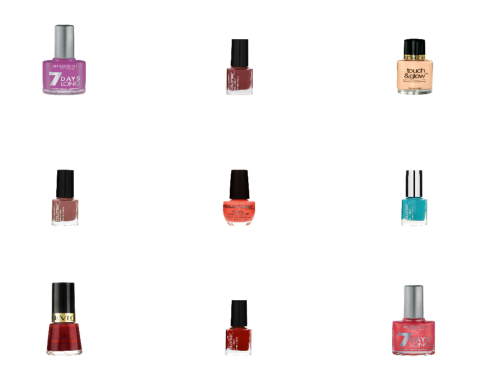

1/1 [==============================] - 0s 23ms/step


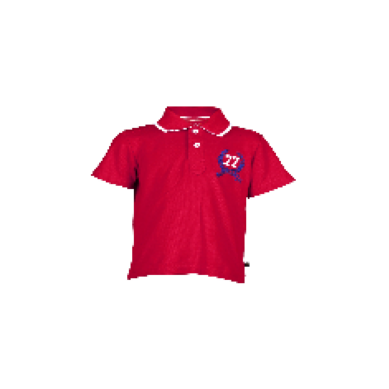

1/1 [==============================] - 0s 22ms/step


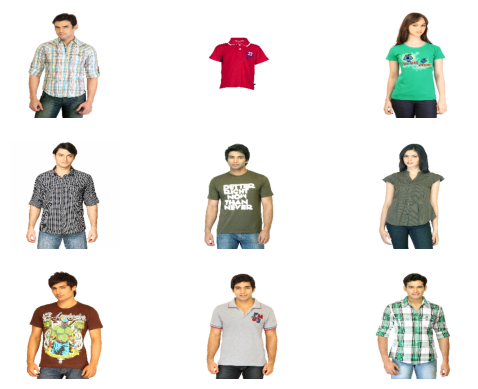

1/1 [==============================] - 0s 22ms/step


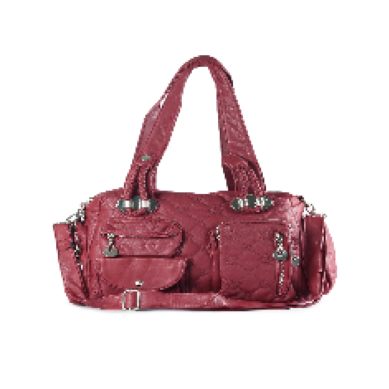

1/1 [==============================] - 0s 25ms/step


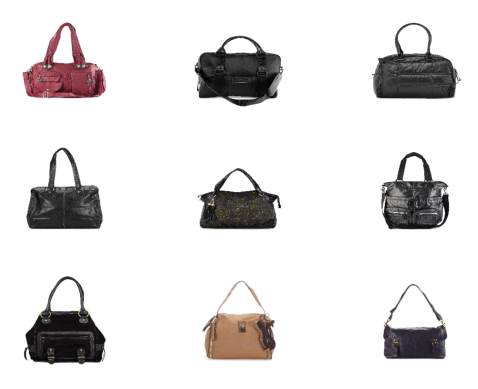

1/1 [==============================] - 0s 24ms/step


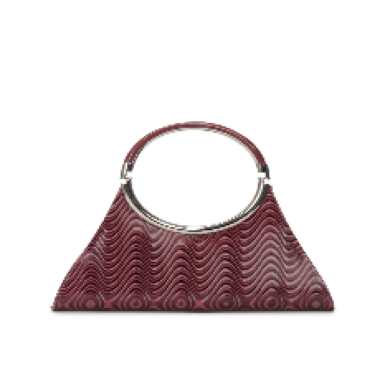

1/1 [==============================] - 0s 24ms/step


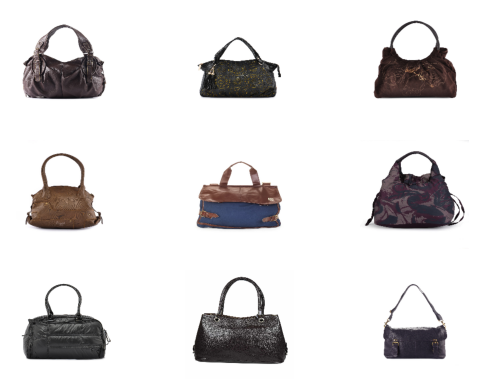

1/1 [==============================] - 0s 24ms/step


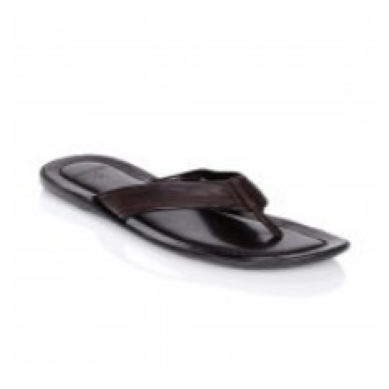

1/1 [==============================] - 0s 22ms/step


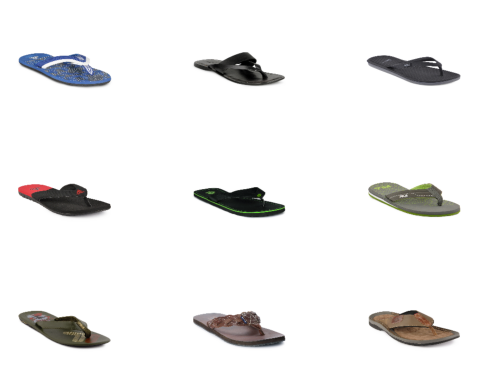

1/1 [==============================] - 0s 34ms/step


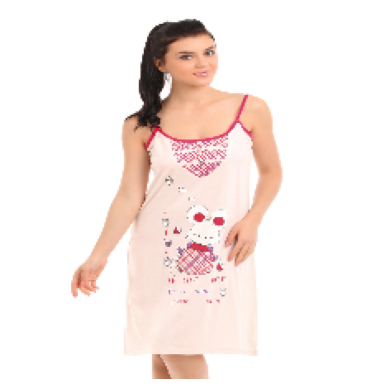

1/1 [==============================] - 0s 31ms/step


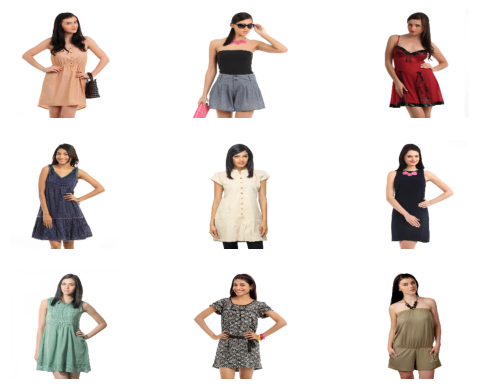

1/1 [==============================] - 0s 42ms/step


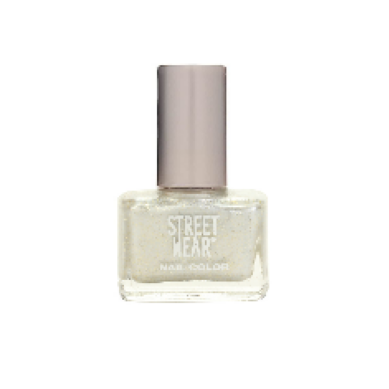

1/1 [==============================] - 0s 25ms/step


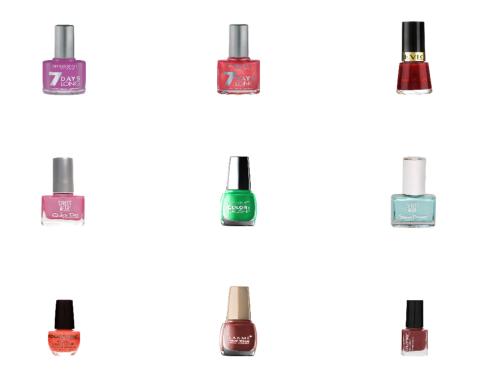

1/1 [==============================] - 0s 23ms/step


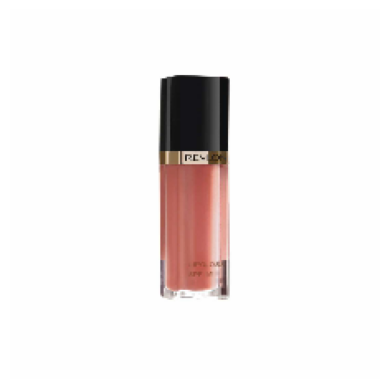

1/1 [==============================] - 0s 23ms/step


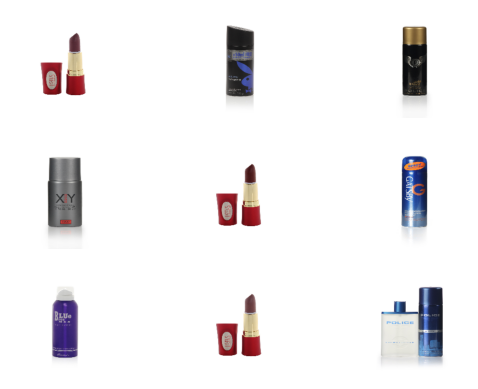

1/1 [==============================] - 0s 22ms/step


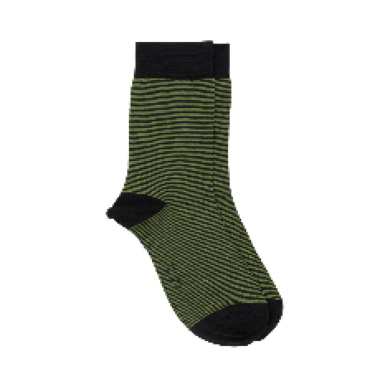

1/1 [==============================] - 0s 23ms/step


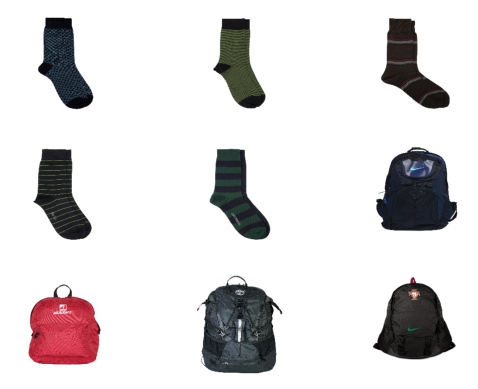

1/1 [==============================] - 0s 22ms/step


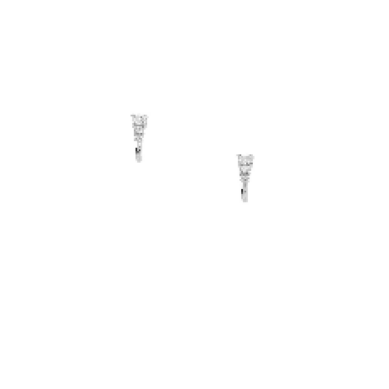

1/1 [==============================] - 0s 26ms/step


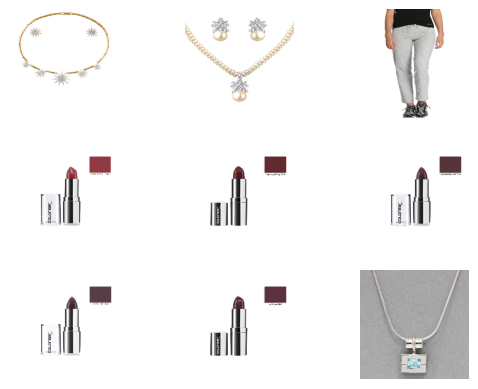

1/1 [==============================] - 0s 25ms/step


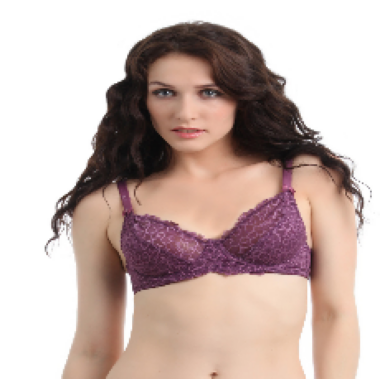

1/1 [==============================] - 0s 25ms/step


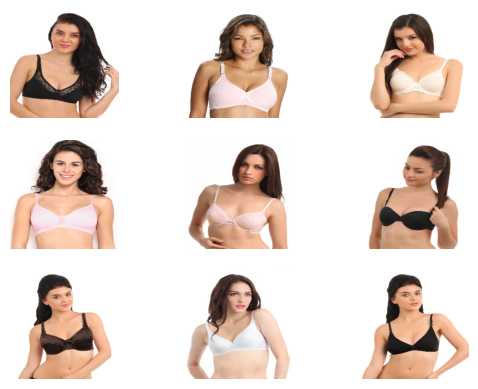

1/1 [==============================] - 0s 22ms/step


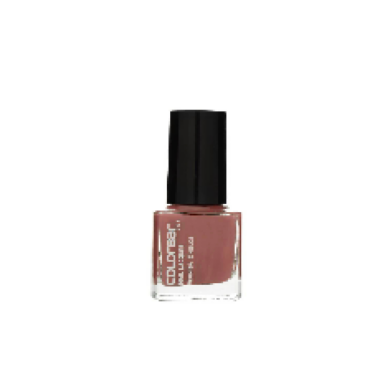

1/1 [==============================] - 0s 24ms/step


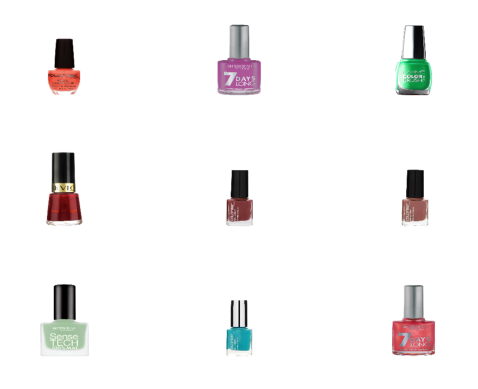

1/1 [==============================] - 0s 22ms/step


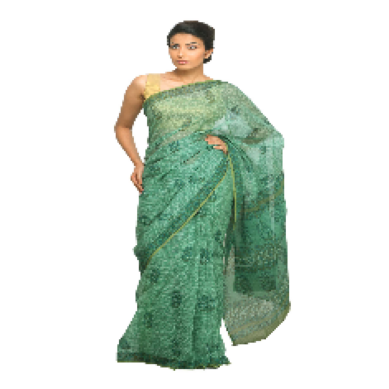

1/1 [==============================] - 0s 23ms/step


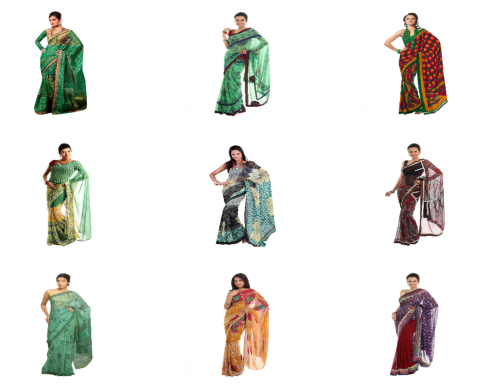

1/1 [==============================] - 0s 31ms/step


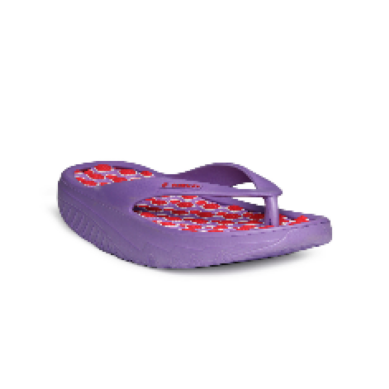

1/1 [==============================] - 0s 23ms/step


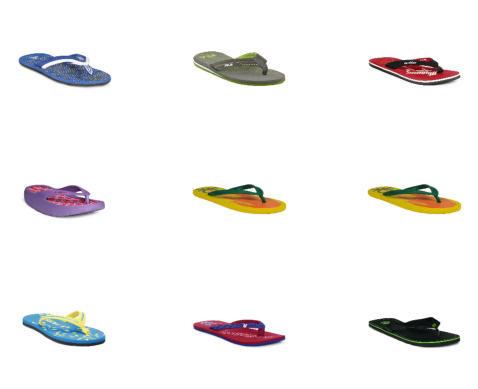

1/1 [==============================] - 0s 22ms/step


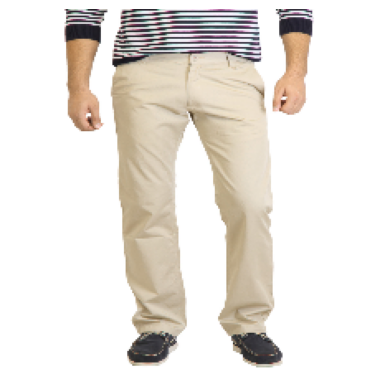

1/1 [==============================] - 0s 22ms/step


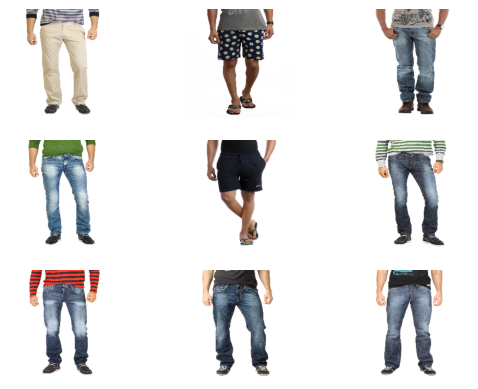

1/1 [==============================] - 0s 22ms/step


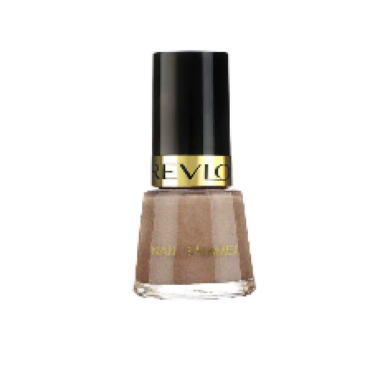

1/1 [==============================] - 0s 24ms/step


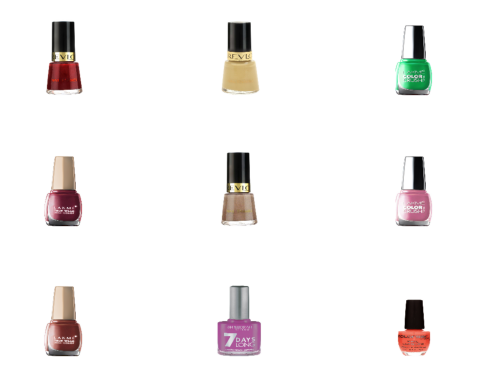

1/1 [==============================] - 0s 22ms/step


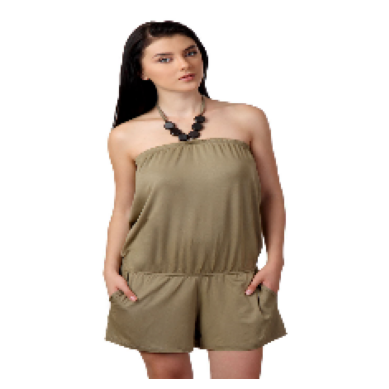

1/1 [==============================] - 0s 24ms/step


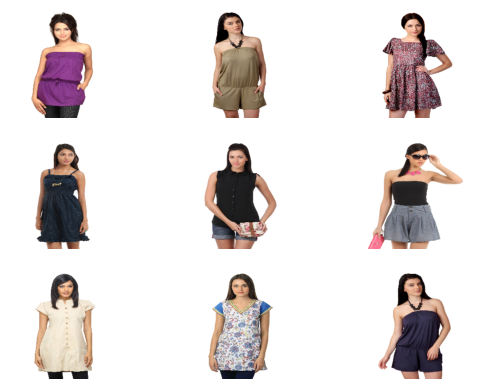

1/1 [==============================] - 0s 23ms/step


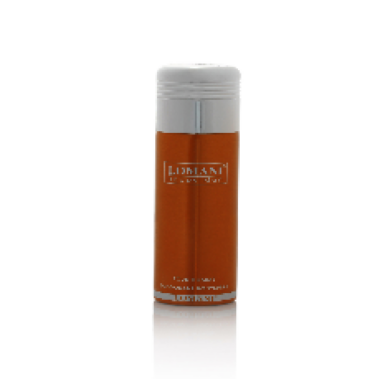

1/1 [==============================] - 0s 24ms/step


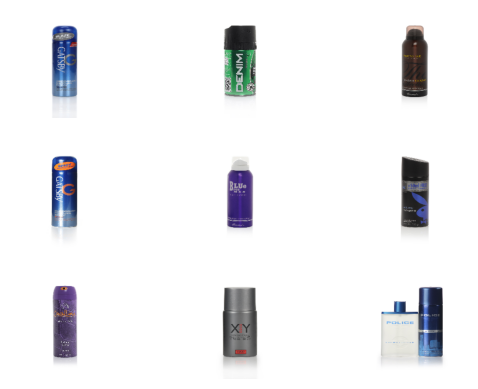

1/1 [==============================] - 0s 22ms/step


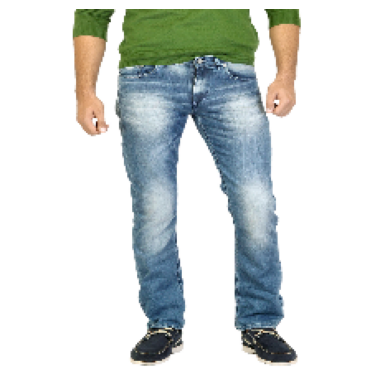

1/1 [==============================] - 0s 23ms/step


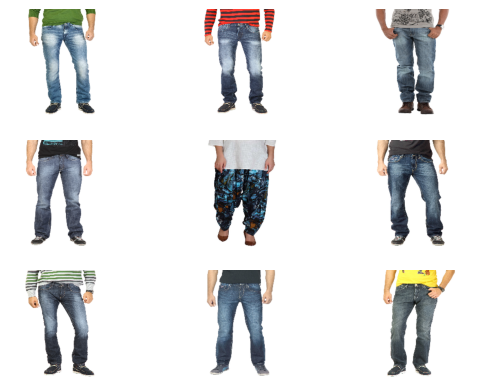

1/1 [==============================] - 0s 22ms/step


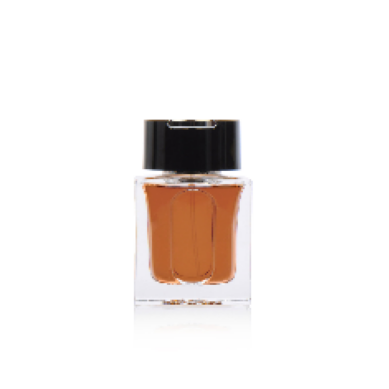

1/1 [==============================] - 0s 23ms/step


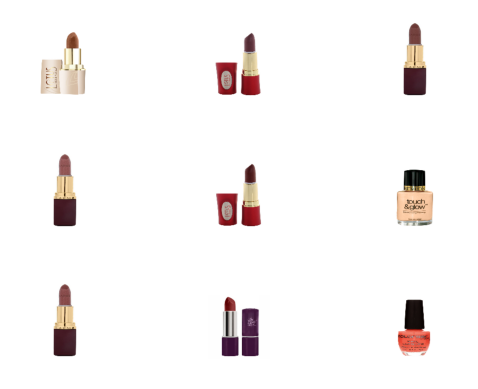

1/1 [==============================] - 0s 23ms/step


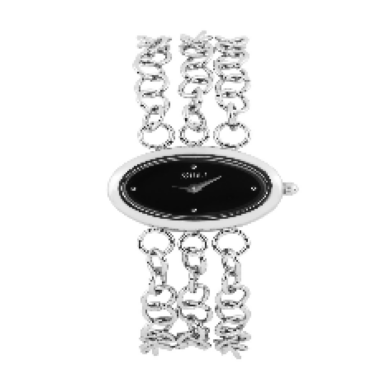

1/1 [==============================] - 0s 24ms/step


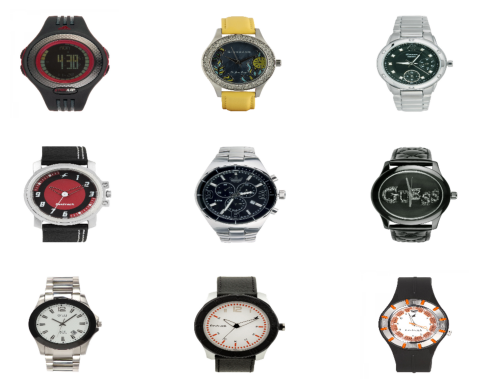

1/1 [==============================] - 0s 51ms/step


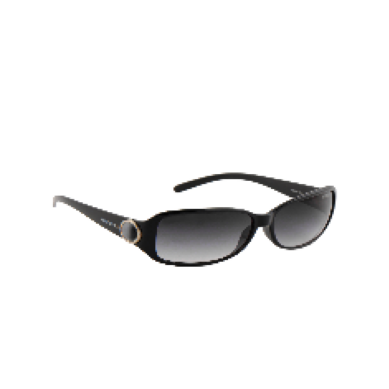

1/1 [==============================] - 0s 35ms/step


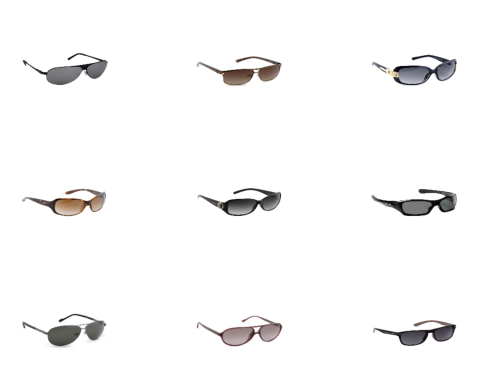

1/1 [==============================] - 0s 23ms/step


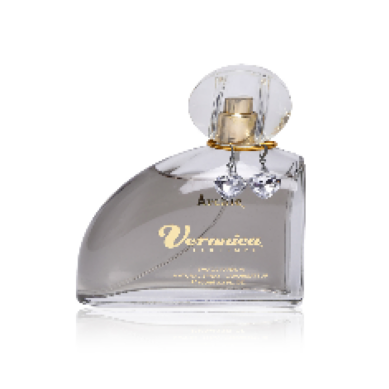

1/1 [==============================] - 0s 22ms/step


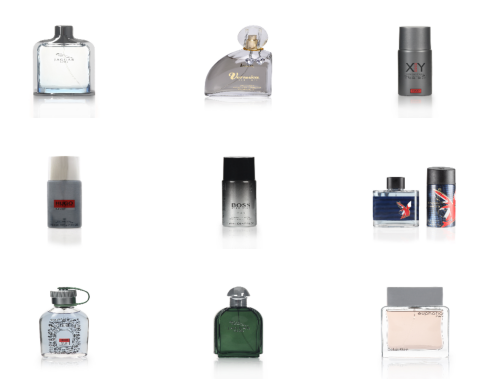

1/1 [==============================] - 0s 22ms/step


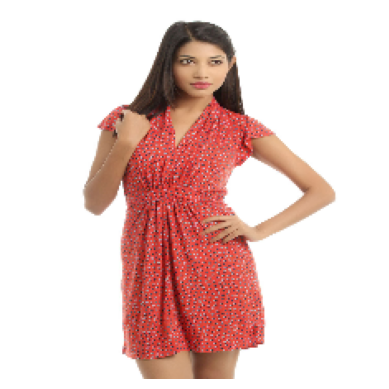

1/1 [==============================] - 0s 22ms/step


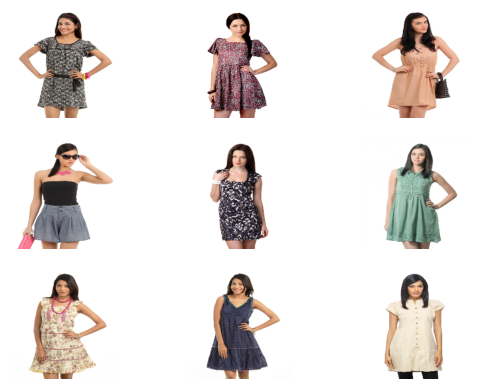

1/1 [==============================] - 0s 23ms/step


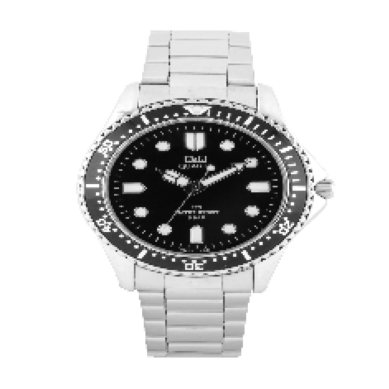

1/1 [==============================] - 0s 25ms/step


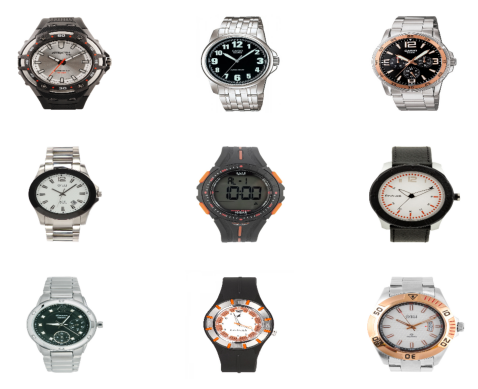

1/1 [==============================] - 0s 23ms/step


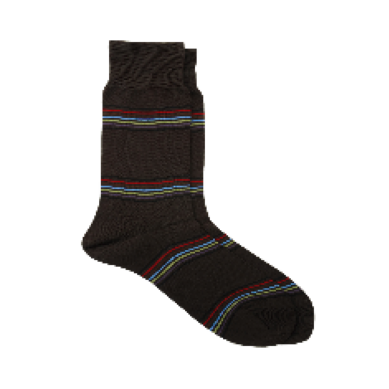

1/1 [==============================] - 0s 23ms/step


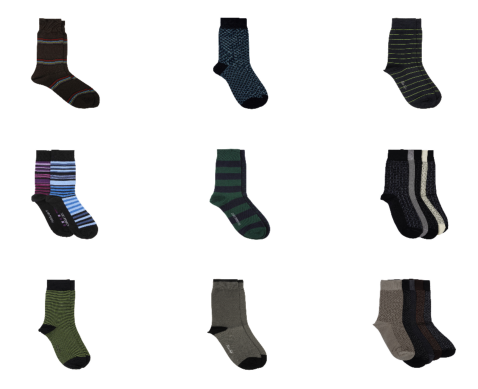

1/1 [==============================] - 0s 22ms/step


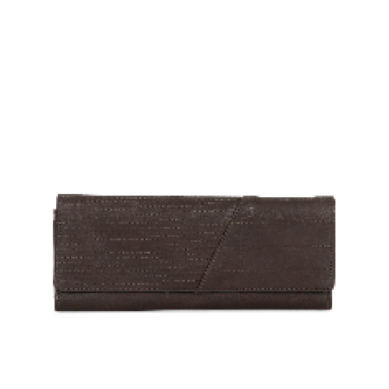

1/1 [==============================] - 0s 22ms/step


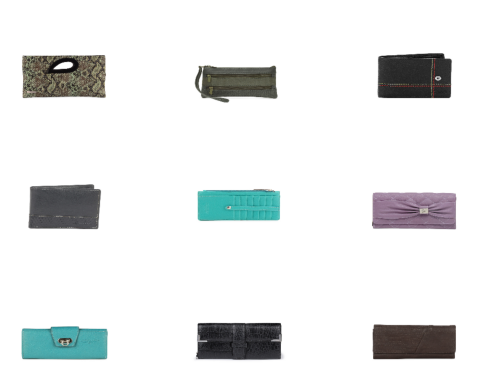

1/1 [==============================] - 0s 23ms/step


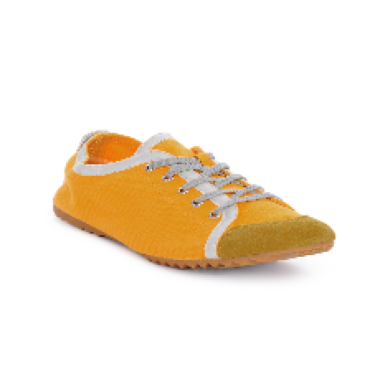

1/1 [==============================] - 0s 24ms/step


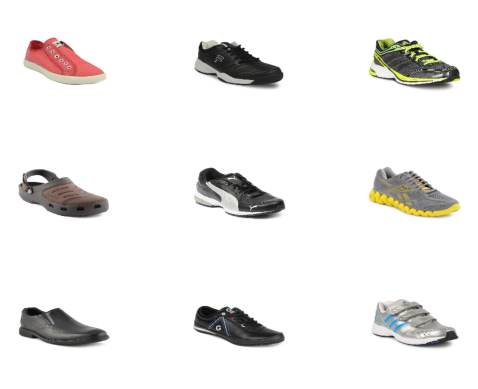

1/1 [==============================] - 0s 21ms/step


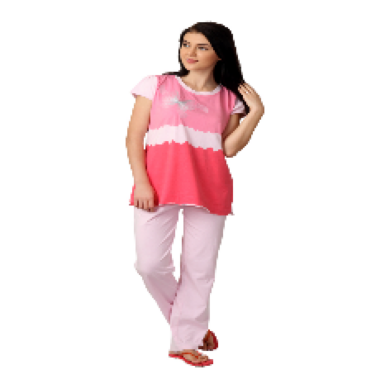

1/1 [==============================] - 0s 23ms/step


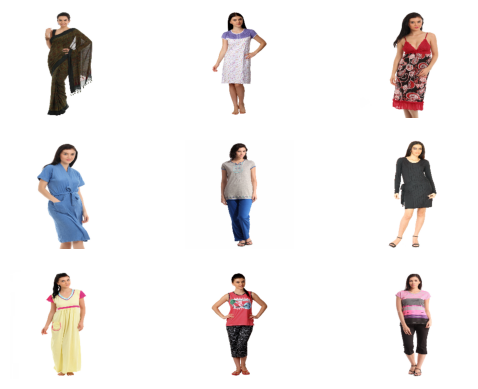

1/1 [==============================] - 0s 22ms/step


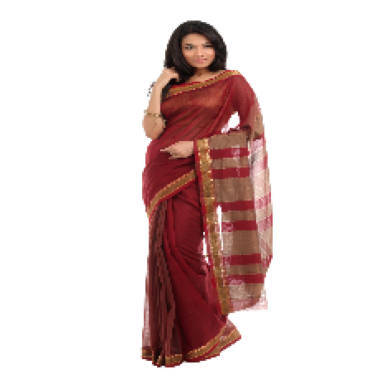

1/1 [==============================] - 0s 23ms/step


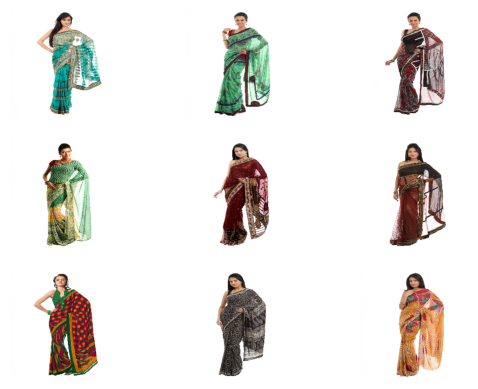

1/1 [==============================] - 0s 22ms/step


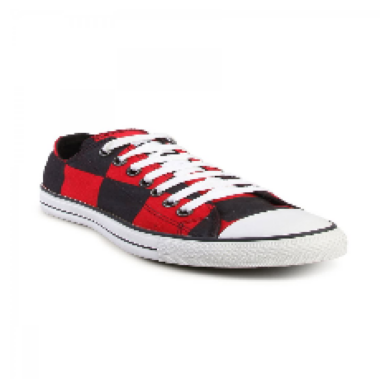

1/1 [==============================] - 0s 22ms/step


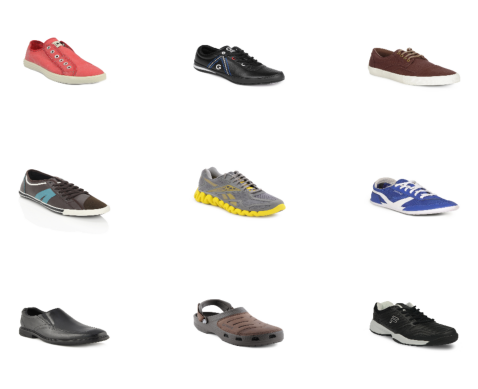

1/1 [==============================] - 0s 22ms/step


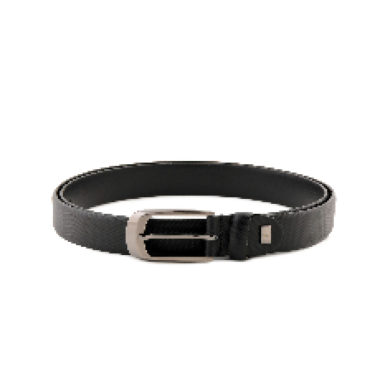

1/1 [==============================] - 0s 24ms/step


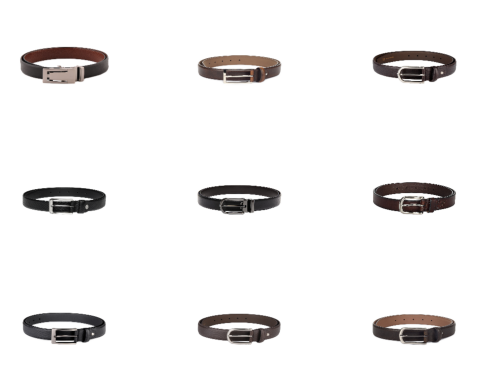

1/1 [==============================] - 0s 23ms/step


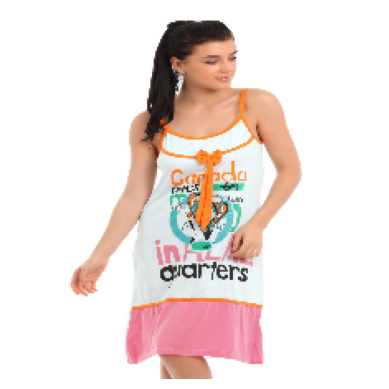

1/1 [==============================] - 0s 23ms/step


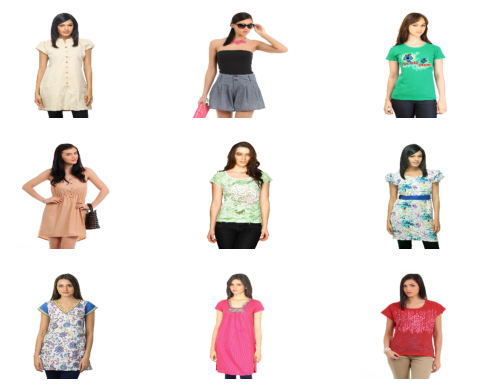

1/1 [==============================] - 0s 22ms/step


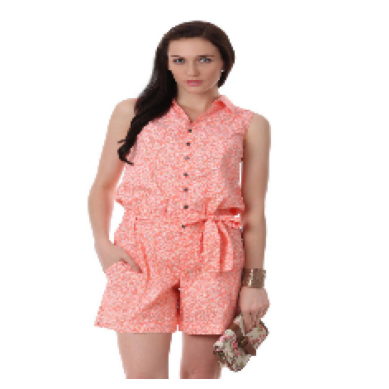

1/1 [==============================] - 0s 23ms/step


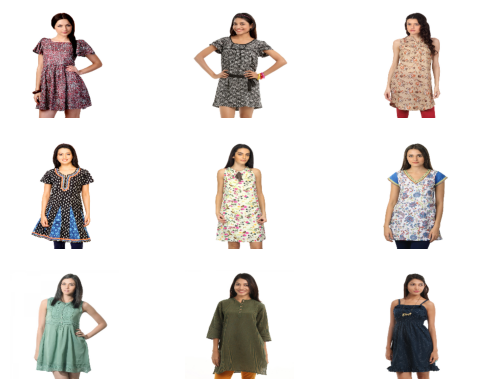

1/1 [==============================] - 0s 23ms/step


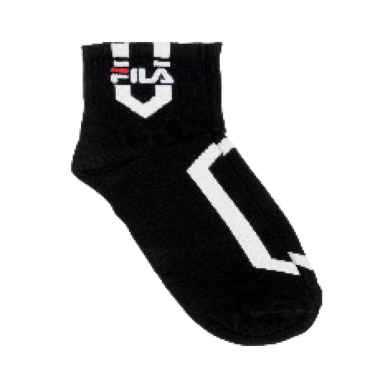

1/1 [==============================] - 0s 25ms/step


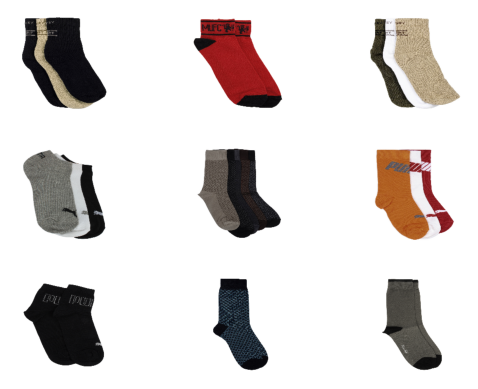

1/1 [==============================] - 0s 22ms/step


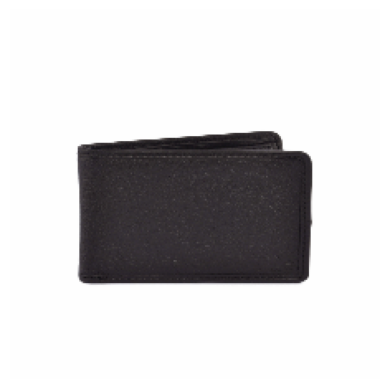

1/1 [==============================] - 0s 24ms/step


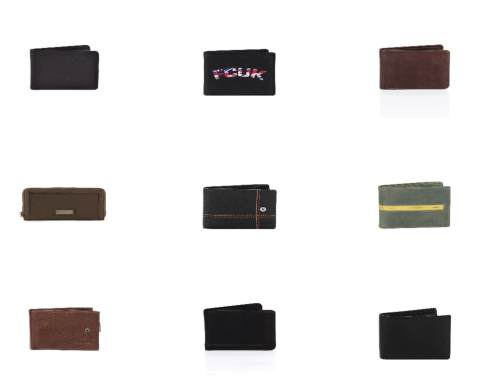

1/1 [==============================] - 0s 22ms/step


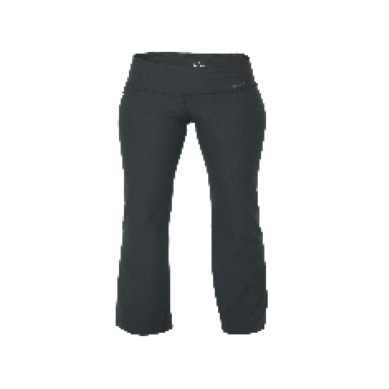

1/1 [==============================] - 0s 21ms/step


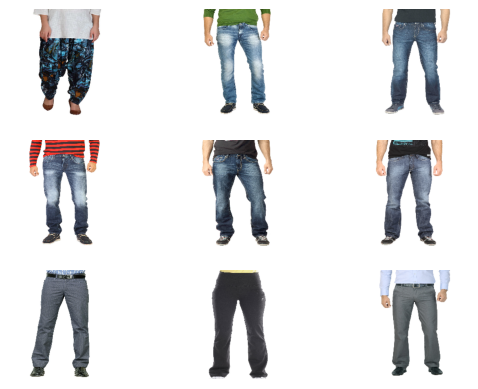

1/1 [==============================] - 0s 24ms/step


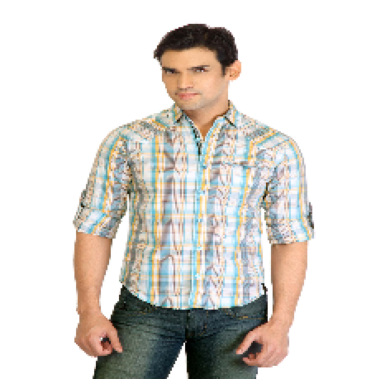

1/1 [==============================] - 0s 22ms/step


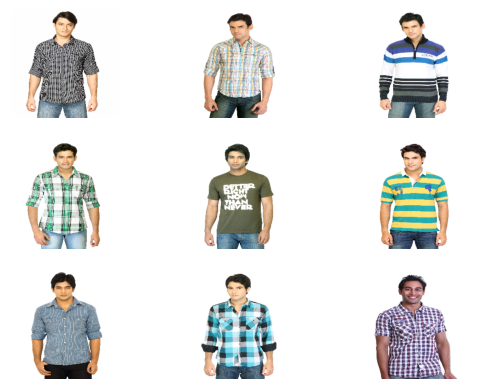

1/1 [==============================] - 0s 22ms/step


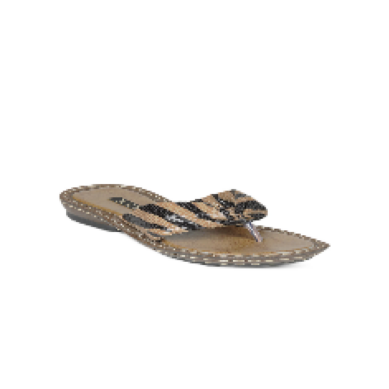

1/1 [==============================] - 0s 25ms/step


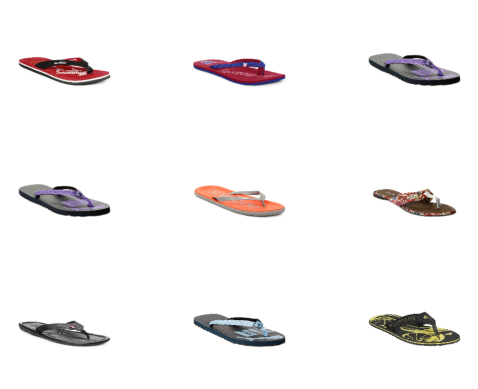

1/1 [==============================] - 0s 24ms/step


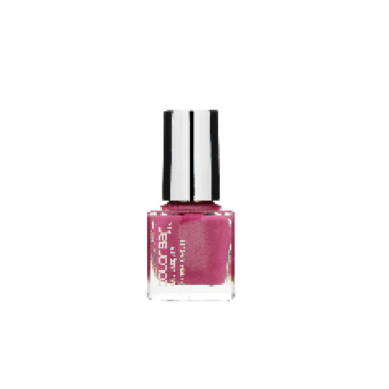

1/1 [==============================] - 0s 26ms/step


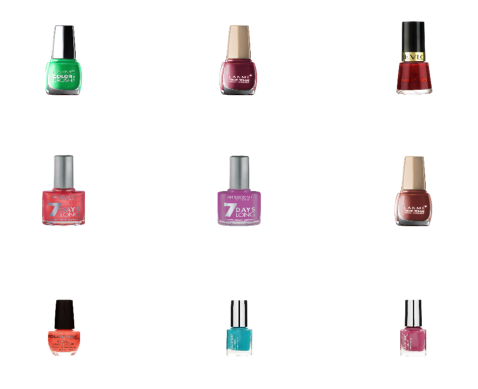

1/1 [==============================] - 0s 29ms/step


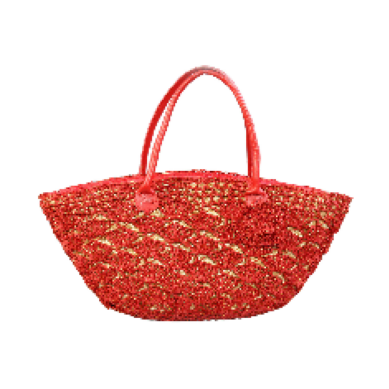

1/1 [==============================] - 0s 24ms/step


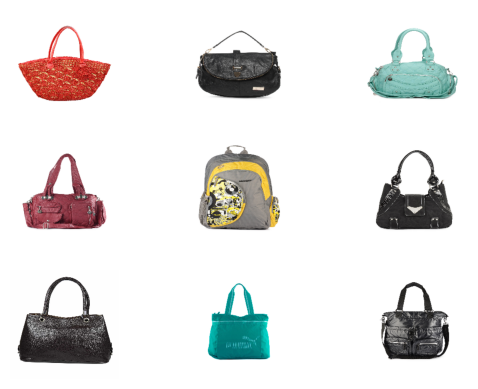

1/1 [==============================] - 0s 24ms/step


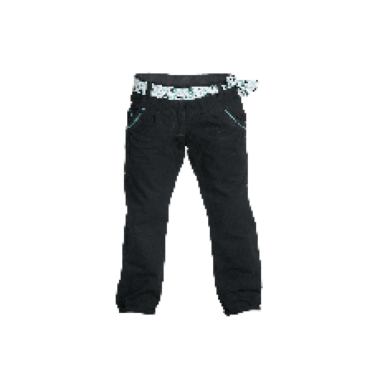

1/1 [==============================] - 0s 22ms/step


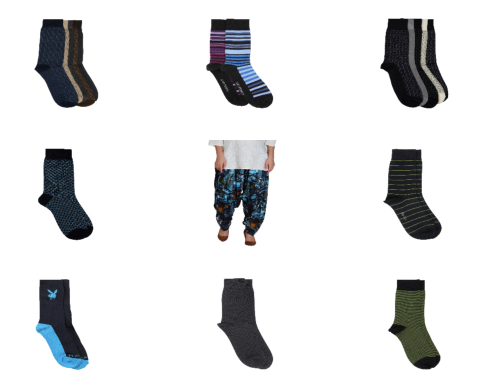

1/1 [==============================] - 0s 23ms/step


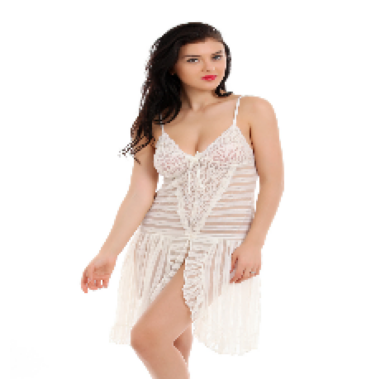

1/1 [==============================] - 0s 23ms/step


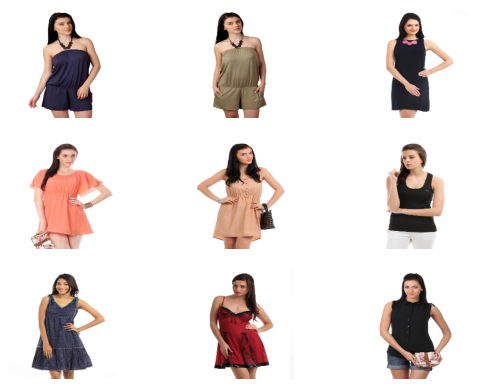

1/1 [==============================] - 0s 22ms/step


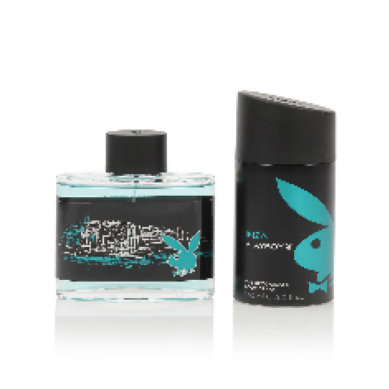

1/1 [==============================] - 0s 22ms/step


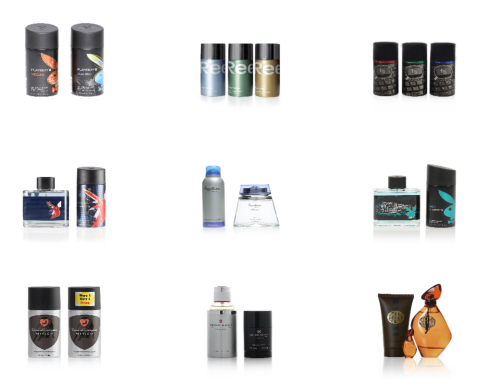

1/1 [==============================] - 0s 23ms/step


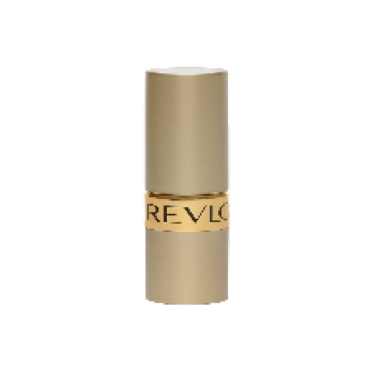

1/1 [==============================] - 0s 24ms/step


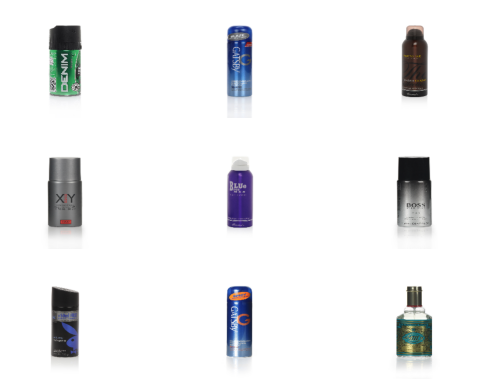

1/1 [==============================] - 0s 21ms/step


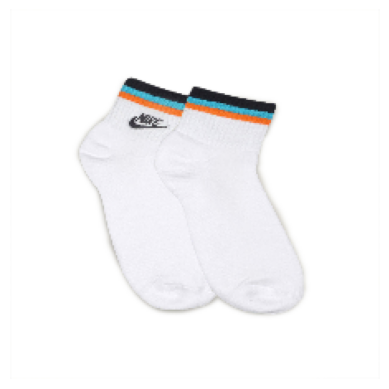

1/1 [==============================] - 0s 25ms/step


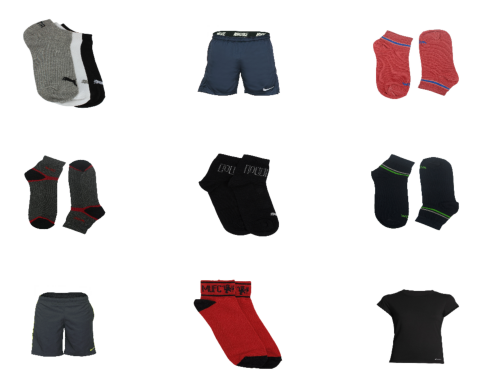

1/1 [==============================] - 0s 24ms/step


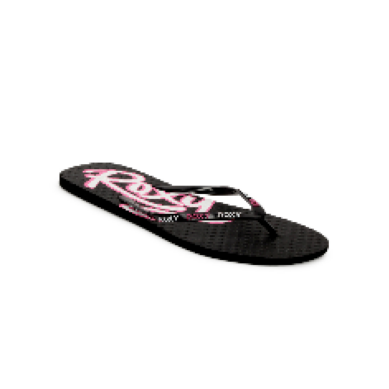

1/1 [==============================] - 0s 39ms/step


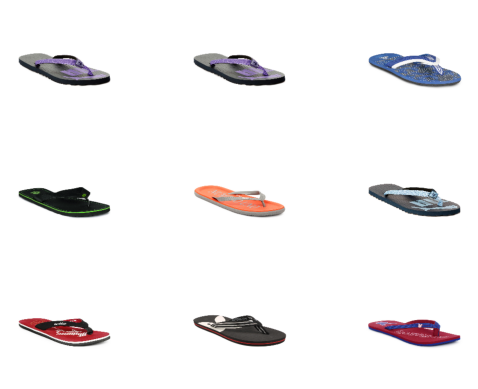

1/1 [==============================] - 0s 23ms/step


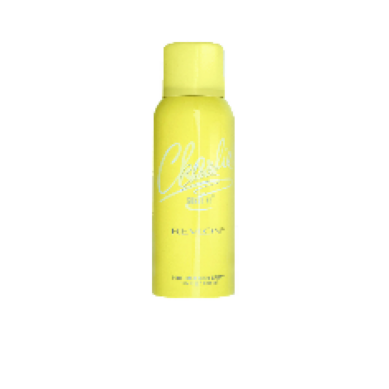

1/1 [==============================] - 0s 22ms/step


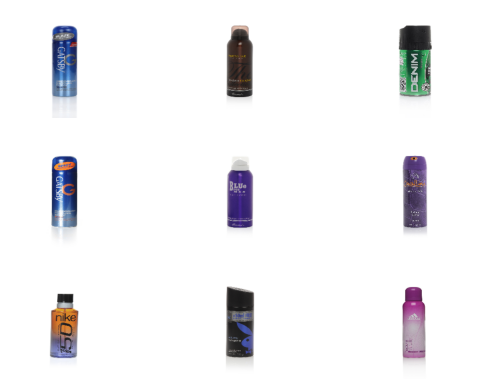

1/1 [==============================] - 0s 23ms/step


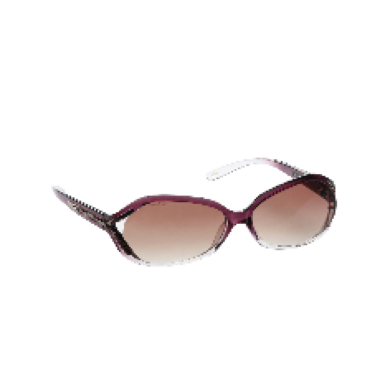

1/1 [==============================] - 0s 23ms/step


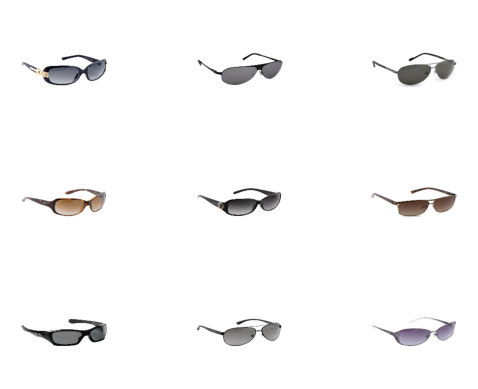

1/1 [==============================] - 0s 24ms/step


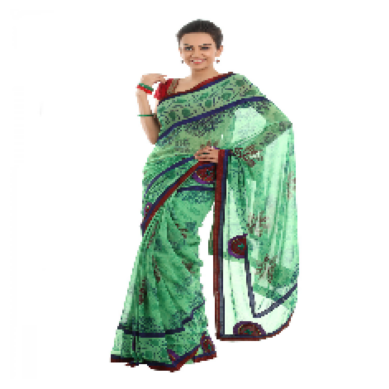

1/1 [==============================] - 0s 21ms/step


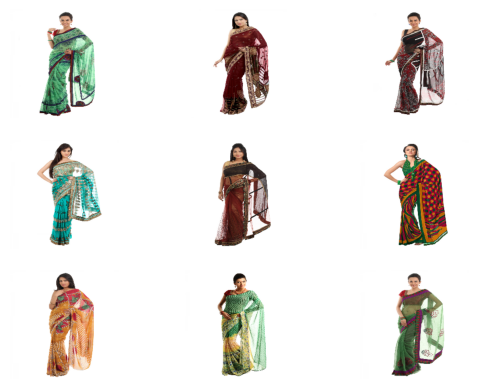

1/1 [==============================] - 0s 33ms/step


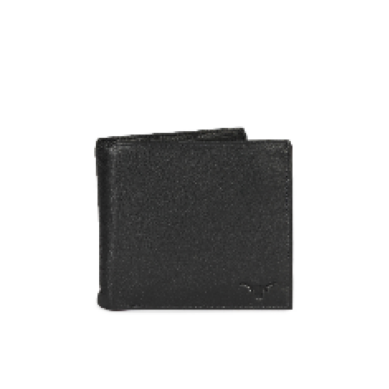

1/1 [==============================] - 0s 39ms/step


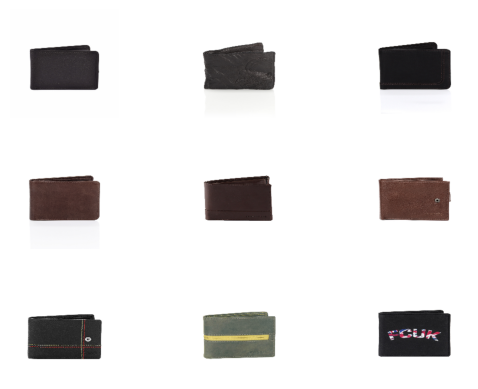

1/1 [==============================] - 0s 22ms/step


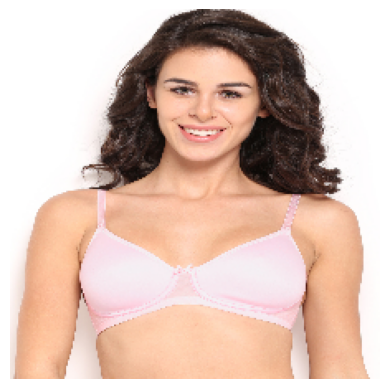

1/1 [==============================] - 0s 22ms/step


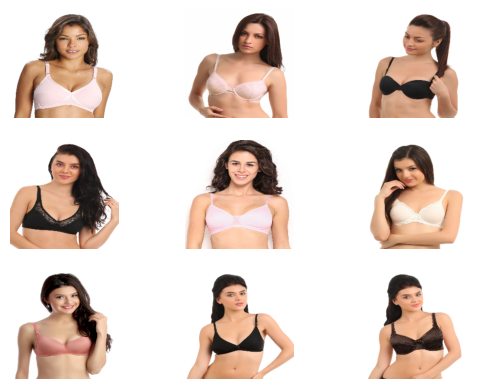

1/1 [==============================] - 0s 22ms/step


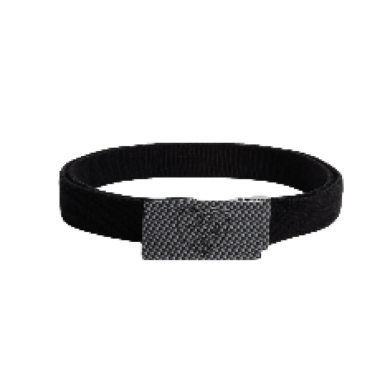

1/1 [==============================] - 0s 25ms/step


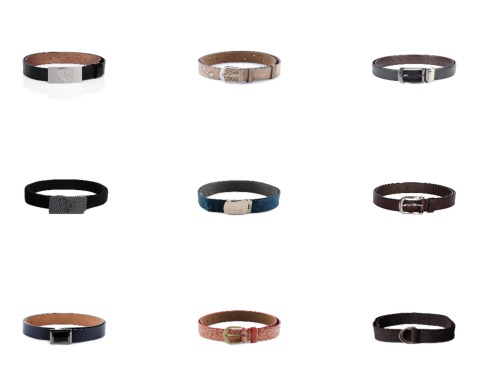

1/1 [==============================] - 0s 24ms/step


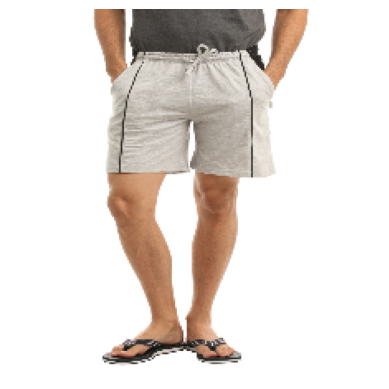

1/1 [==============================] - 0s 23ms/step


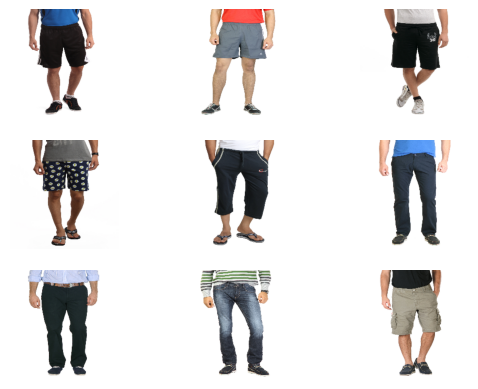

1/1 [==============================] - 0s 22ms/step


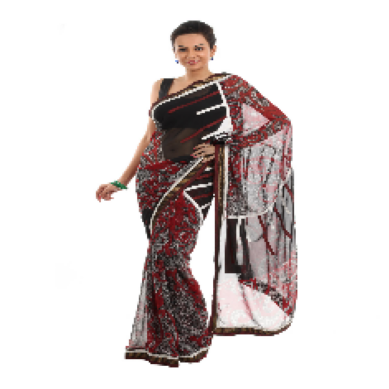

1/1 [==============================] - 0s 22ms/step


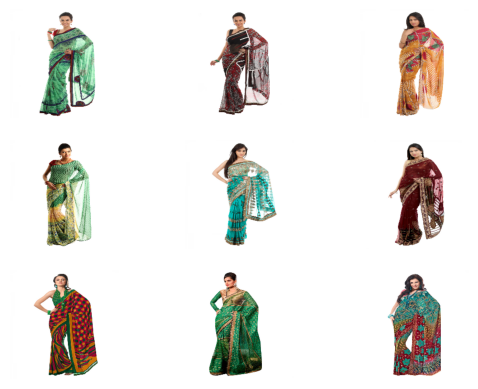

1/1 [==============================] - 0s 22ms/step


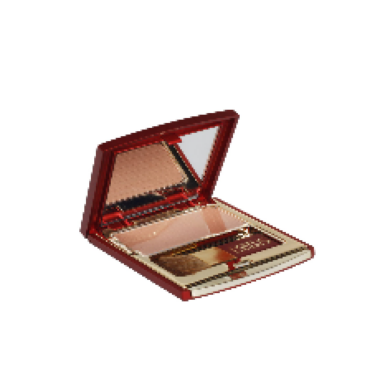

1/1 [==============================] - 0s 22ms/step


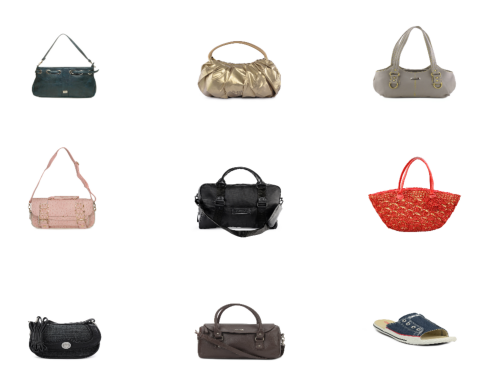

1/1 [==============================] - 0s 22ms/step


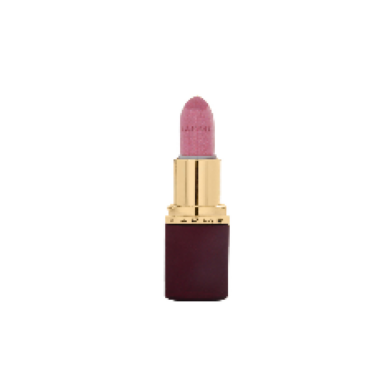

1/1 [==============================] - 0s 25ms/step


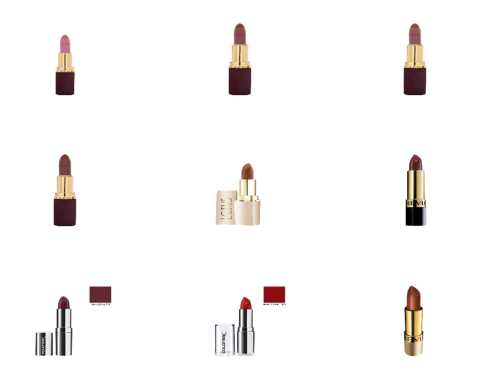

1/1 [==============================] - 0s 22ms/step


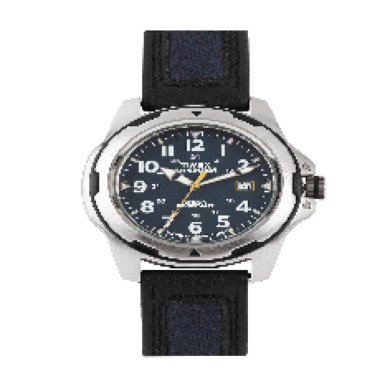

1/1 [==============================] - 0s 22ms/step


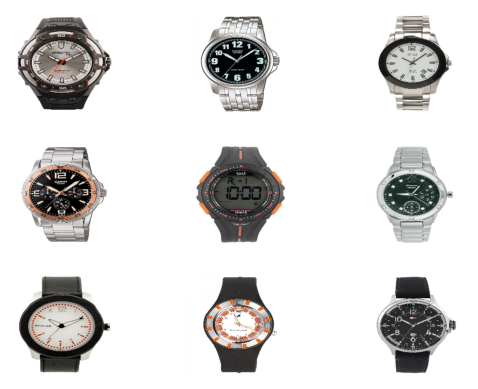

1/1 [==============================] - 0s 23ms/step


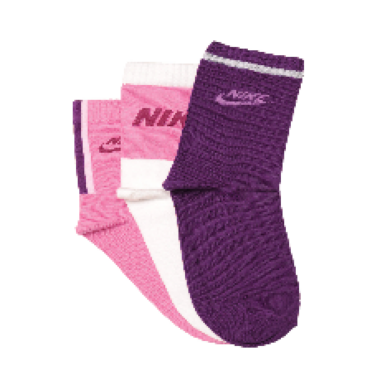

1/1 [==============================] - 0s 22ms/step


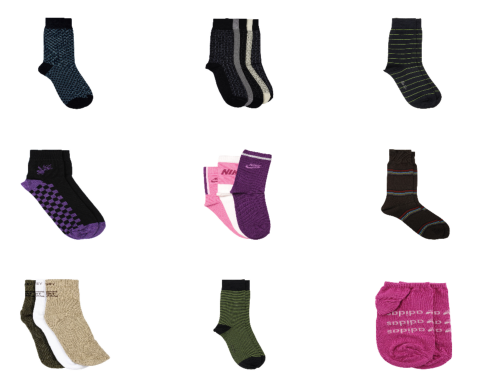

1/1 [==============================] - 0s 22ms/step


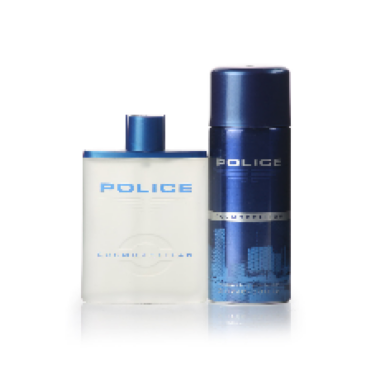

1/1 [==============================] - 0s 22ms/step


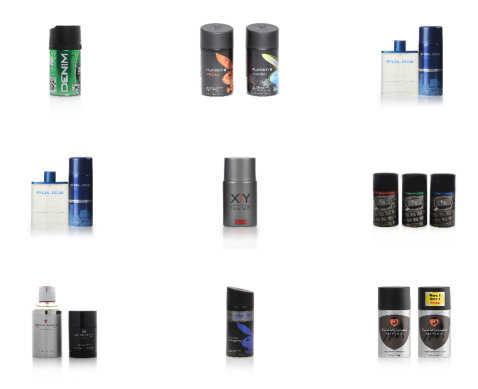

1/1 [==============================] - 0s 26ms/step


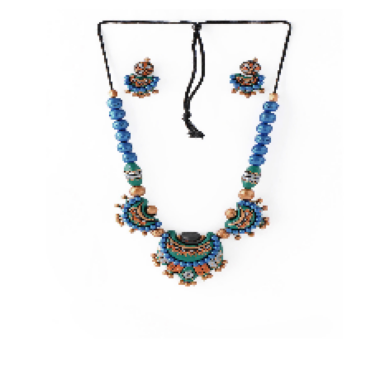

1/1 [==============================] - 0s 23ms/step


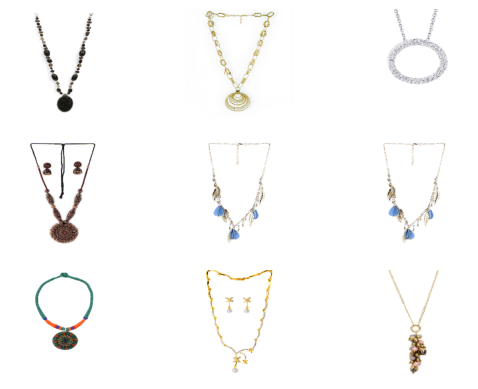

1/1 [==============================] - 0s 24ms/step


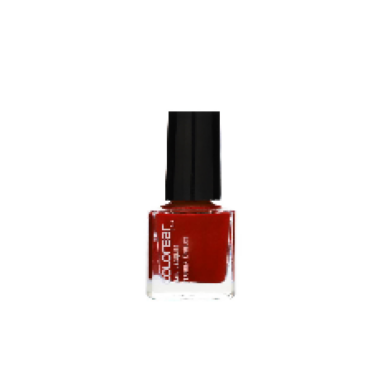

1/1 [==============================] - 0s 22ms/step


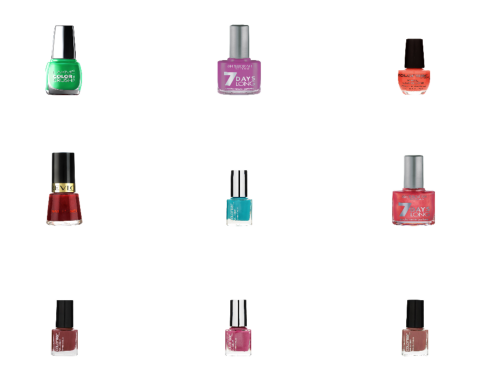

1/1 [==============================] - 0s 34ms/step


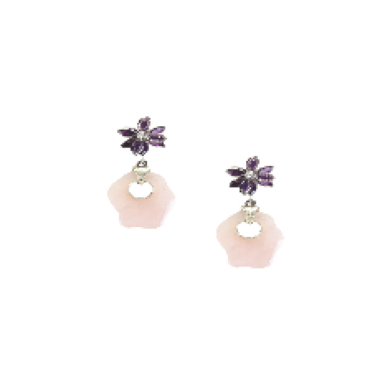

1/1 [==============================] - 0s 30ms/step


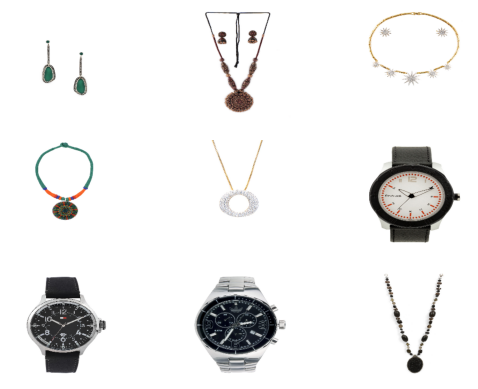

1/1 [==============================] - 0s 22ms/step


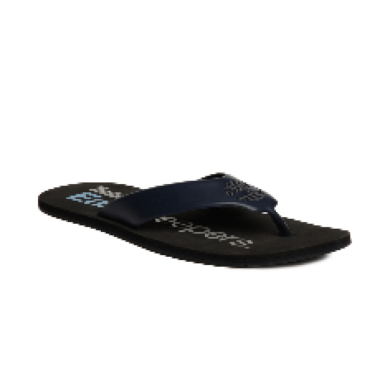

1/1 [==============================] - 0s 28ms/step


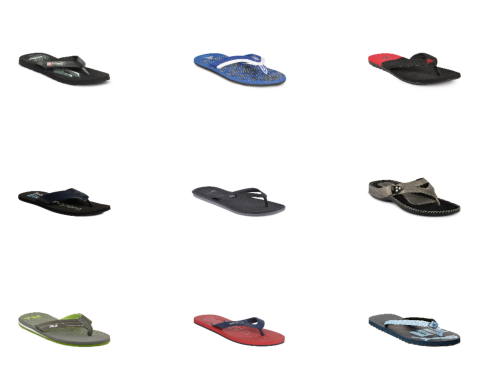

1/1 [==============================] - 0s 21ms/step


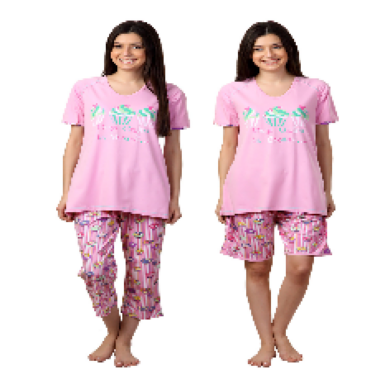

1/1 [==============================] - 0s 22ms/step


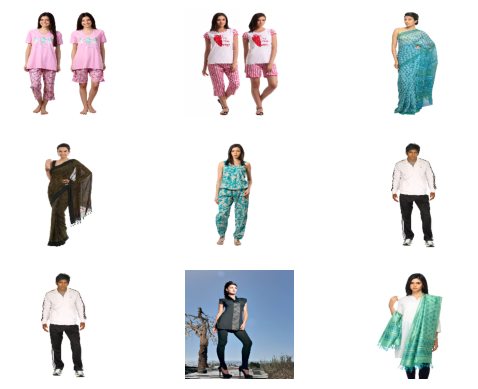

1/1 [==============================] - 0s 22ms/step


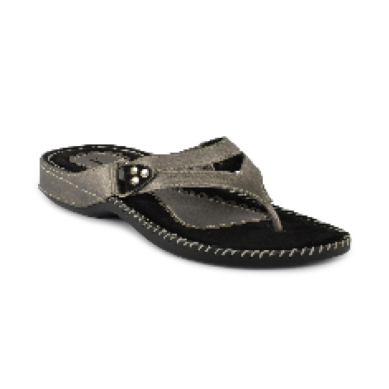

1/1 [==============================] - 0s 22ms/step


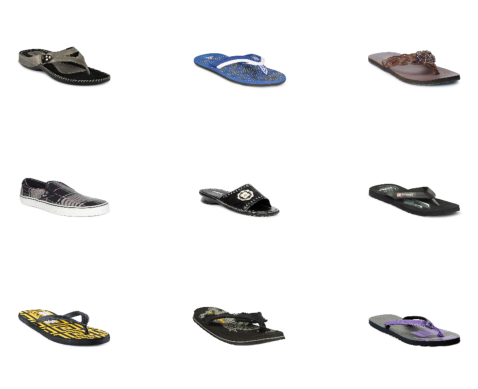

1/1 [==============================] - 0s 21ms/step


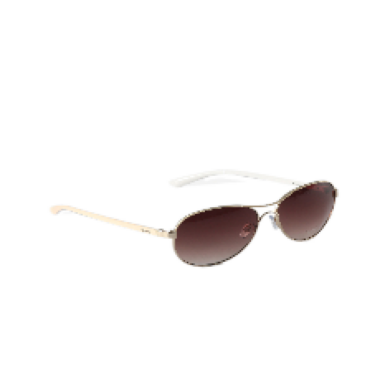

1/1 [==============================] - 0s 25ms/step


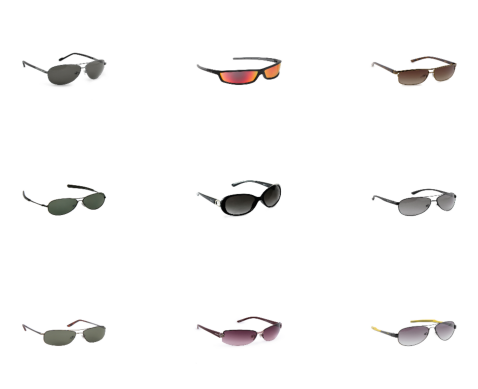

1/1 [==============================] - 0s 21ms/step


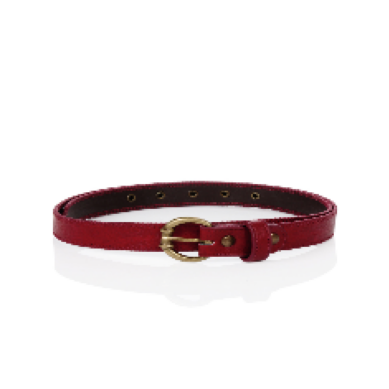

1/1 [==============================] - 0s 23ms/step


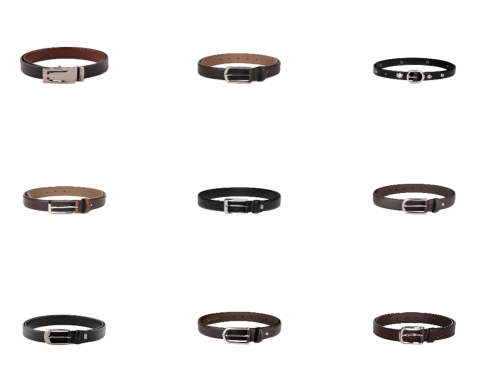

1/1 [==============================] - 0s 25ms/step


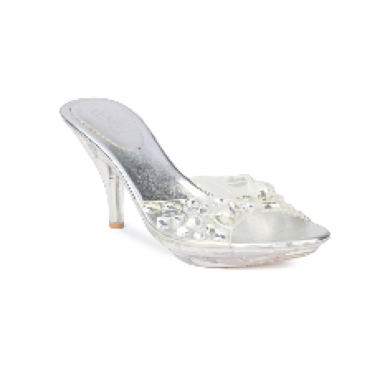

1/1 [==============================] - 0s 23ms/step


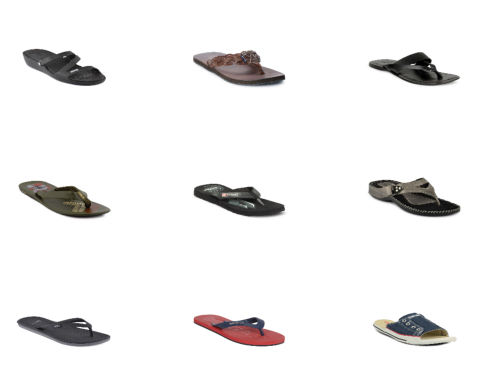

1/1 [==============================] - 0s 22ms/step


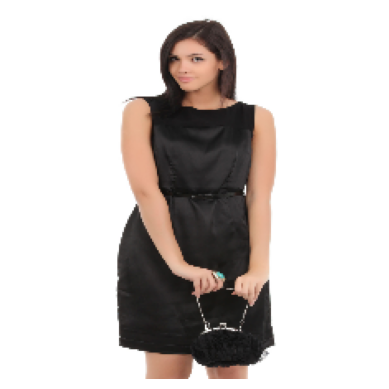

1/1 [==============================] - 0s 25ms/step


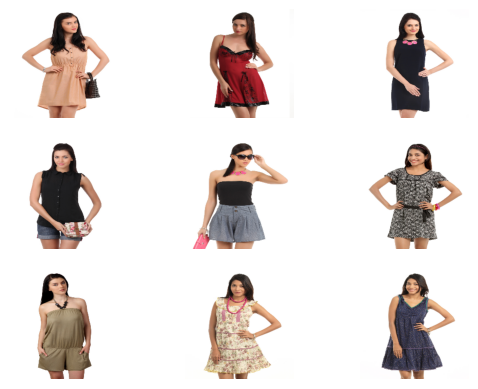

1/1 [==============================] - 0s 22ms/step


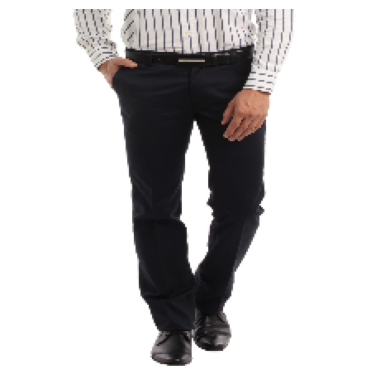

1/1 [==============================] - 0s 21ms/step


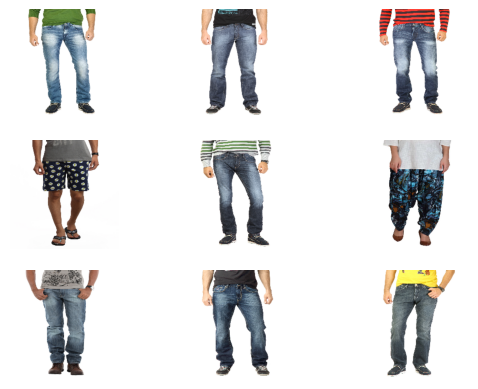

1/1 [==============================] - 0s 22ms/step


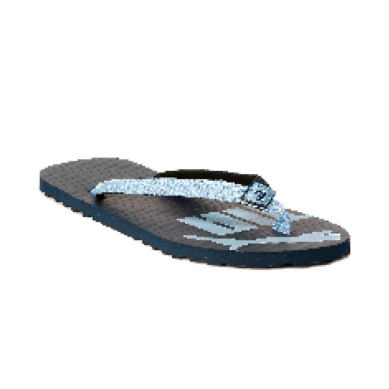

1/1 [==============================] - 0s 23ms/step


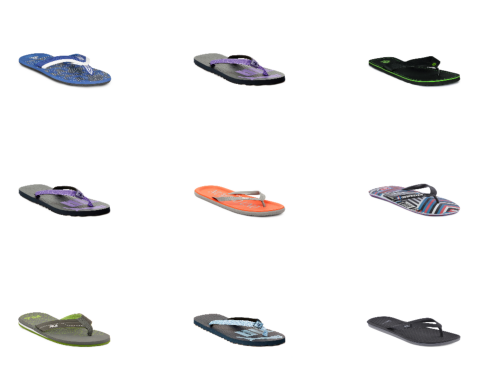

1/1 [==============================] - 0s 23ms/step


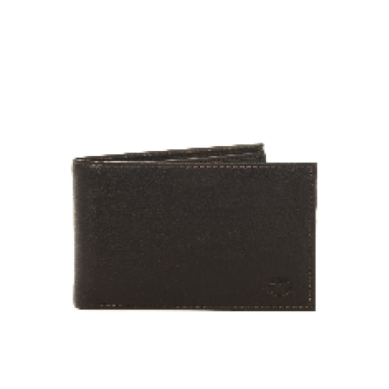

1/1 [==============================] - 0s 23ms/step


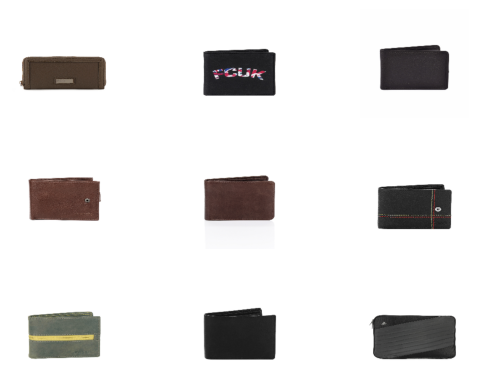

1/1 [==============================] - 0s 22ms/step


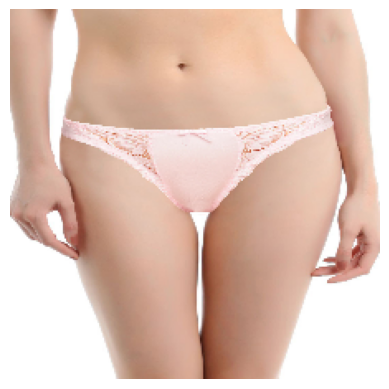

1/1 [==============================] - 0s 22ms/step


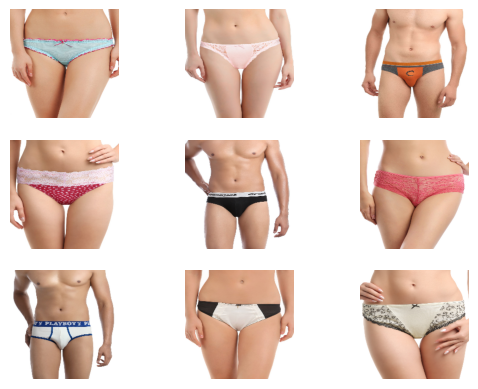

1/1 [==============================] - 0s 22ms/step


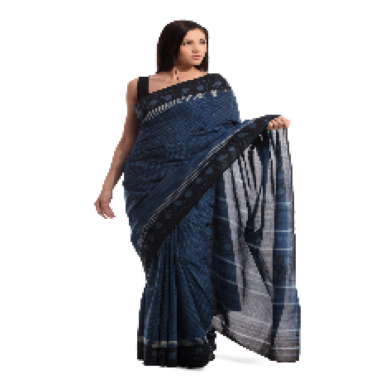

1/1 [==============================] - 0s 26ms/step


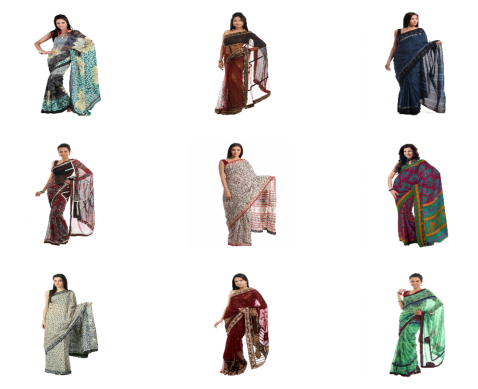

1/1 [==============================] - 0s 24ms/step


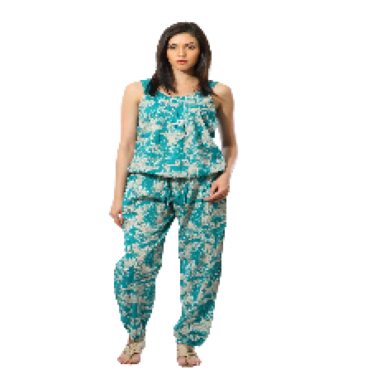

1/1 [==============================] - 0s 24ms/step


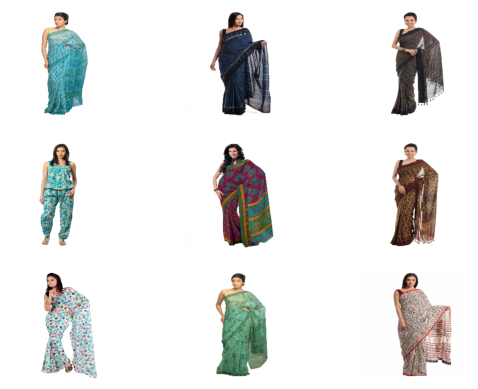

1/1 [==============================] - 0s 23ms/step


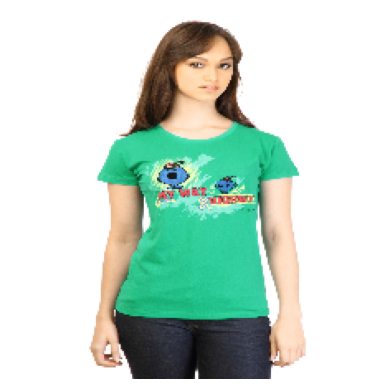

1/1 [==============================] - 0s 22ms/step


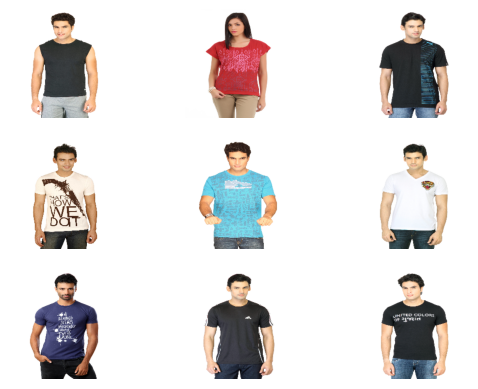

1/1 [==============================] - 0s 24ms/step


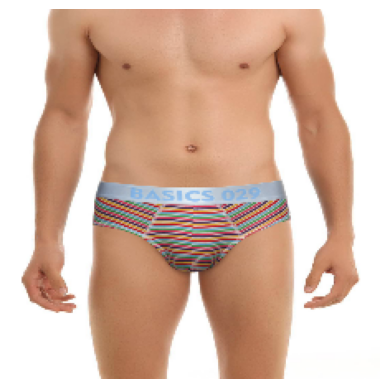

1/1 [==============================] - 0s 22ms/step


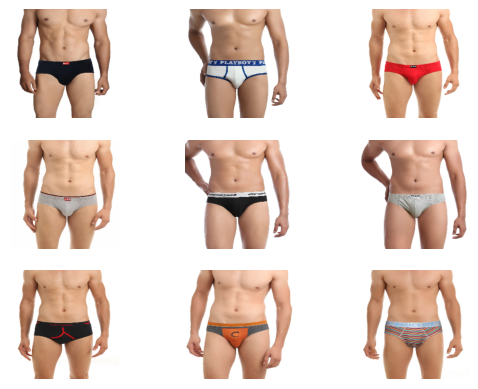

1/1 [==============================] - 0s 22ms/step


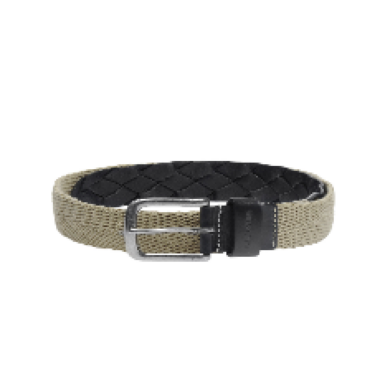

1/1 [==============================] - 0s 24ms/step


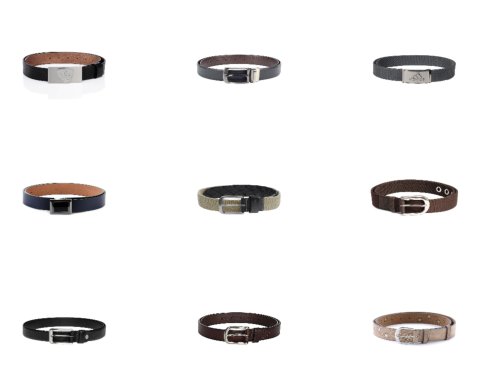

1/1 [==============================] - 0s 34ms/step


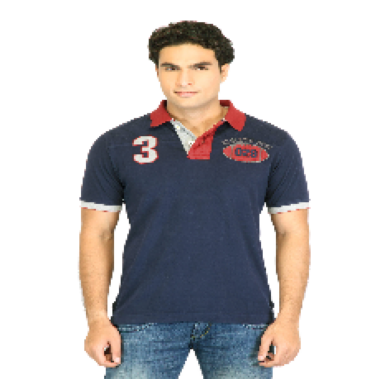

1/1 [==============================] - 0s 31ms/step


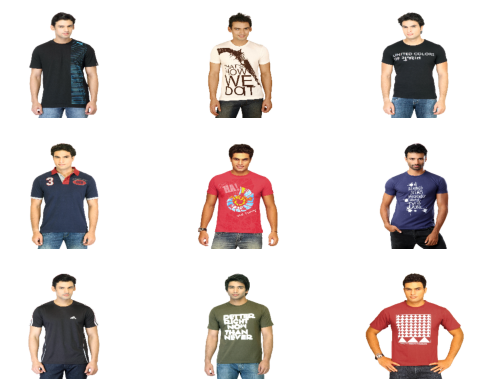

1/1 [==============================] - 0s 22ms/step


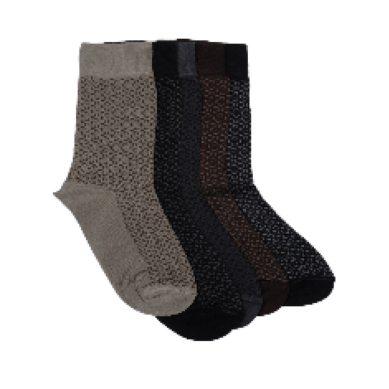

1/1 [==============================] - 0s 22ms/step


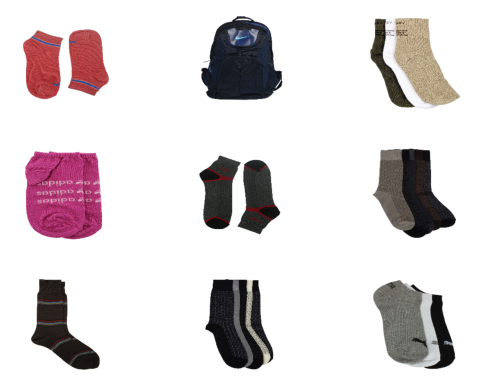

1/1 [==============================] - 0s 22ms/step


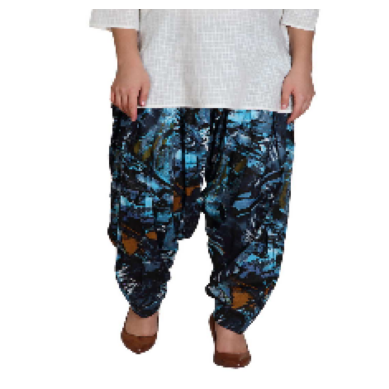

1/1 [==============================] - 0s 24ms/step


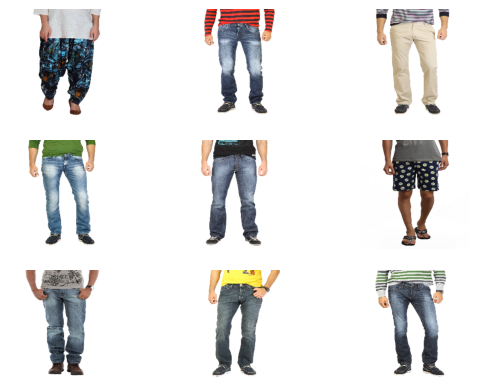

1/1 [==============================] - 0s 24ms/step


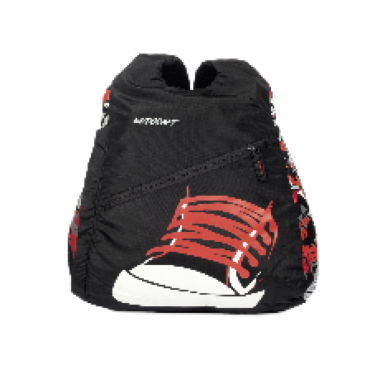

1/1 [==============================] - 0s 23ms/step


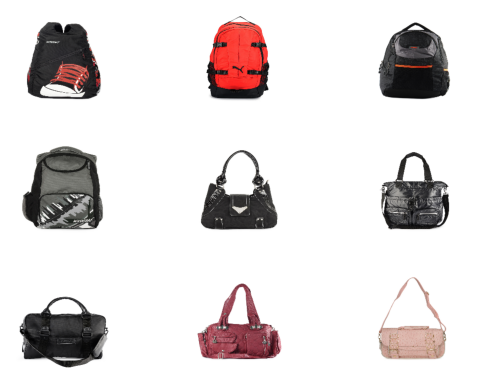

1/1 [==============================] - 0s 23ms/step


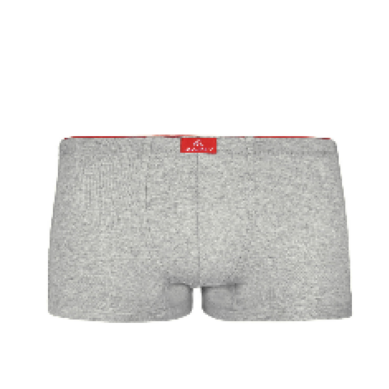

1/1 [==============================] - 0s 24ms/step


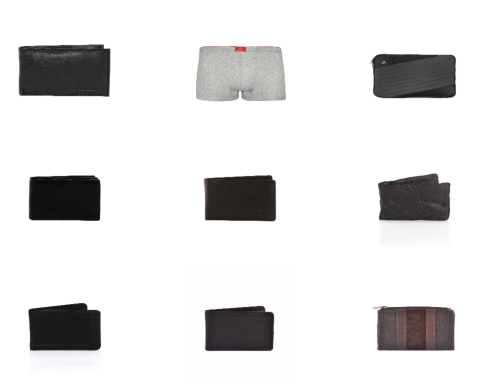

1/1 [==============================] - 0s 23ms/step


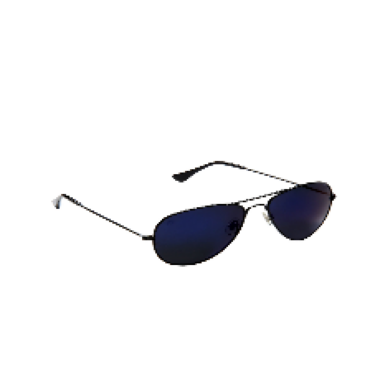

1/1 [==============================] - 0s 23ms/step


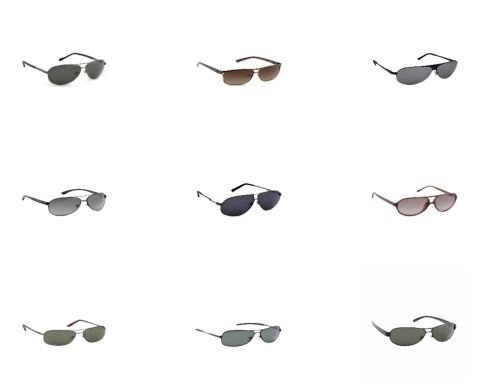

1/1 [==============================] - 0s 23ms/step


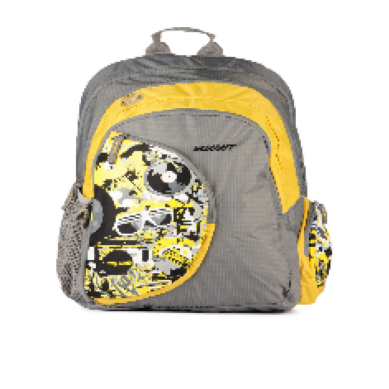

1/1 [==============================] - 0s 22ms/step


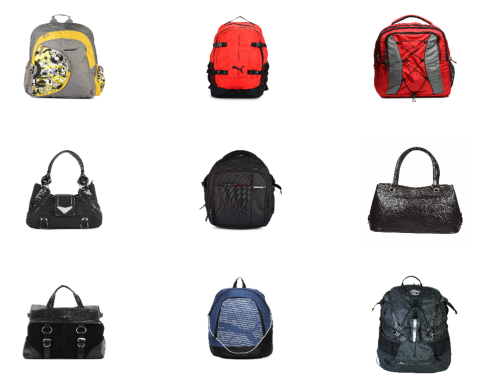

1/1 [==============================] - 0s 22ms/step


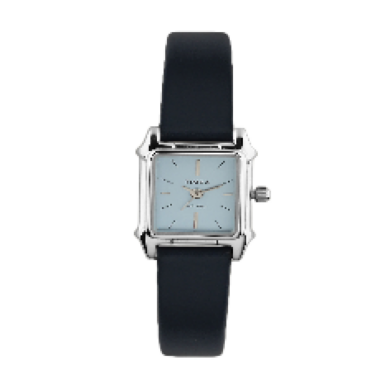

1/1 [==============================] - 0s 22ms/step


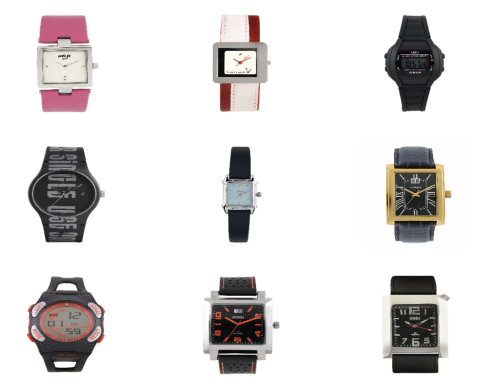

1/1 [==============================] - 0s 23ms/step


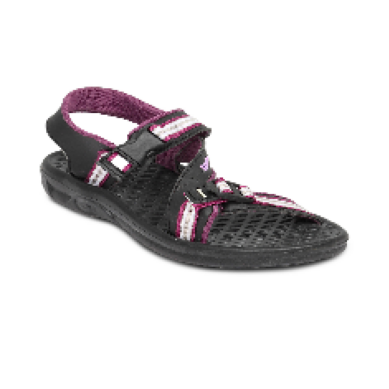

1/1 [==============================] - 0s 23ms/step


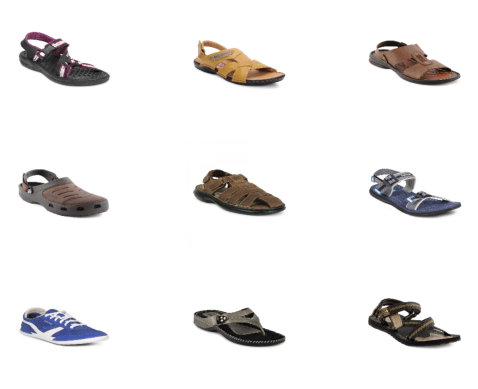

1/1 [==============================] - 0s 22ms/step


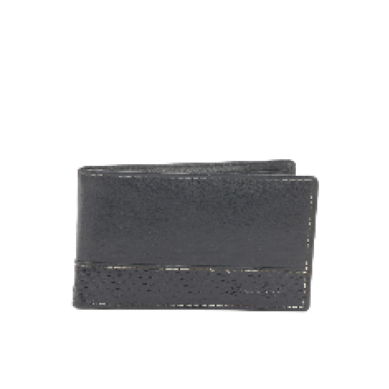

1/1 [==============================] - 0s 25ms/step


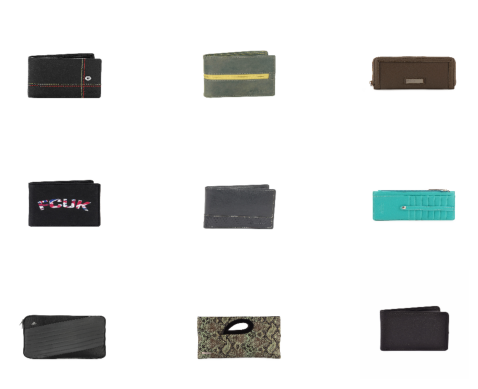

1/1 [==============================] - 0s 25ms/step


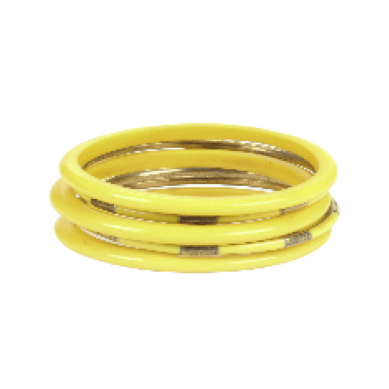

1/1 [==============================] - 0s 24ms/step


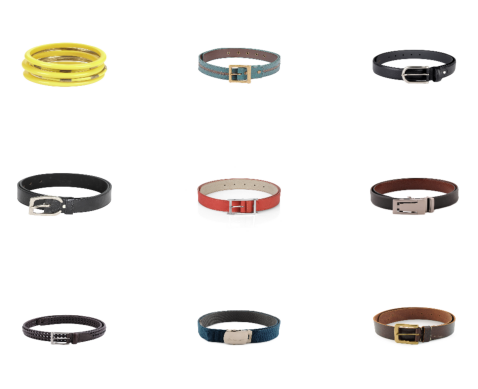

1/1 [==============================] - 0s 23ms/step


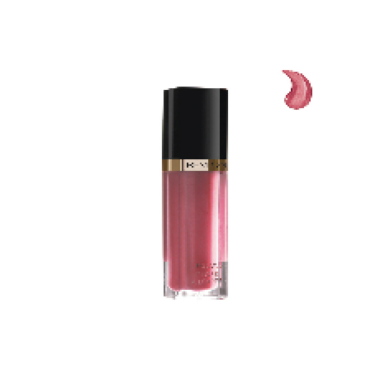

1/1 [==============================] - 0s 27ms/step


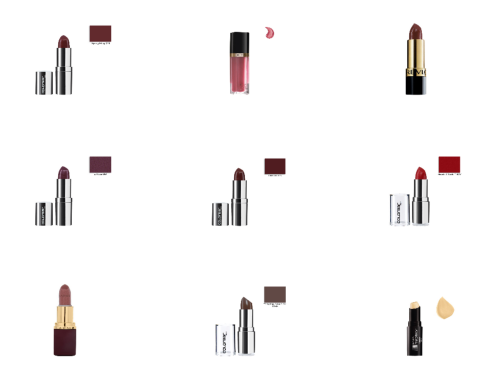

1/1 [==============================] - 0s 23ms/step


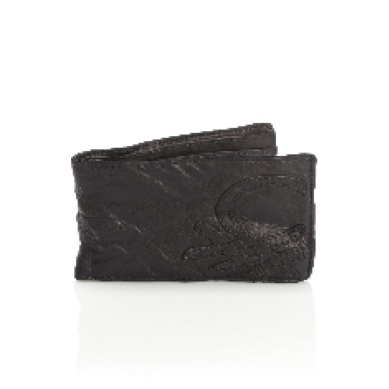

1/1 [==============================] - 0s 22ms/step


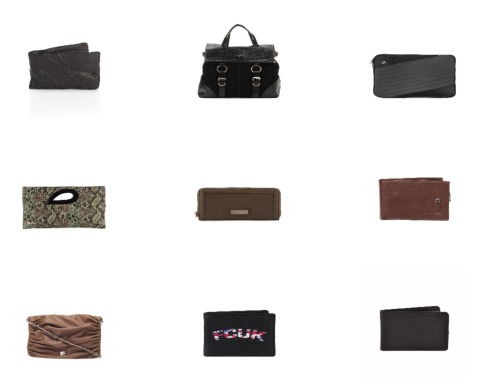

1/1 [==============================] - 0s 23ms/step


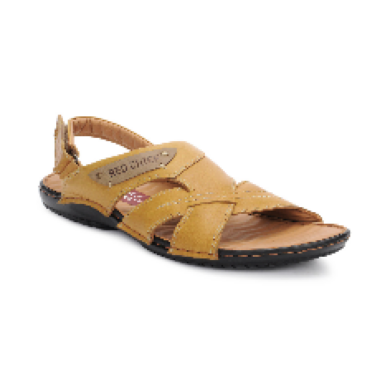

1/1 [==============================] - 0s 24ms/step


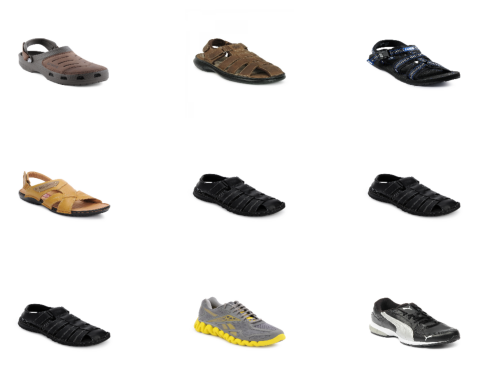

1/1 [==============================] - 0s 24ms/step


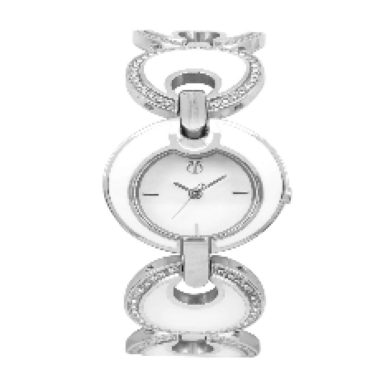

1/1 [==============================] - 0s 22ms/step


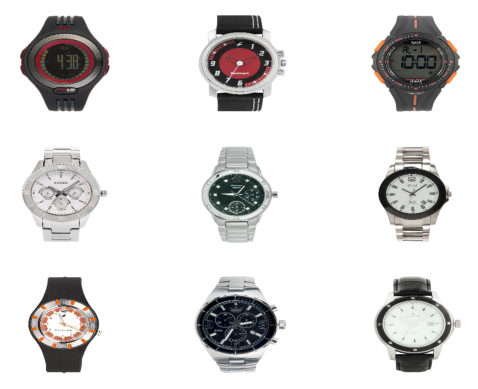

1/1 [==============================] - 0s 22ms/step


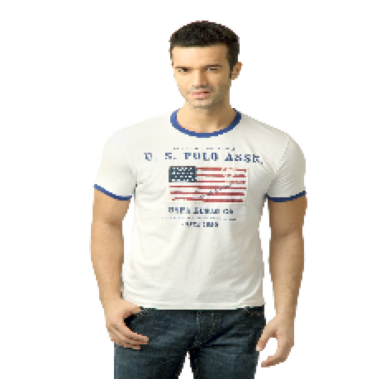

1/1 [==============================] - 0s 21ms/step


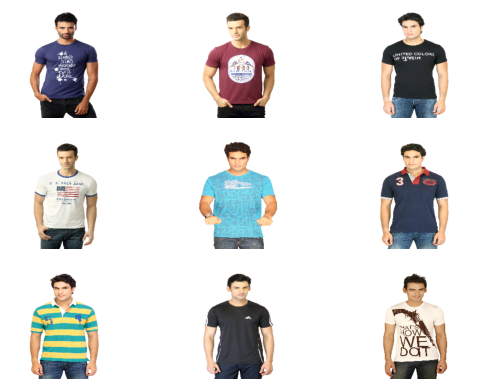

1/1 [==============================] - 0s 23ms/step


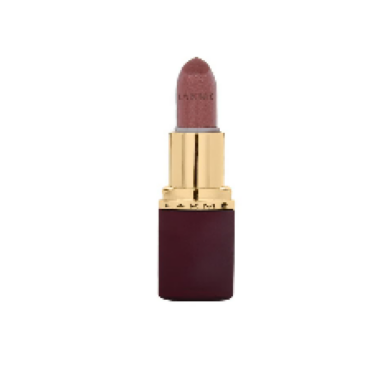

1/1 [==============================] - 0s 22ms/step


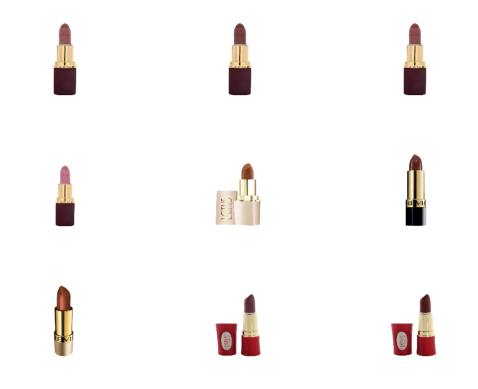

1/1 [==============================] - 0s 24ms/step


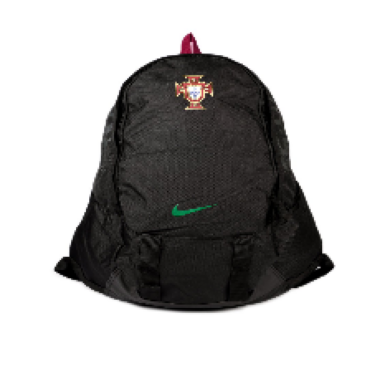

1/1 [==============================] - 0s 26ms/step


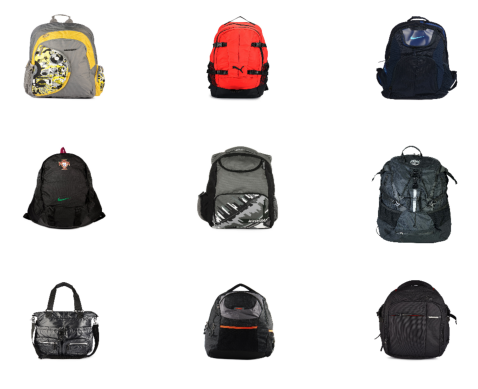

1/1 [==============================] - 0s 24ms/step


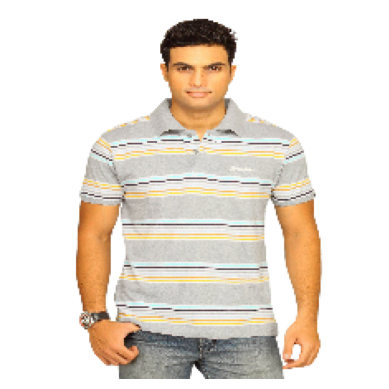

1/1 [==============================] - 0s 24ms/step


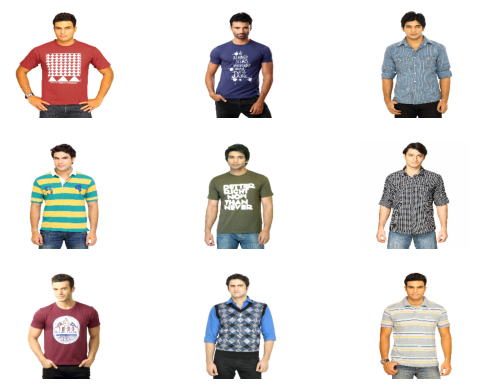

1/1 [==============================] - 0s 23ms/step


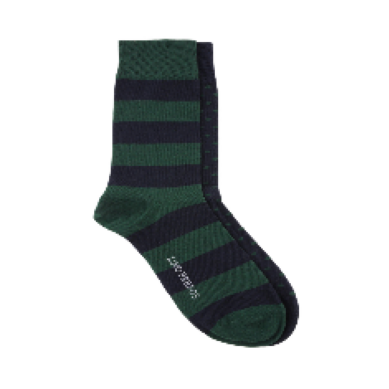

1/1 [==============================] - 0s 24ms/step


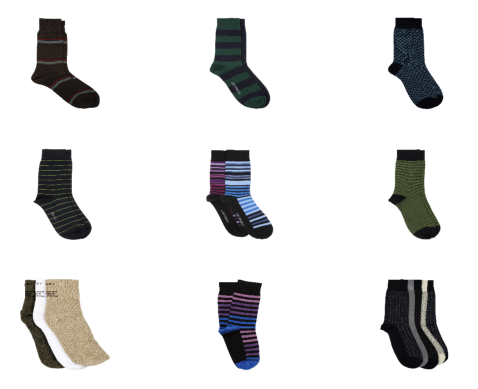

1/1 [==============================] - 0s 22ms/step


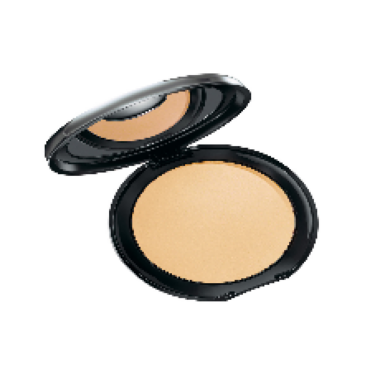

1/1 [==============================] - 0s 22ms/step


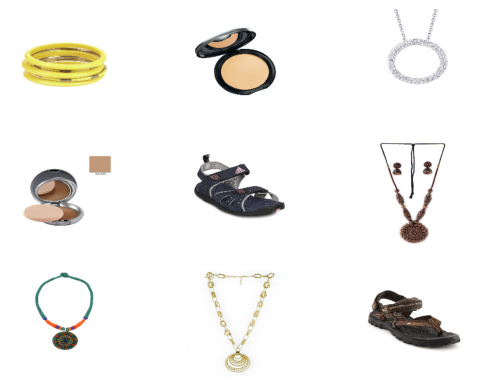

1/1 [==============================] - 0s 22ms/step


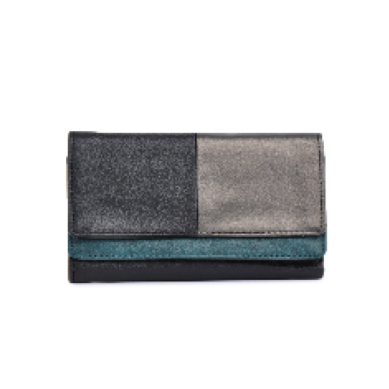

1/1 [==============================] - 0s 23ms/step


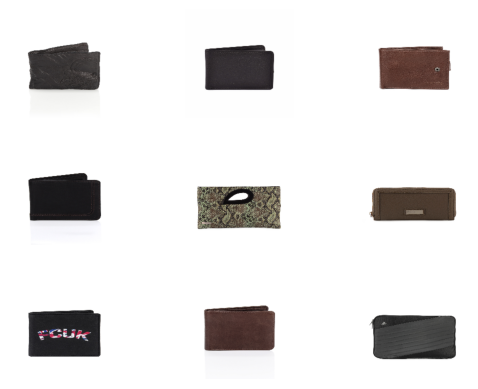

1/1 [==============================] - 0s 24ms/step


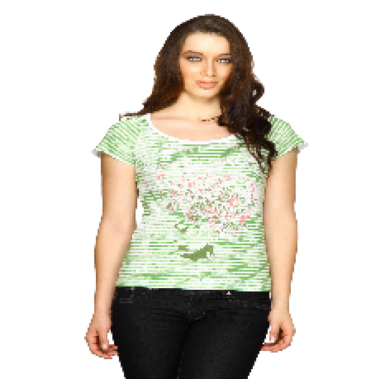

1/1 [==============================] - 0s 22ms/step


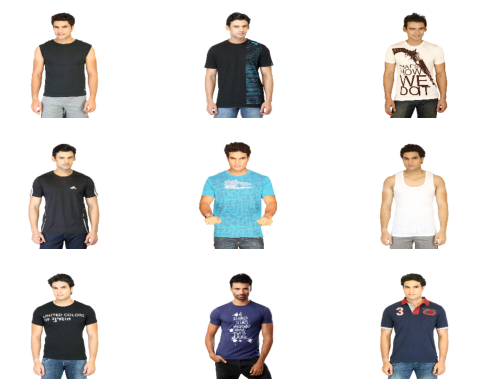

1/1 [==============================] - 0s 24ms/step


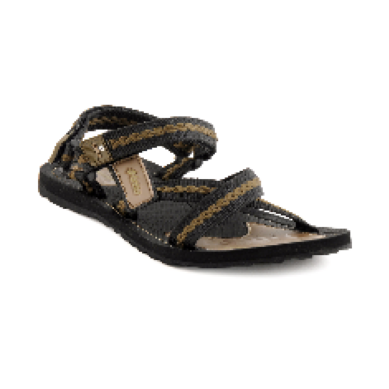

1/1 [==============================] - 0s 22ms/step


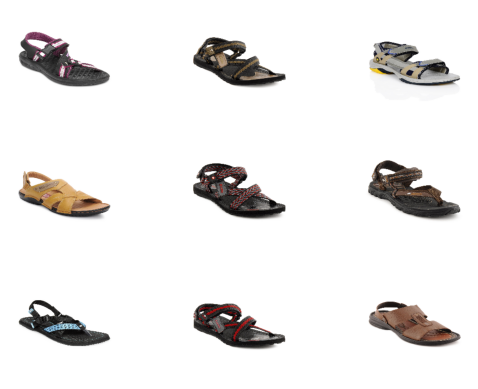

1/1 [==============================] - 0s 22ms/step


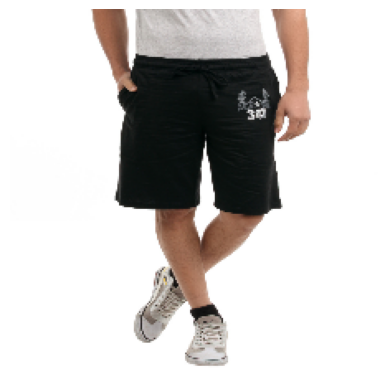

1/1 [==============================] - 0s 25ms/step


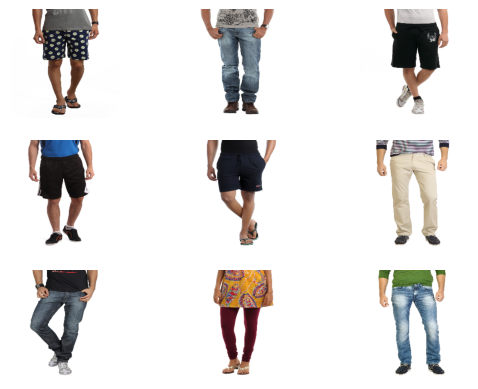

1/1 [==============================] - 0s 25ms/step


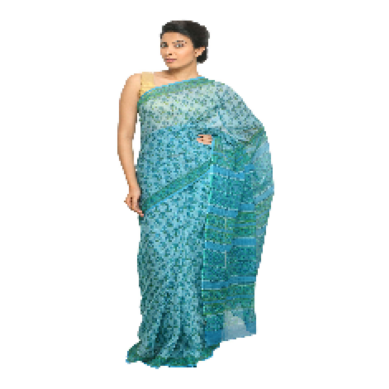

1/1 [==============================] - 0s 26ms/step


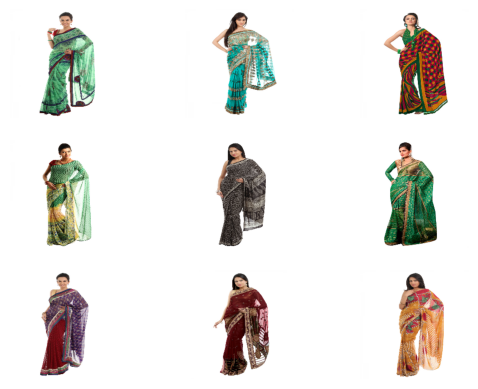

1/1 [==============================] - 0s 26ms/step


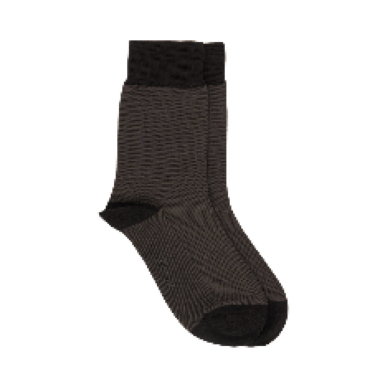

1/1 [==============================] - 0s 24ms/step


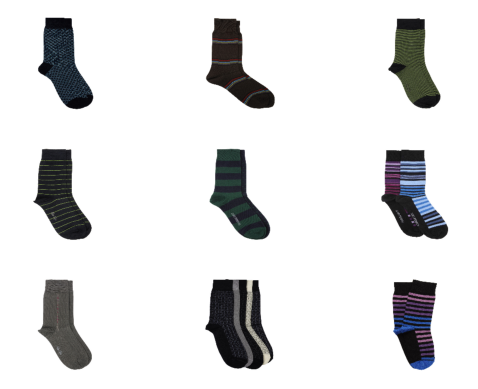

1/1 [==============================] - 0s 42ms/step


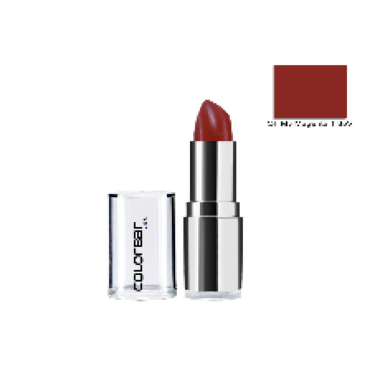

1/1 [==============================] - 0s 23ms/step


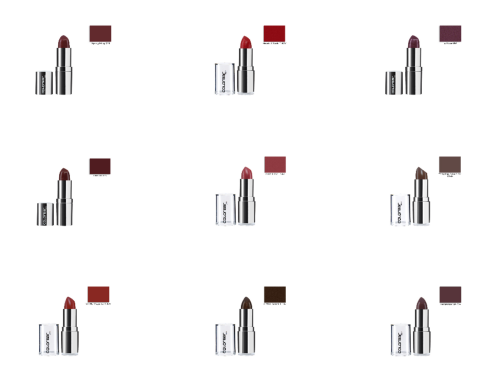

1/1 [==============================] - 0s 33ms/step


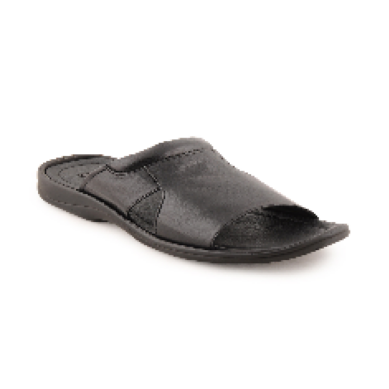

1/1 [==============================] - 0s 35ms/step


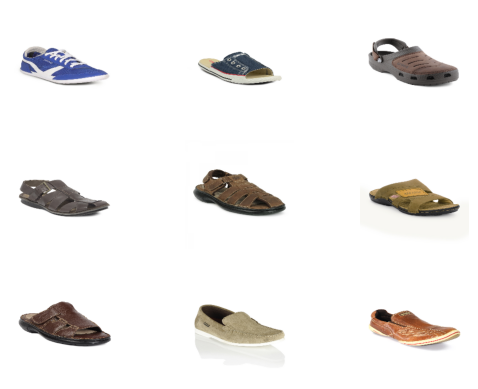

1/1 [==============================] - 0s 23ms/step


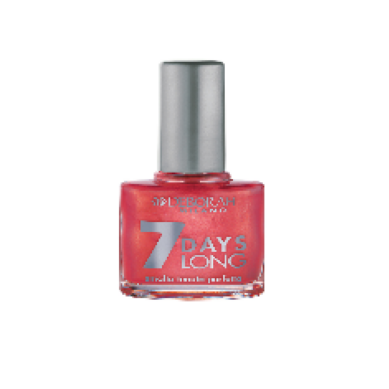

1/1 [==============================] - 0s 23ms/step


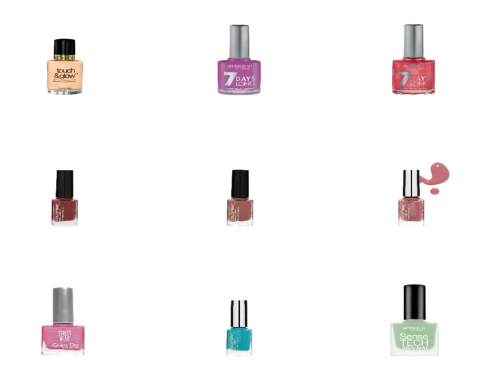

1/1 [==============================] - 0s 22ms/step


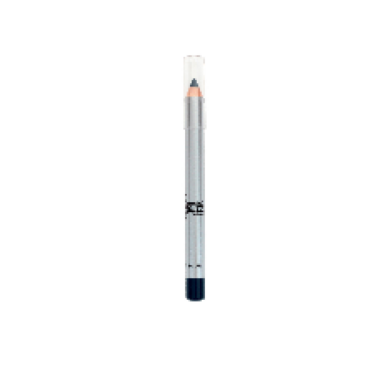

1/1 [==============================] - 0s 22ms/step


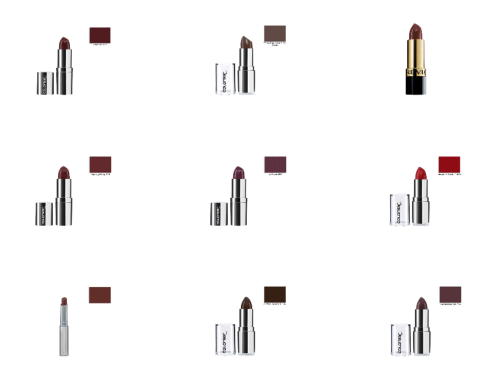

1/1 [==============================] - 0s 22ms/step


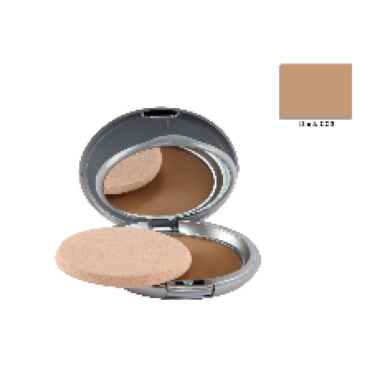

1/1 [==============================] - 0s 25ms/step


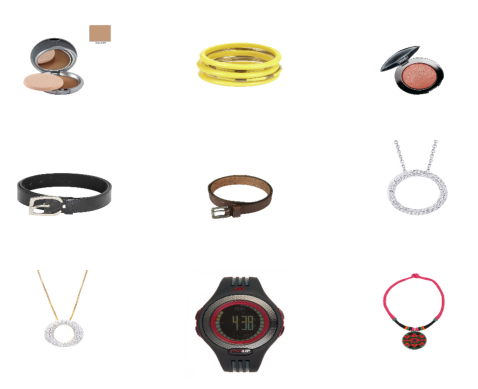

1/1 [==============================] - 0s 23ms/step


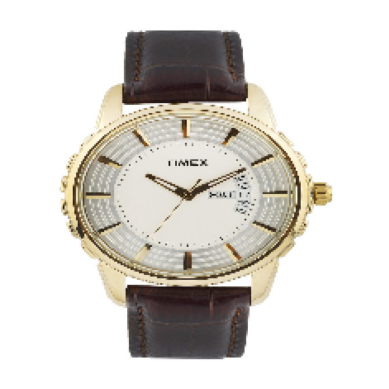

1/1 [==============================] - 0s 23ms/step


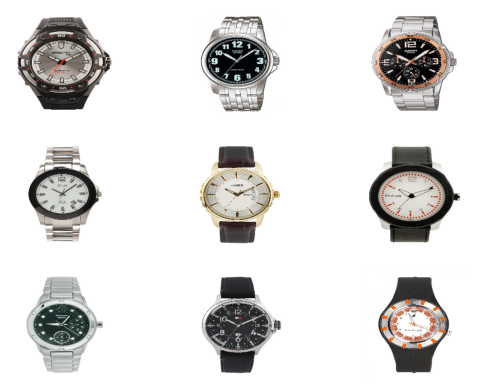

1/1 [==============================] - 0s 23ms/step


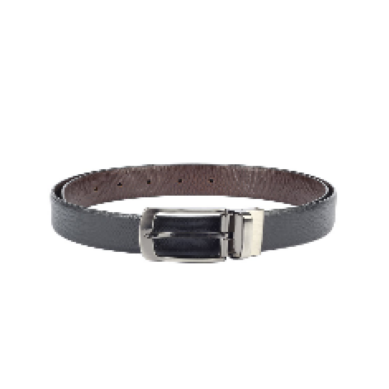

1/1 [==============================] - 0s 23ms/step


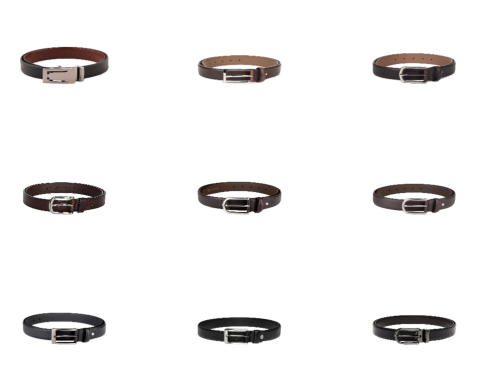

1/1 [==============================] - 0s 23ms/step


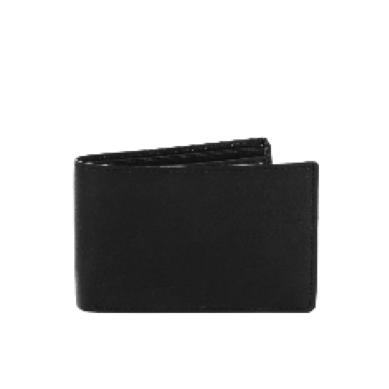

1/1 [==============================] - 0s 25ms/step


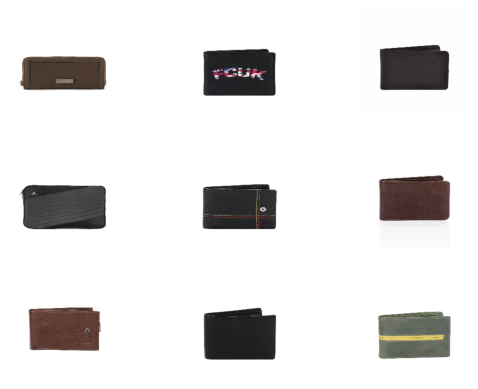

1/1 [==============================] - 0s 22ms/step


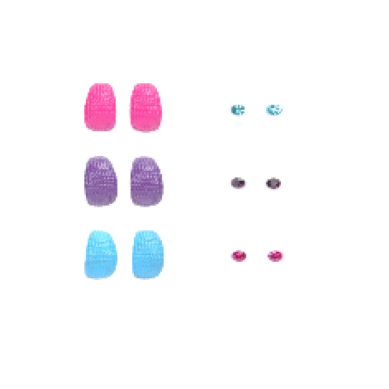

1/1 [==============================] - 0s 23ms/step


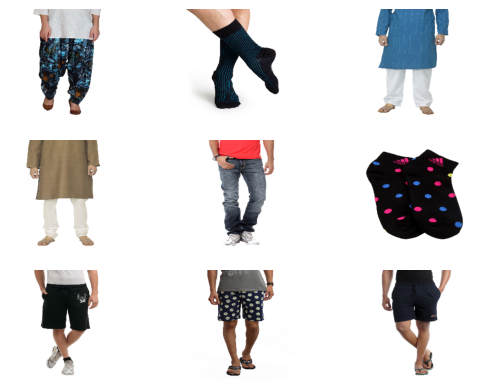

1/1 [==============================] - 0s 22ms/step


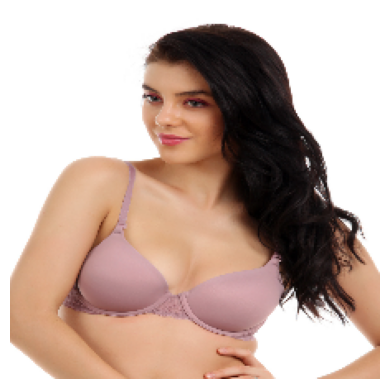

1/1 [==============================] - 0s 23ms/step


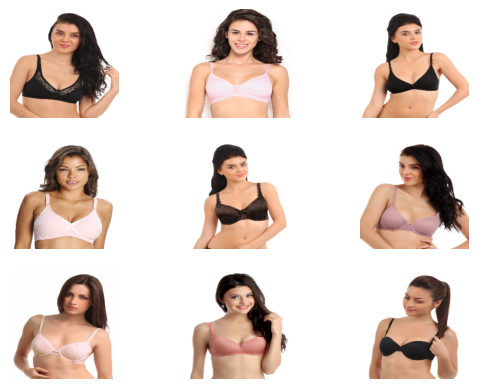

1/1 [==============================] - 0s 22ms/step


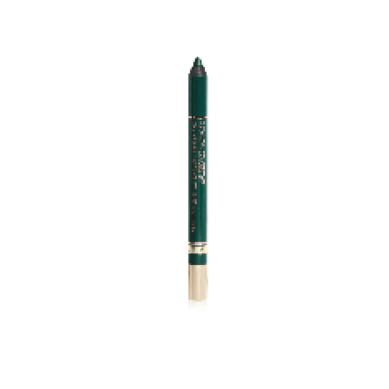

1/1 [==============================] - 0s 24ms/step


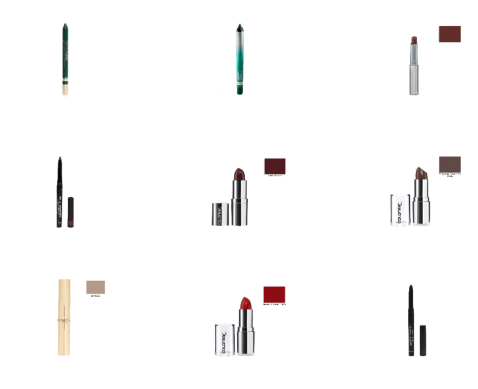

1/1 [==============================] - 0s 22ms/step


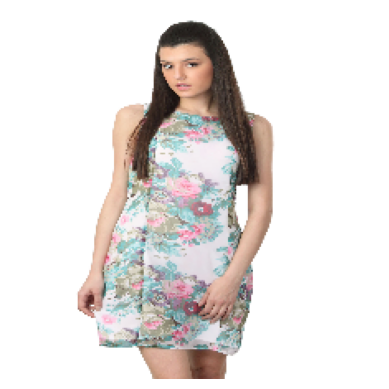

1/1 [==============================] - 0s 25ms/step


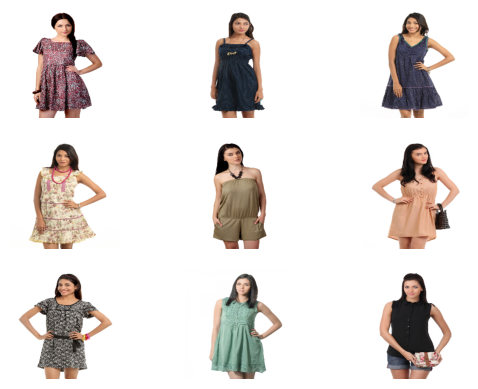

1/1 [==============================] - 0s 46ms/step


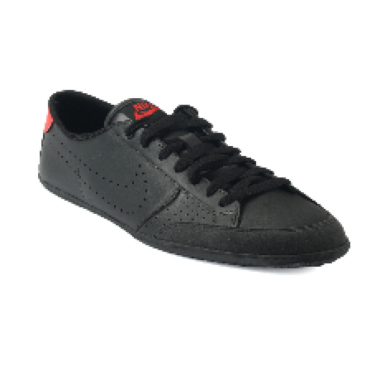

1/1 [==============================] - 0s 24ms/step


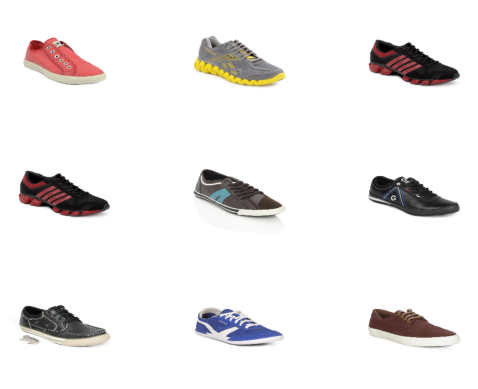

1/1 [==============================] - 0s 23ms/step


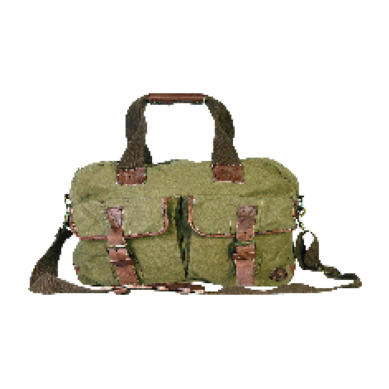

1/1 [==============================] - 0s 22ms/step


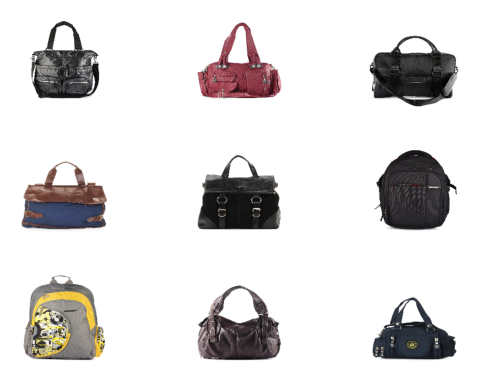

1/1 [==============================] - 0s 23ms/step


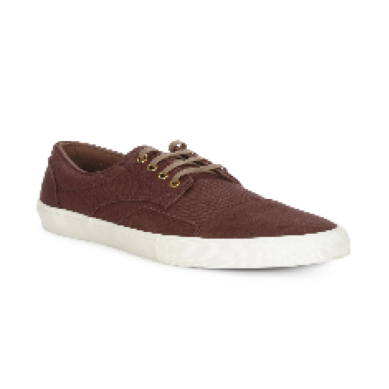

1/1 [==============================] - 0s 24ms/step


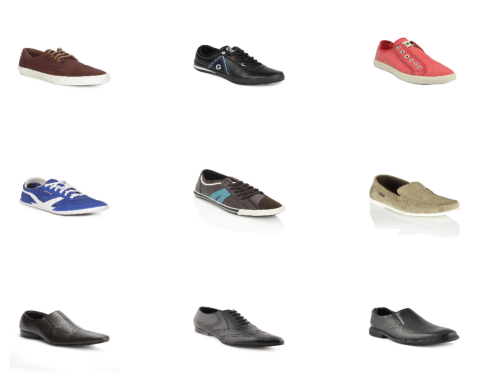

1/1 [==============================] - 0s 22ms/step


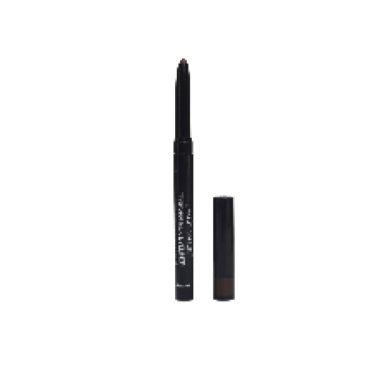

1/1 [==============================] - 0s 25ms/step


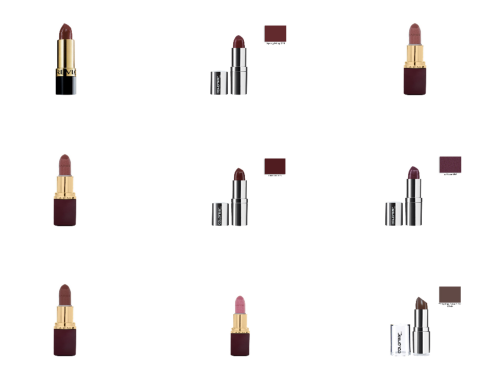

1/1 [==============================] - 0s 22ms/step


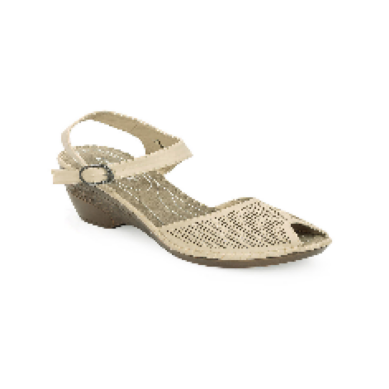

1/1 [==============================] - 0s 22ms/step


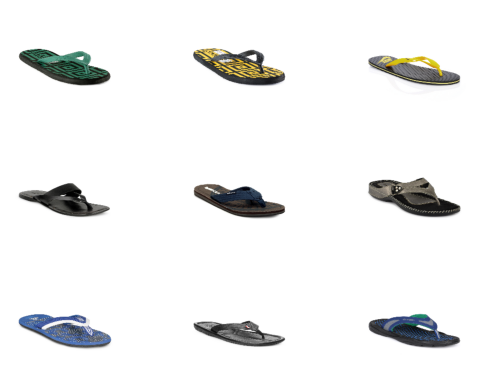

1/1 [==============================] - 0s 23ms/step


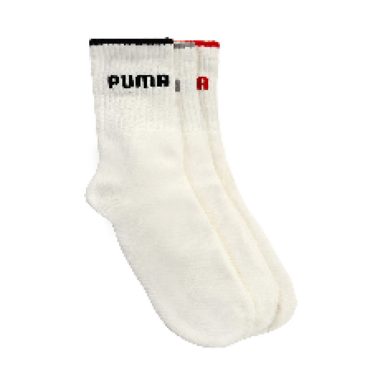

1/1 [==============================] - 0s 21ms/step


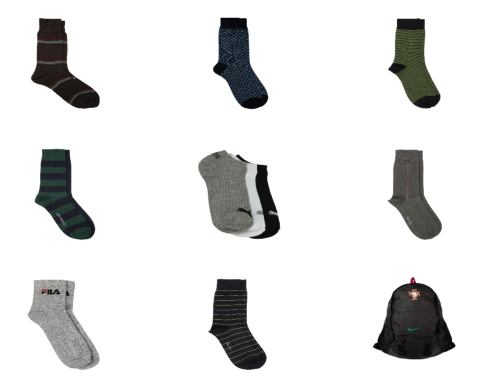

1/1 [==============================] - 0s 22ms/step


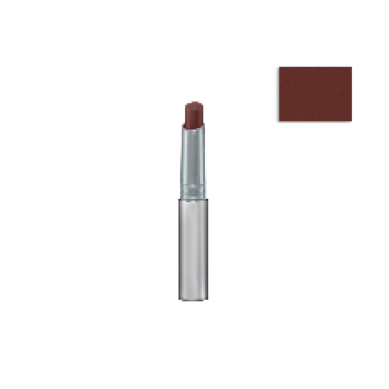

1/1 [==============================] - 0s 25ms/step


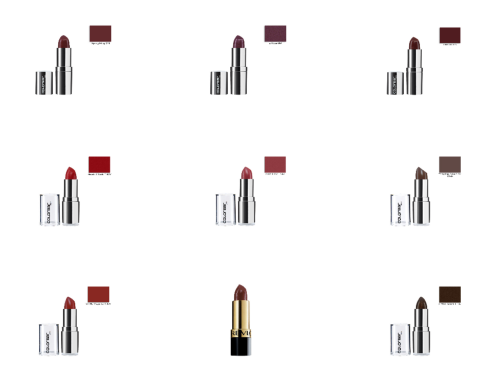

1/1 [==============================] - 0s 23ms/step


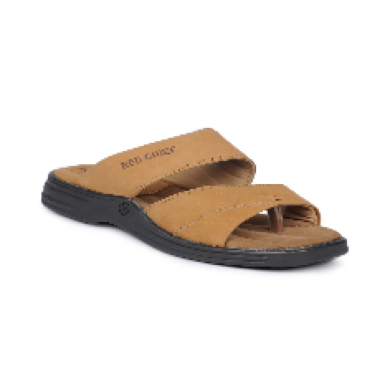

1/1 [==============================] - 0s 23ms/step


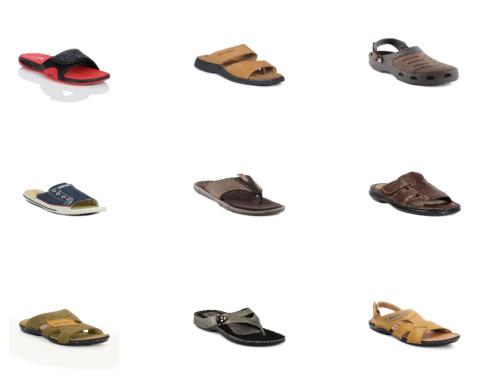

1/1 [==============================] - 0s 23ms/step


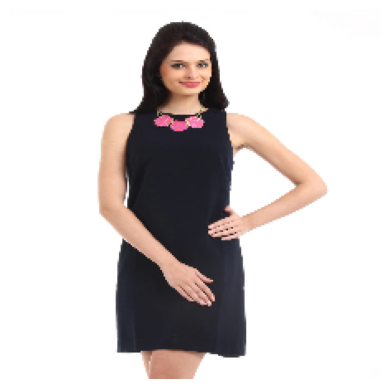

1/1 [==============================] - 0s 24ms/step


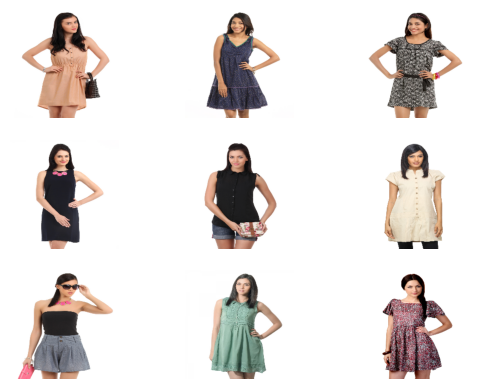

1/1 [==============================] - 0s 22ms/step


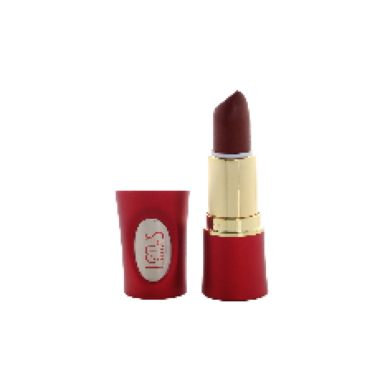

1/1 [==============================] - 0s 23ms/step


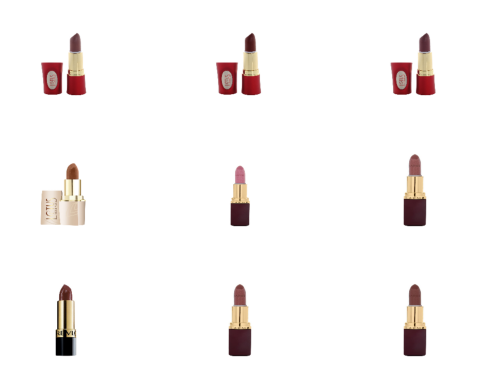

1/1 [==============================] - 0s 22ms/step


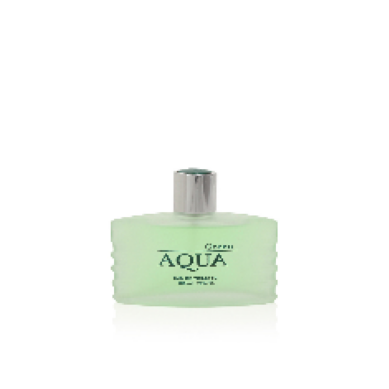

1/1 [==============================] - 0s 23ms/step


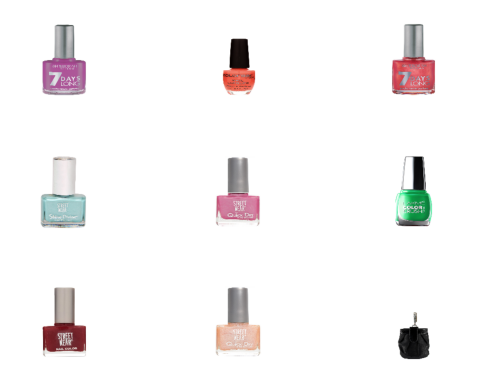

1/1 [==============================] - 0s 25ms/step


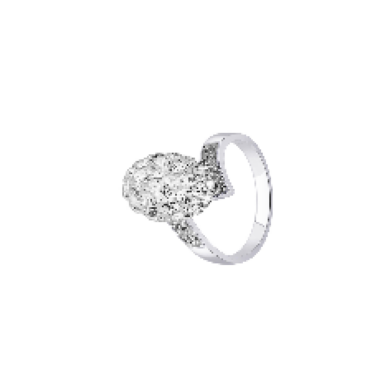

1/1 [==============================] - 0s 23ms/step


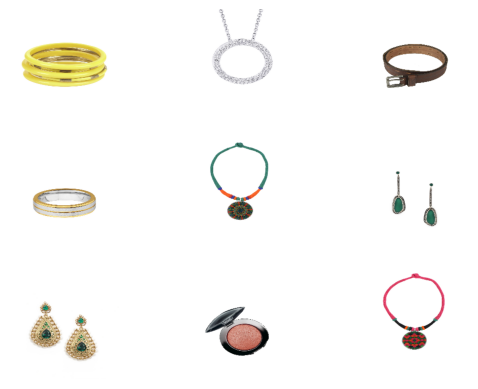

1/1 [==============================] - 0s 22ms/step


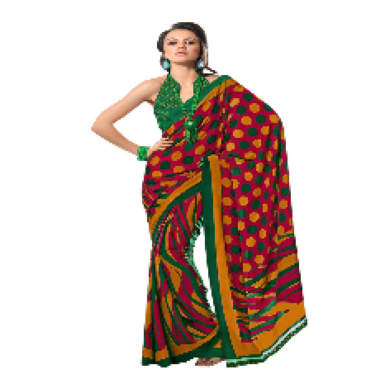

1/1 [==============================] - 0s 23ms/step


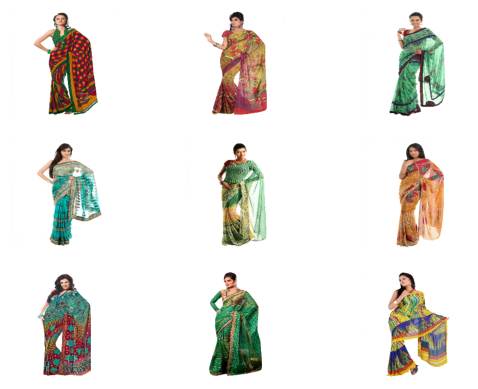

1/1 [==============================] - 0s 24ms/step


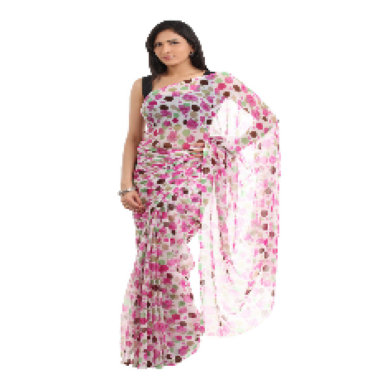

1/1 [==============================] - 0s 24ms/step


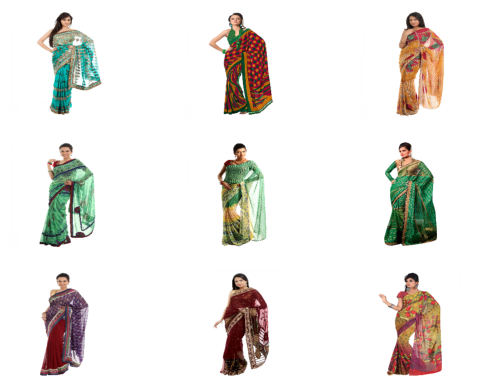

1/1 [==============================] - 0s 27ms/step


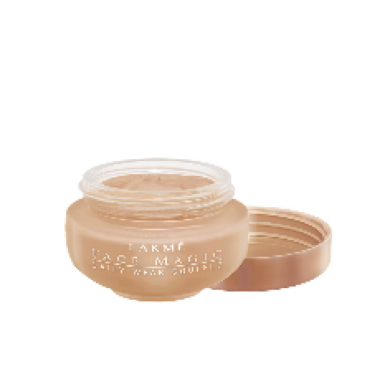

1/1 [==============================] - 0s 28ms/step


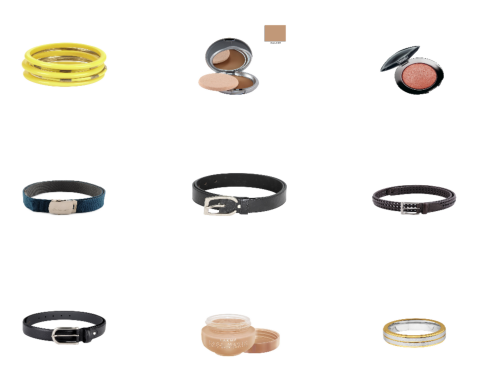

1/1 [==============================] - 0s 24ms/step


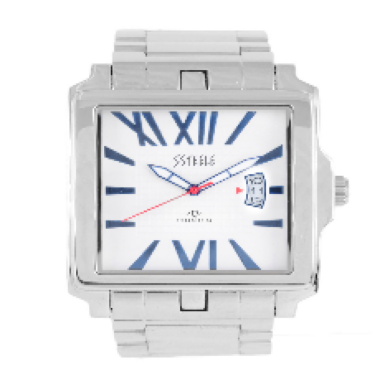

1/1 [==============================] - 0s 25ms/step


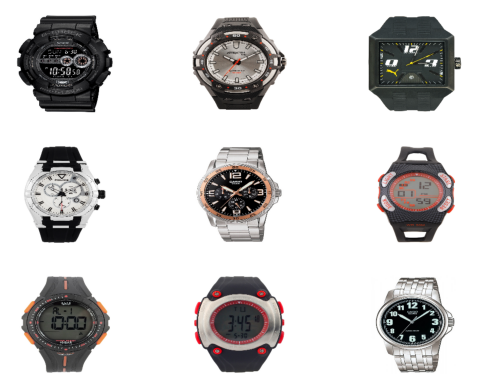

1/1 [==============================] - 0s 23ms/step


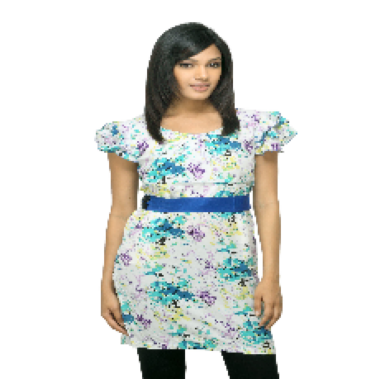

1/1 [==============================] - 0s 25ms/step


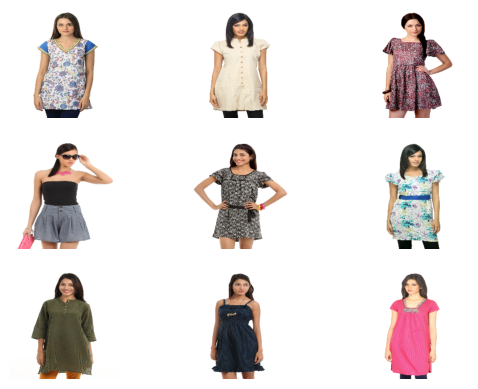

1/1 [==============================] - 0s 23ms/step


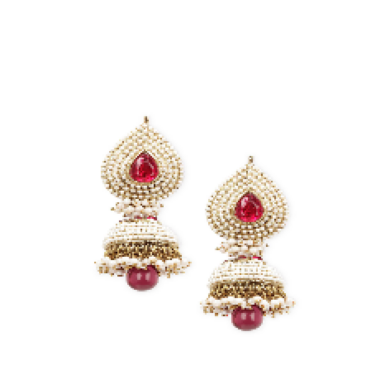

1/1 [==============================] - 0s 22ms/step


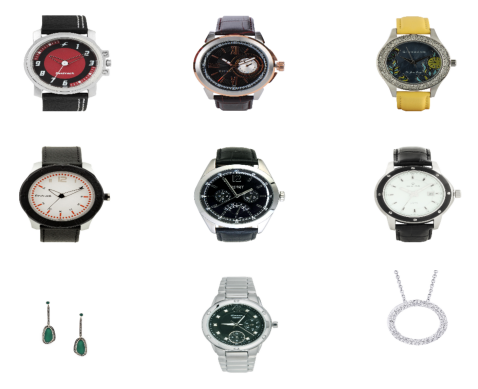

1/1 [==============================] - 0s 23ms/step


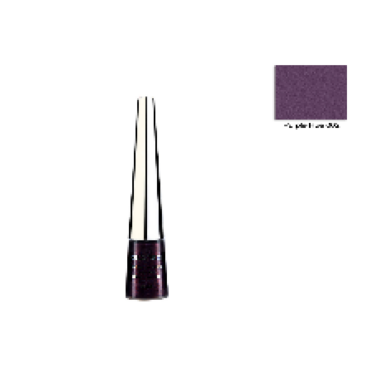

1/1 [==============================] - 0s 25ms/step


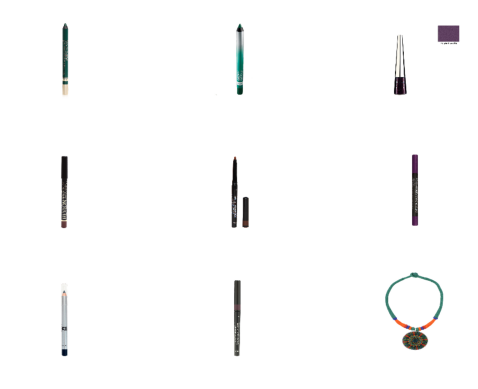

1/1 [==============================] - 0s 44ms/step


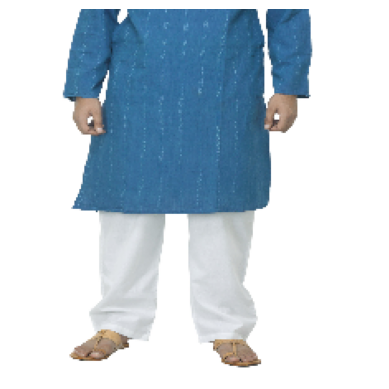

1/1 [==============================] - 0s 41ms/step


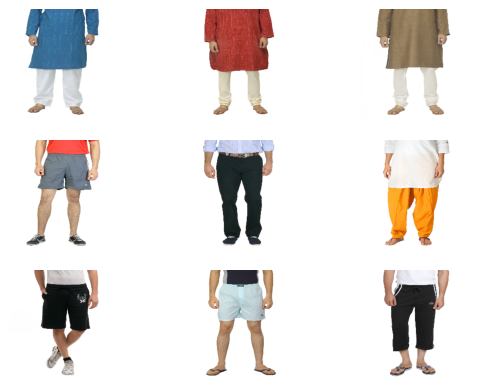

1/1 [==============================] - 0s 24ms/step


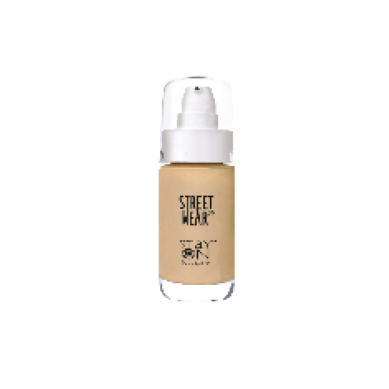

1/1 [==============================] - 0s 23ms/step


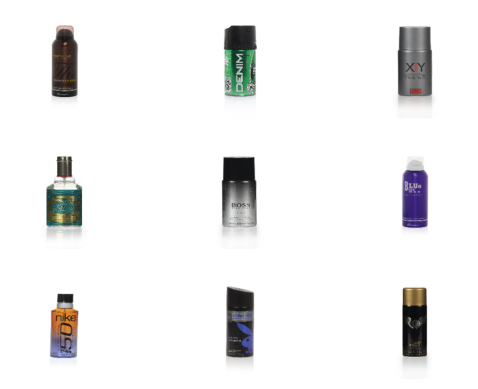

1/1 [==============================] - 0s 24ms/step


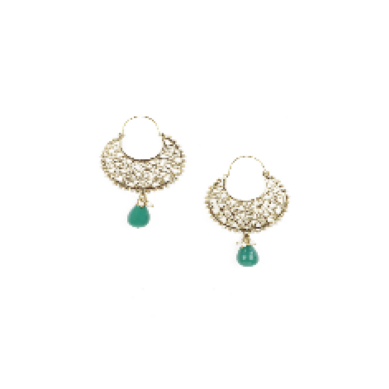

1/1 [==============================] - 0s 25ms/step


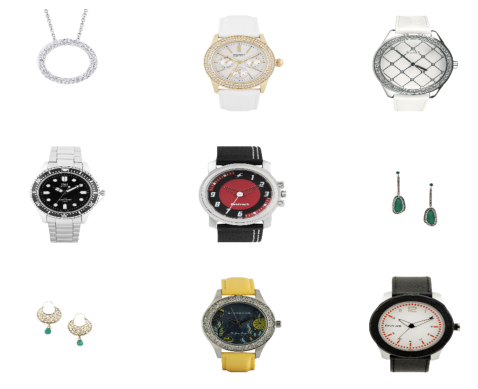

1/1 [==============================] - 0s 25ms/step


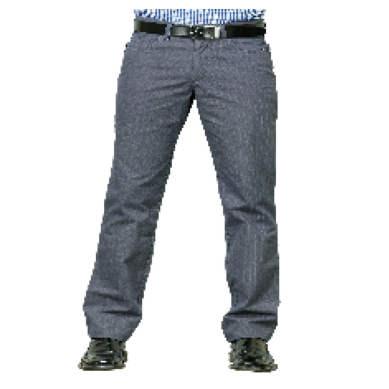

1/1 [==============================] - 0s 24ms/step


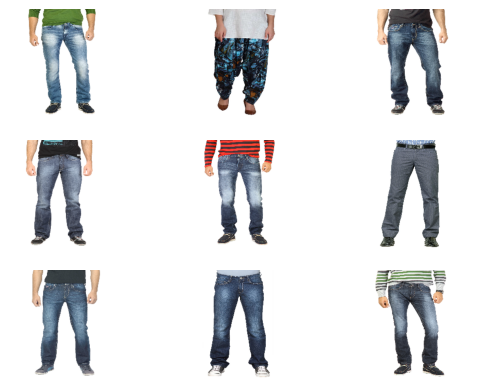

1/1 [==============================] - 0s 24ms/step


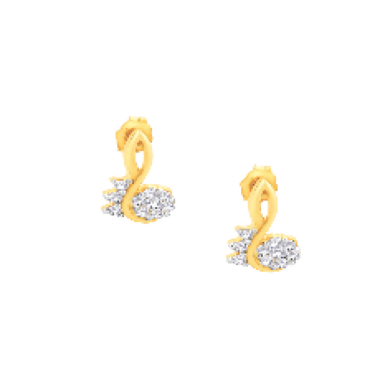

1/1 [==============================] - 0s 23ms/step


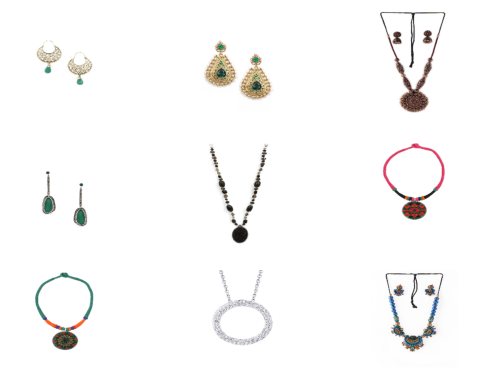

1/1 [==============================] - 0s 23ms/step


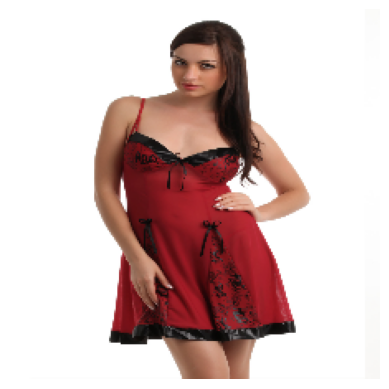

1/1 [==============================] - 0s 24ms/step


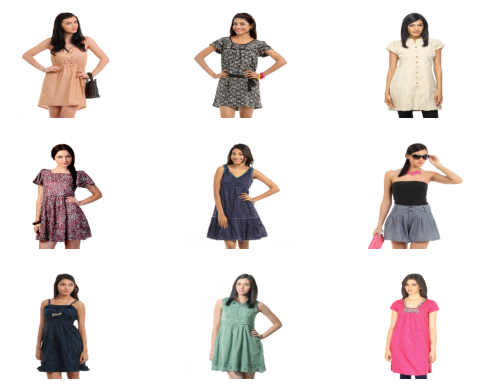

1/1 [==============================] - 0s 22ms/step


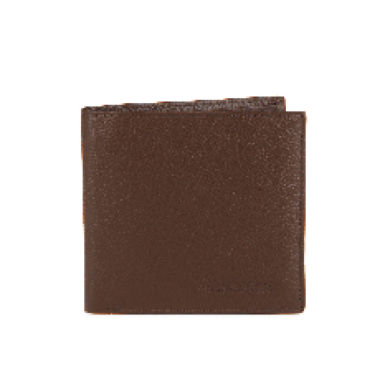

1/1 [==============================] - 0s 23ms/step


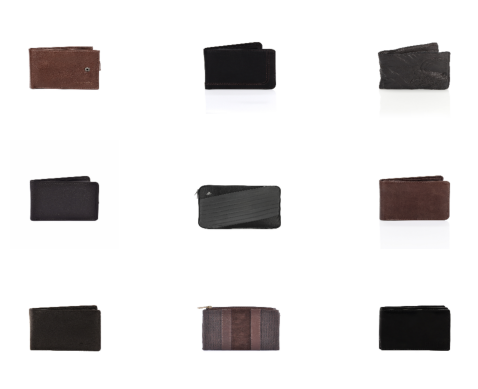

In [50]:
list_path = []
for i in np.concatenate(ids):
    list_path.append('/kaggle/input/fashion-product-images-dataset/fashion-dataset/images/'+ str(i) +'.jpg')
    
    
list_path = {item for item in list_path}
calculate_MAP(list_path, list_labels, 9)

In [51]:
test_df[['id','hashcode']]

,id,hashcode
0,56049,"[-1, 1, -1, 1, 1, -1, -1, -1, -1, -1, -1, 1, -..."
1,41681,"[-1, 1, -1, 1, -1, 1, -1, 1, -1, 1, -1, 1, -1,..."
2,43513,"[1, -1, -1, 1, 1, -1, 1, 1, 1, -1, -1, 1, -1, ..."
3,30576,"[-1, -1, -1, 1, -1, -1, 1, 1, -1, 1, 1, -1, -1..."
4,8444,"[-1, -1, -1, 1, 1, -1, 1, 1, 1, -1, -1, 1, -1,..."
...,...,...
1359,27425,"[1, 1, 1, 1, 1, -1, -1, 1, 1, -1, -1, 1, -1, 1..."
1360,44198,"[1, -1, -1, 1, -1, 1, -1, 1, -1, 1, -1, -1, 1,..."
1361,29223,"[1, 1, -1, 1, 1, -1, -1, 1, -1, -1, -1, 1, -1,..."
1362,55905,"[1, 1, -1, 1, 1, -1, 1, -1, -1, -1, 1, 1, -1, ..."
